<a href="https://colab.research.google.com/github/Yuhan0524/TDAforcell/blob/main/Whole_Pipeline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install giotto-tda

In [ ]:
import numpy as np
class Real_Distance:
  def real_euclidean_distance(point1, point2):
      return np.sqrt((point1[0] - point2[0])**2 + (point1[1] - point2[1])**2)
  def calculate_distance_matrix(point_cloud):
      num_points = len(point_cloud)
      distance_matrix = np.zeros((num_points, num_points))

      for i in range(num_points):
          for j in range(i + 1, num_points):
              distance = Real_Distance.real_euclidean_distance(point_cloud[i][:2], point_cloud[j][:2])
              distance_matrix[i, j] = distance
              distance_matrix[j, i] = distance

      return distance_matrix

class Find_Pairs:
    @staticmethod
    def find_pairs_within_epsilon(distance_matrix, epsilon):
        num_points = distance_matrix.shape[0]
        indices = np.arange(num_points)
        labels_dict = {}

        for i in range(num_points):
            mask = distance_matrix[i, i+1:] <= epsilon
            labels = indices[i+1:][mask].tolist()
            if labels:
                labels_dict[i] = labels

        return labels_dict

from sklearn.metrics.pairwise import cosine_distances,manhattan_distances
class Get_Weight:
    @staticmethod
    def calculate_distances(point_cloud):
        num_points = len(point_cloud)
        distances = np.zeros((num_points, num_points))

        for i in range(num_points):
            for j in range(i + 1, num_points):
                distance = np.linalg.norm(np.array(point_cloud[i]) - np.array(point_cloud[j]))
                distances[i, j] = distance
                distances[j, i] = distance
        return distances

    def rescale_distances(point_cloud):
        distance_matrix = Get_Weight.calculate_distances(point_cloud)
        max_distance = np.max(distance_matrix)
        rescaled_matrix = max_distance - distance_matrix
        #rescaled_matrix /= max_distance
        for i in range(len(point_cloud)):
          rescaled_matrix[i][i]=0
        return rescaled_matrix
    def Man_distances(point_cloud):
        a = manhattan_distances(point_cloud)
        rescaled_matrix = np.max(a) - a
        return rescaled_matrix

    def cos_distances(point_cloud):
        a = cosine_distances(point_cloud)
        rescaled_matrix = np.max(a) - a
        return rescaled_matrix

class Graph:
    @staticmethod
    def generate_adjacency_matrix(connected_nodes, distance_matrix):
        num_nodes = len(distance_matrix)
        adjacency_matrix = np.full((num_nodes, num_nodes), np.inf)

        for node, connected in connected_nodes.items():
            adjacency_matrix[node, connected] = distance_matrix[node, connected]
            adjacency_matrix[connected, node] = distance_matrix[node, connected]

        np.fill_diagonal(adjacency_matrix, 0)
        return adjacency_matrix

from gtda.homology import VietorisRipsPersistence
from gtda.plotting import plot_diagram
class TDA:
    @staticmethod
    def PH(data):
        VR = VietorisRipsPersistence(metric="precomputed",)
        diagrams = VR.fit_transform(data)
        return diagrams

    @staticmethod
    def plot_graph(diagrams):
        return plot_diagram(diagrams[0])

import numpy as np

def calculate_percentile(data, x):
    n = len(data)
    position = (x / 100) * n
    if position.is_integer():
        percentile_value = data[int(position) - 1]
    else:
        lower_pos = int(np.floor(position))
        upper_pos = int(np.ceil(position))
        lower_value = data[lower_pos - 1]
        upper_value = data[upper_pos - 1]
        percentile_value = lower_value + (position - lower_pos) * (upper_value - lower_value)

    return percentile_value

In [ ]:
import pandas as pd
import numpy as np
import csv

data_1 = pd.read_csv("/content/drive/MyDrive/GIS/Breast Cancer Sim/cell_table_size_normalized.csv")
unique_rois = data_1['fov'].unique()

In [ ]:
data1 = data_1[data_1['fov'] == 'Point2203']
overlapping_markers = data1.columns[[1] + list(range(6, 22))+list(range(23, 37))+list(range(39, 47))]
print(overlapping_markers)

In [ ]:
import pandas as pd
import numpy as np
import csv

#data_1 = pd.read_csv("/content/drive/MyDrive/GIS/infected lung.csv")
percentile_values = []

for roi in unique_rois:
    data1 = data_1[data_1['fov'] == roi]
    X1_coor = data1[["centroid-0", "centroid-1"]].values
    overlapping_markers = data1.columns[[1] + list(range(6, 22))+list(range(23, 37))+list(range(39, 47))]
    Y1 = data1[overlapping_markers].values

    # Calculate your distance_matrix and dissimilarity_matrix here

    csv_file = f'/content/drive/MyDrive/GIS/Breast Cancer Diss_new/{roi}_Diss_Selected.csv'
    columns = ['birth', 'death', 'dimension', 'label']

    distance_matrix = Real_Distance.calculate_distance_matrix(X1_coor)
    dissimilarity_matrix = Get_Weight.rescale_distances(Y1)

    with open(csv_file, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(columns)
        for n in range(1):
            labels_within_epsilon = Find_Pairs.find_pairs_within_epsilon(distance_matrix, 200)
            X = []
            connected_nodes = labels_within_epsilon
            dissimilarity_matrix = np.array(dissimilarity_matrix)
            adjacency_matrix = Graph.generate_adjacency_matrix(connected_nodes, dissimilarity_matrix)
            result = TDA.PH([np.array(adjacency_matrix)])
            for i in result[0].tolist():
                X.append(i)
            for row in X:
                writer.writerow(row + [n])

    # Calculate the percentile value
    result_1 = pd.read_csv(f'/content/drive/MyDrive/GIS/Breast Cancer Diss_new/{roi}_Diss_Selected.csv')
    result_selected_1 = result_1[result_1['label'] == 0]
    result_selected = result_selected_1[result_selected_1['dimension'] == 1]
    birth_time = result_selected['birth'].values

    # Calculate the desired percentile (e.g., 75th percentile)
    percentile_value_75, percentile_value_50 = calculate_percentile(birth_time, 25), calculate_percentile(birth_time, 50)

    # Append the 'roi' and percentile_value to the list
    percentile_values.append({'roi': roi, 'percentile_value_75': percentile_value_75, 'percentile_value_50': percentile_value_50})

final_output_csv = '/content/drive/MyDrive/GIS/Breast Cancer Diss_new/final_threshold_diss_selected.csv'

with open(final_output_csv, mode='w', newline='') as file:
    writer = csv.writer(file)

    # Write the header row
    writer.writerow(['roi', 'percentile_value_75', 'percentile_value_50'])

    # Write data from the list of dictionaries
    for entry in percentile_values:
        roi = entry['roi']
        percentile_value_75 = entry['percentile_value_75']
        percentile_value_50 = entry['percentile_value_50']

        # Write the data for this 'roi'
        writer.writerow([roi, percentile_value_75, percentile_value_50])

print("All percentile values written to", final_output_csv)


All percentile values written to /content/drive/MyDrive/GIS/Breast Cancer Diss_new/final_threshold_diss_selected.csv


In [ ]:
final_output_csv = '/content/drive/MyDrive/GIS/Healthy_Lung_Diss/final_output_diss.csv'

with open(final_output_csv, mode='w', newline='') as file:
    writer = csv.writer(file)

    # Write the header row
    writer.writerow(['roi', 'percentile_value_75', 'percentile_value_50'])

    # Write data from the list of dictionaries
    for entry in percentile_values:
        roi = entry['roi']
        percentile_value_75 = entry['percentile_value_75']
        percentile_value_50 = entry['percentile_value_50']

        # Write the data for this 'roi'
        writer.writerow([roi, percentile_value_75, percentile_value_50])

print("All percentile values written to", final_output_csv)

All percentile values written to /content/drive/MyDrive/GIS/Healthy_Lung_Diss/final_output_diss.csv


In [ ]:
result_1 = pd.read_csv('/content/drive/MyDrive/GIS/Breast Cancer Diss_new/Point2325_Diss_Selected.csv')
result_selected_1 = result_1[result_1['label'] == 0]
result_selected = result_selected_1[result_selected_1['dimension'] == 1]
birth_time = result_selected['birth'].values

    # Calculate the desired percentile (e.g., 75th percentile)
print(calculate_percentile(birth_time, 99.5))



7.580382990837101


In [ ]:
print(unique_rois)

['UNC_59-01' 'UNC_59-02' 'SR00126_lung-03' 'SR00126_lung-04'
 'SR00126_lung-05' 'SR00126_lung-06' 'SR00126_lung-07' 'H9293_slide2-01'
 'H9293_slide2-02' 'H9293_slide2-03' 'H9293_slide2-04' 'H9293_slide2-05'
 'UNC_59-03' 'H9293_slide2-06' 'H9293_slide2-07' 'H9293_slide2-08'
 'H9293_slide2-09' 'H9293_slide2-10' 'H9293_slide2-11' 'UNC_59-04'
 'UNC_59-05' 'SR00125_bronchus-01' 'SR00125_bronchus-02'
 'SR00125_bronchus-03' 'SR00126_lung-01' 'SR00126_lung-02' nan]


In [ ]:
data_1 = pd.read_csv("/content/drive/MyDrive/GIS/output_file (1).csv")
unique_rois = ['UNC_59-01', 'UNC_59-02', 'SR00126_lung-03', 'SR00126_lung-04',
 'SR00126_lung-05', 'SR00126_lung-06' ,'SR00126_lung-07', 'H9293_slide2-01',
 'H9293_slide2-02', 'H9293_slide2-03', 'H9293_slide2-04', 'H9293_slide2-05',
 'UNC_59-03', 'H9293_slide2-06', 'H9293_slide2-07', 'H9293_slide2-08',
 'H9293_slide2-09', 'H9293_slide2-10' ,'H9293_slide2-11', 'UNC_59-04',
 'UNC_59-05', 'SR00125_bronchus-01' ,'SR00125_bronchus-02',
 'SR00125_bronchus-03' ,'SR00126_lung-01', 'SR00126_lung-02']
percentile_values = []
for roi in unique_rois:
    # Calculate the percentile value
    result_1 = pd.read_csv(f'/content/drive/MyDrive/GIS/Healthy_Lung_Diss/SR00125_bronchus-03_Diss.csv')
    result_selected_1 = result_1[result_1['label'] == 0]
    result_selected = result_selected_1[result_selected_1['dimension'] == 1]
    birth_time = result_selected['birth'].values

    # Calculate the desired percentile (e.g., 75th percentile)
    percentile_value_75, percentile_value_50 = calculate_percentile(birth_time, 25), calculate_percentile(birth_time, 50)

    # Append the 'roi' and percentile_value to the list
    percentile_values.append({'roi': roi, 'percentile_value_75': percentile_value_75, 'percentile_value_50': percentile_value_50})


final_output_csv = '/content/drive/MyDrive/GIS/Healthy_Lung_Diss/final_output_diss.csv'

with open(final_output_csv, mode='w', newline='') as file:
    writer = csv.writer(file)

    # Write the header row
    writer.writerow(['roi', 'percentile_value_75', 'percentile_value_50'])

    # Write data from the list of dictionaries
    for entry in percentile_values:
        roi = entry['roi']
        percentile_value_75 = entry['percentile_value_75']
        percentile_value_50 = entry['percentile_value_50']

        # Write the data for this 'roi'
        writer.writerow([roi, percentile_value_75, percentile_value_50])

print("All percentile values written to", final_output_csv)

<ipython-input-17-55a38fc36097>:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data_1 = pd.read_csv("/content/drive/MyDrive/GIS/output_file (1).csv")


All percentile values written to /content/drive/MyDrive/GIS/Healthy_Lung_Diss/final_output_diss.csv


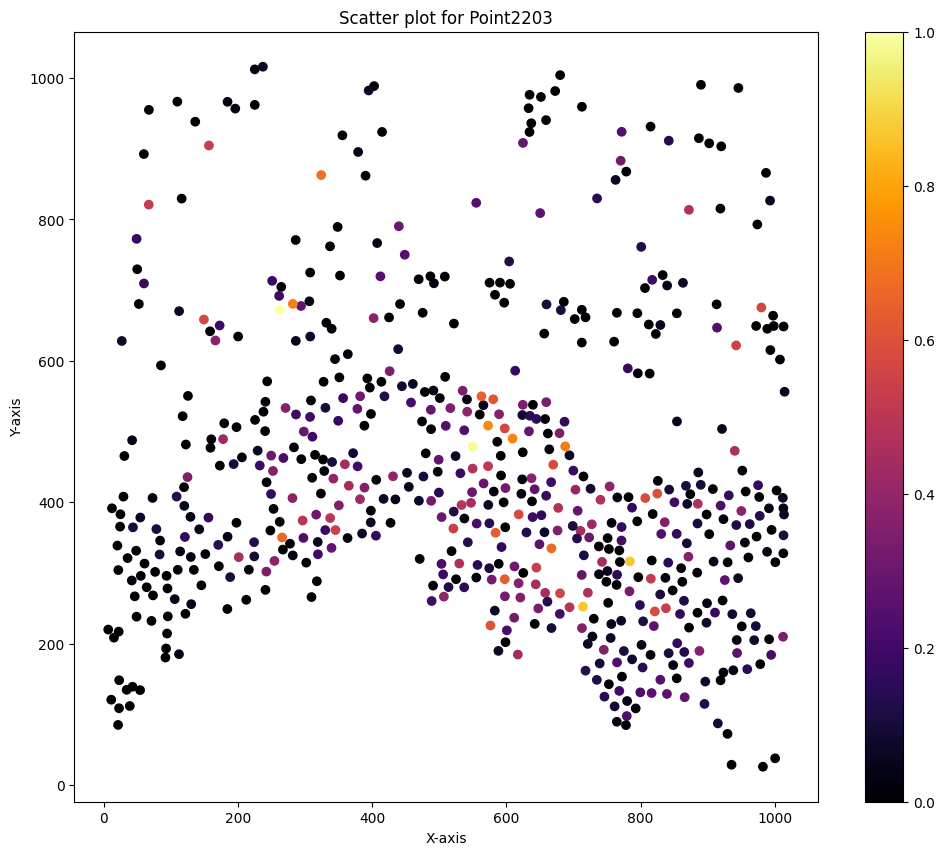

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

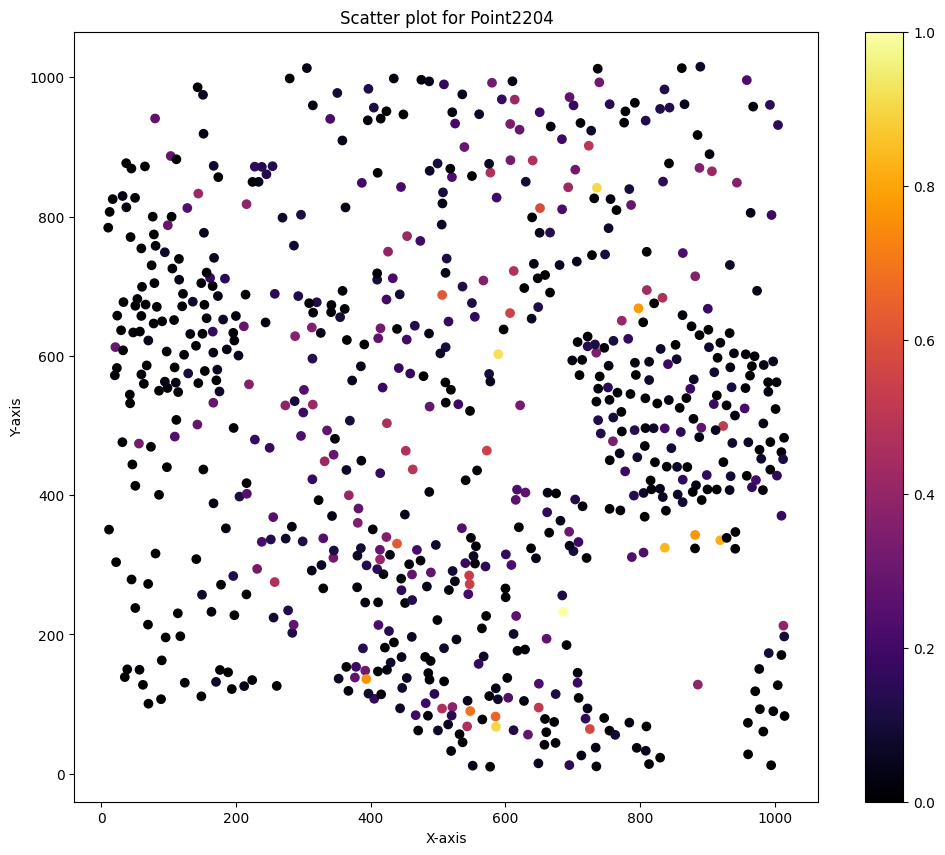

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

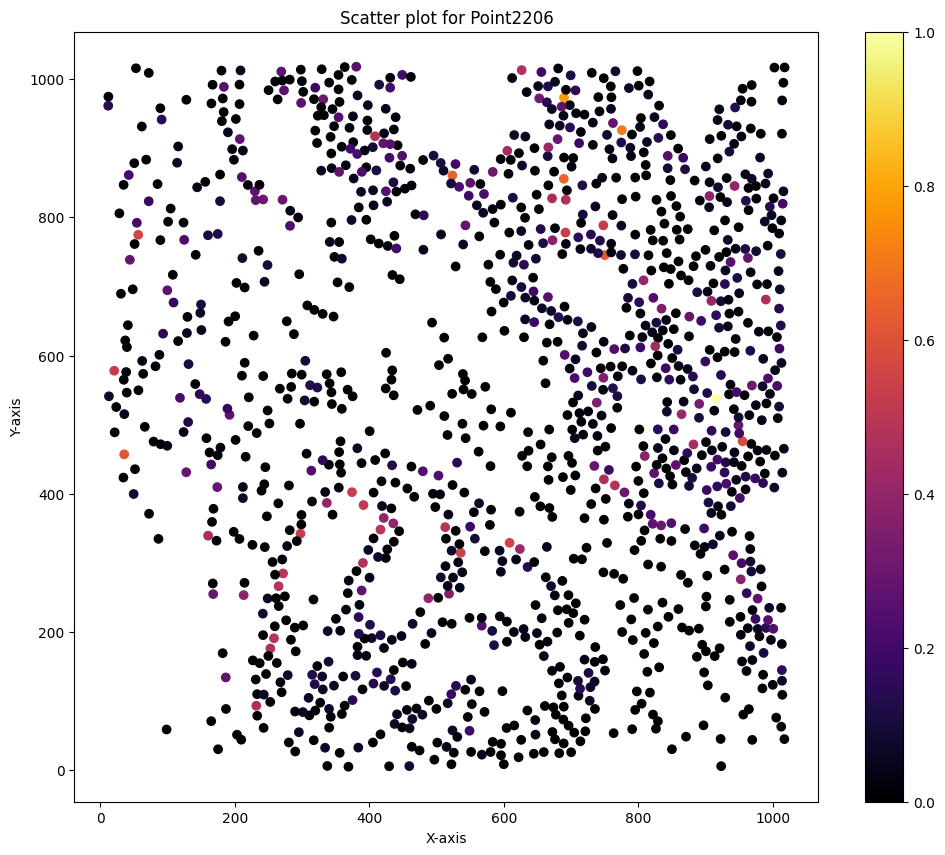

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

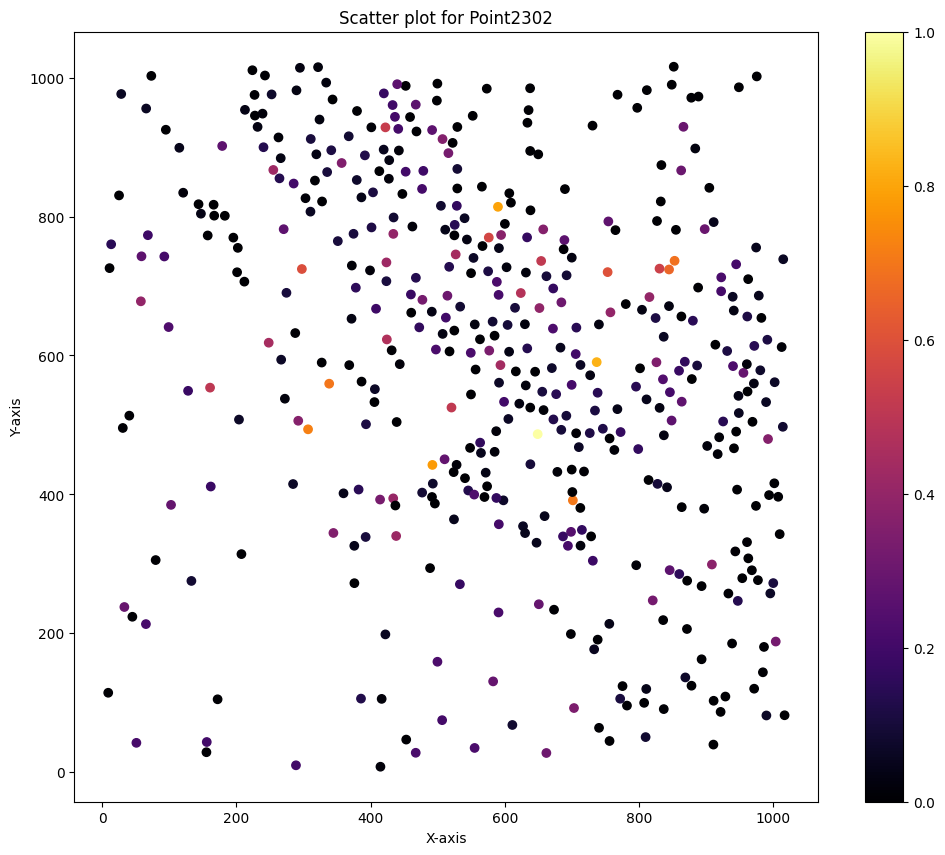

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

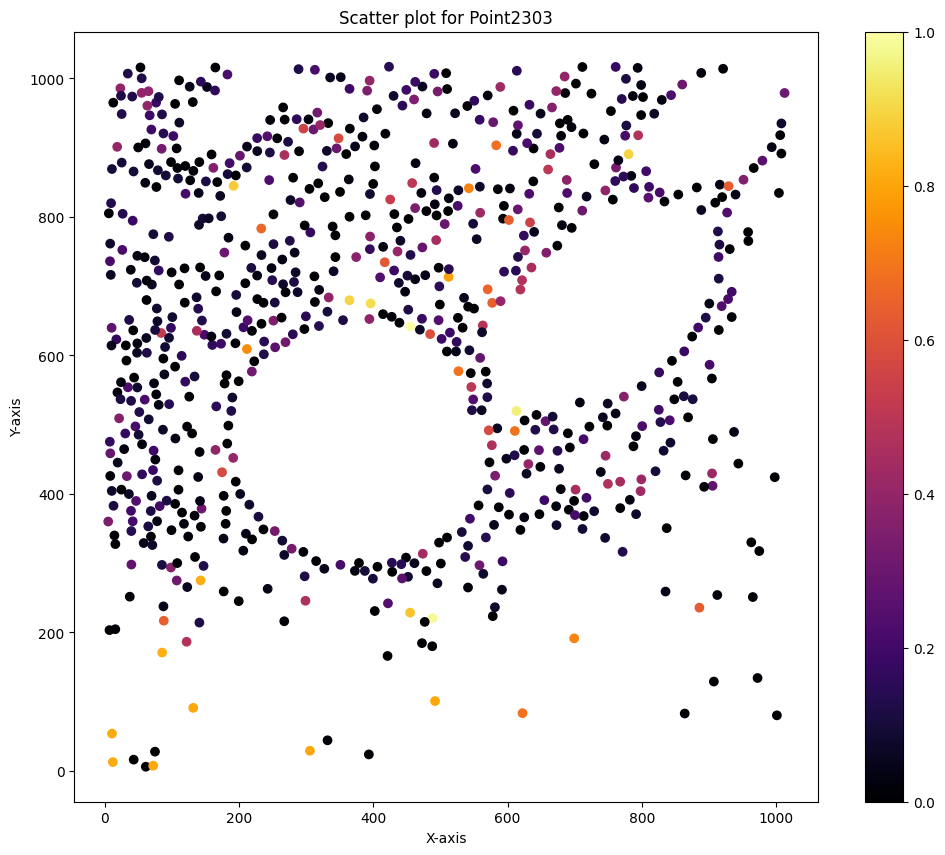

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

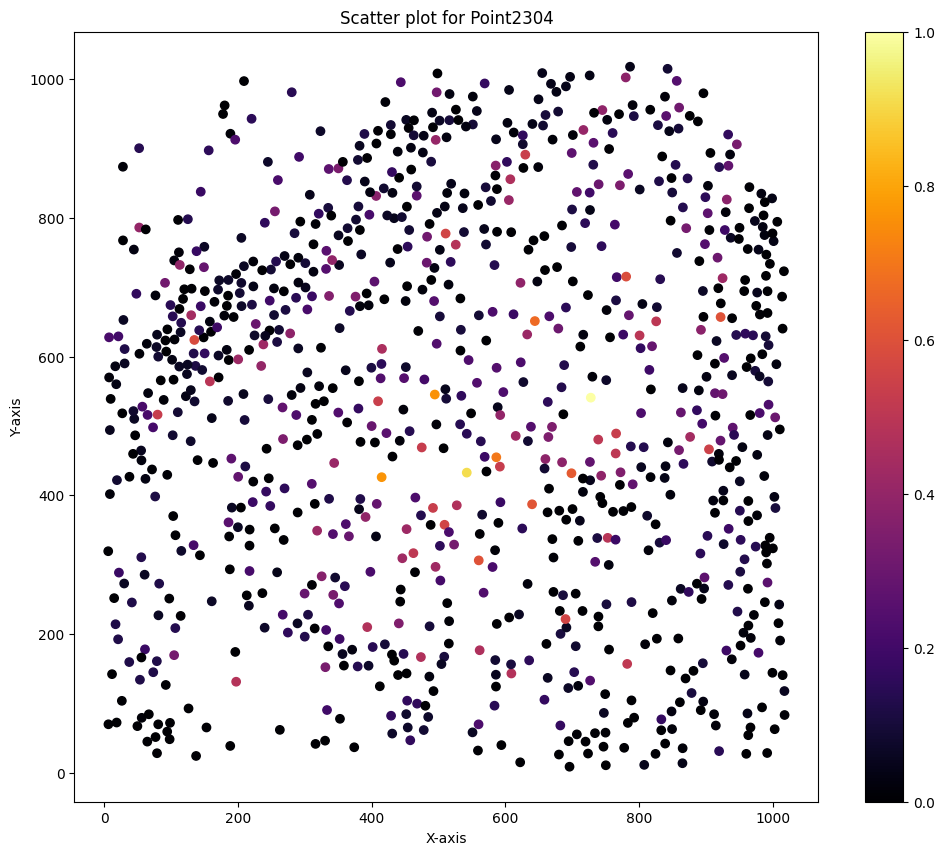

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

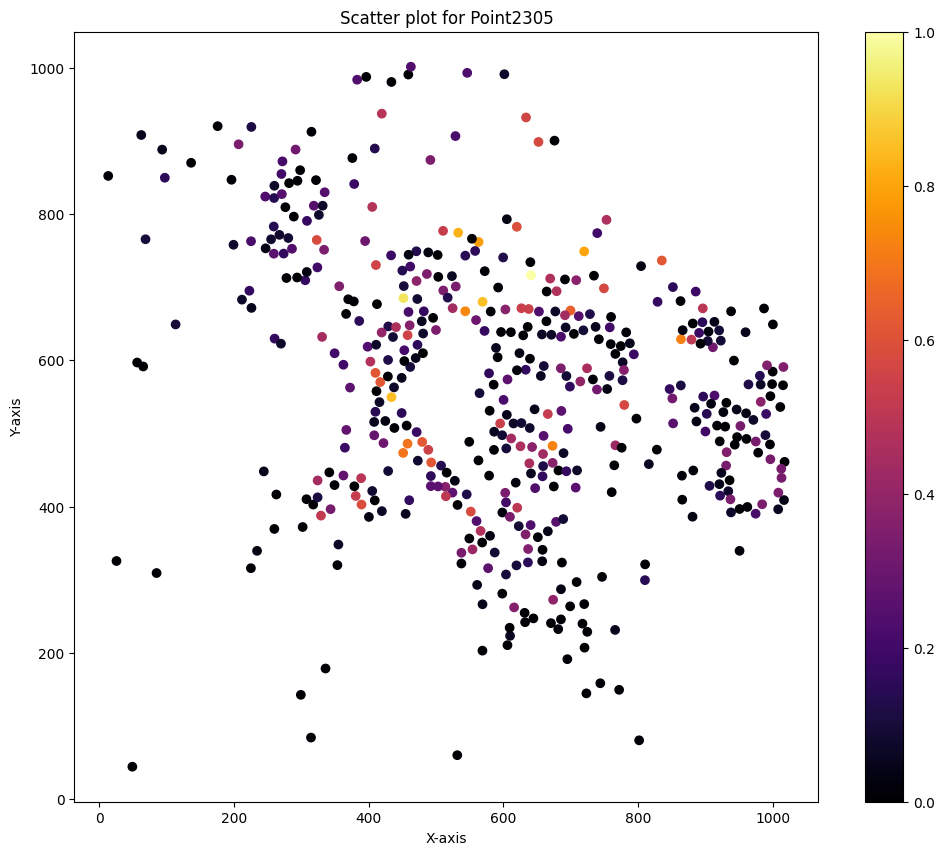

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

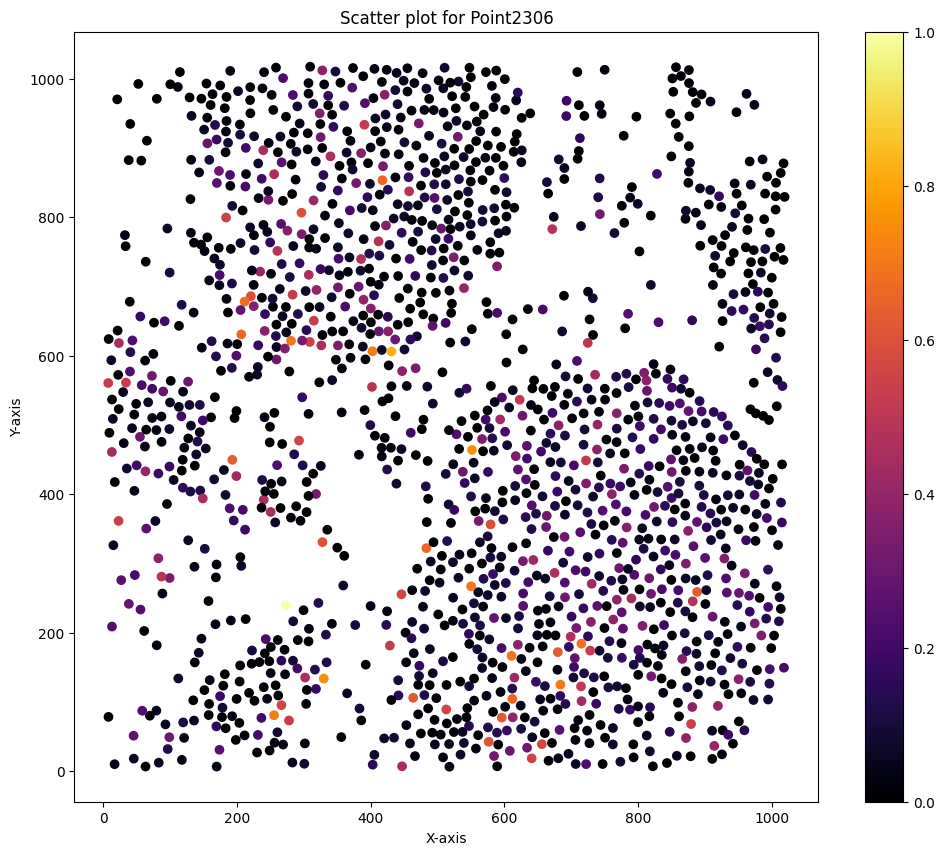

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

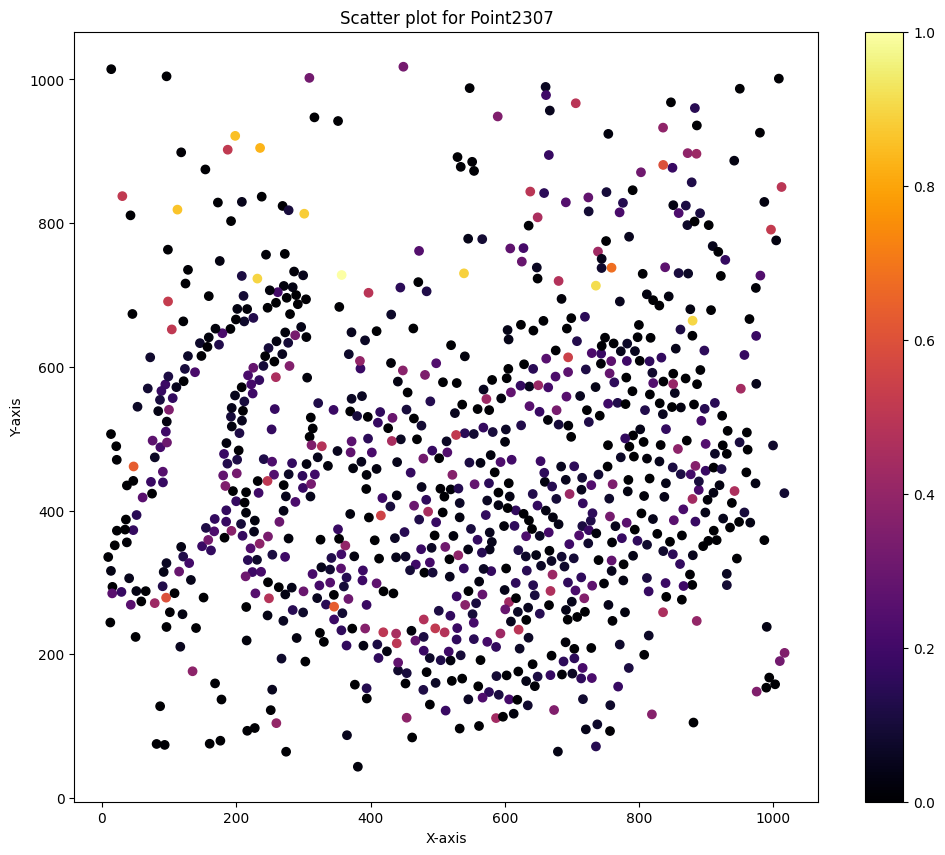

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

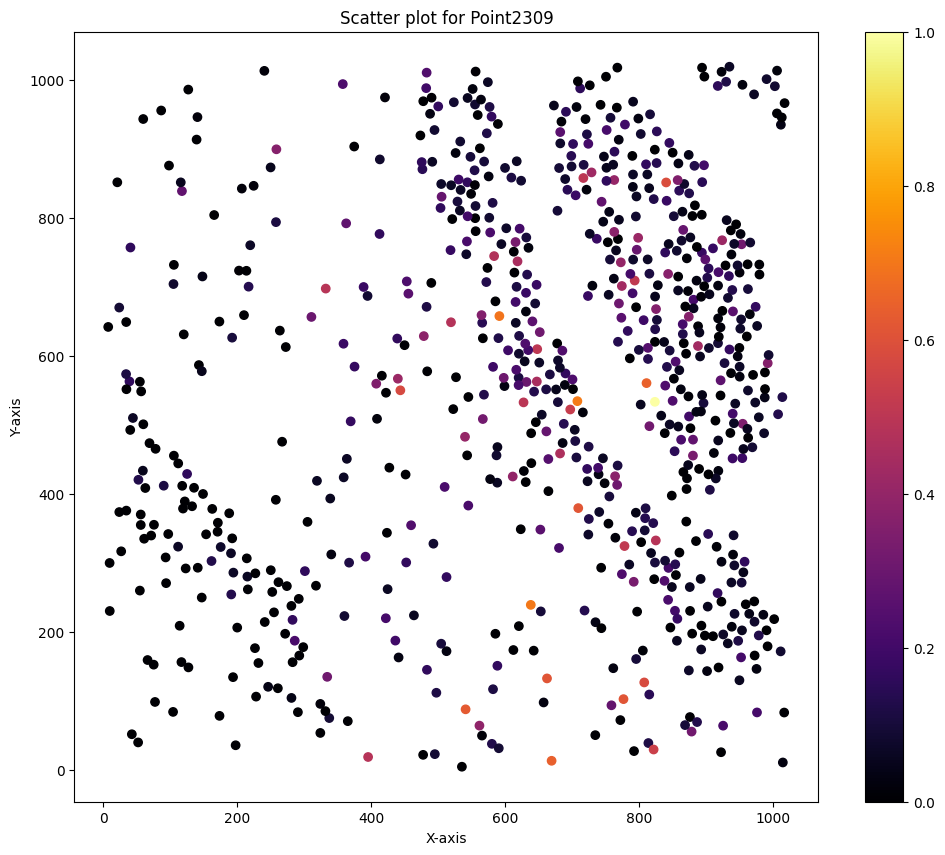

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

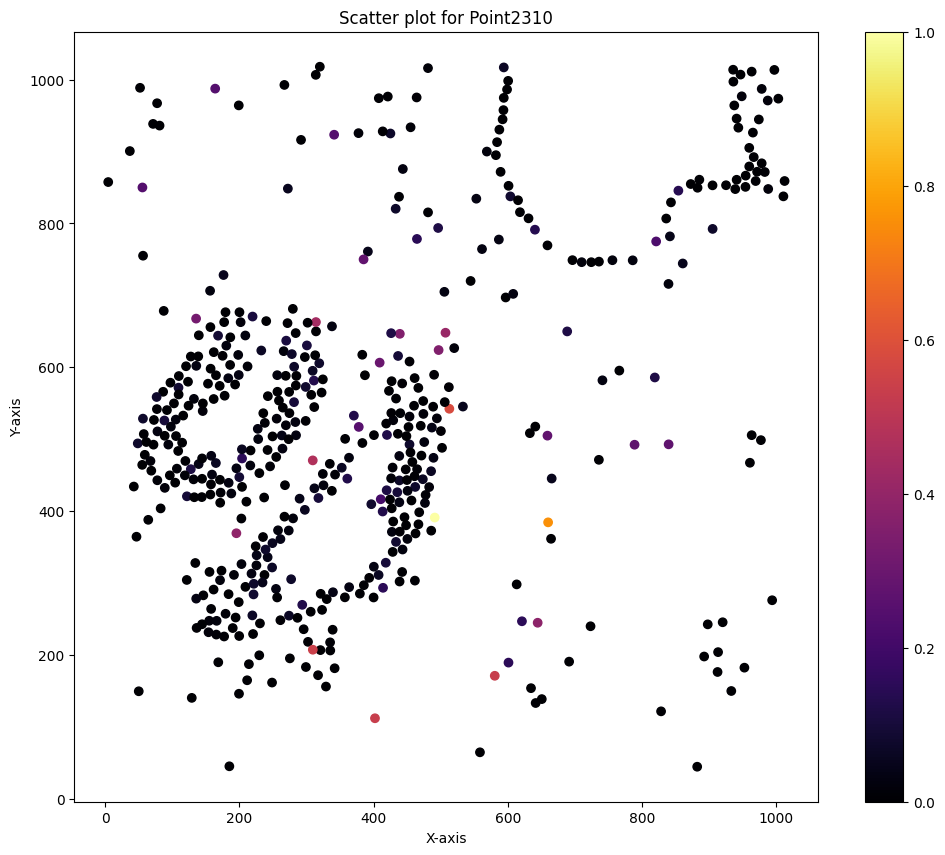

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

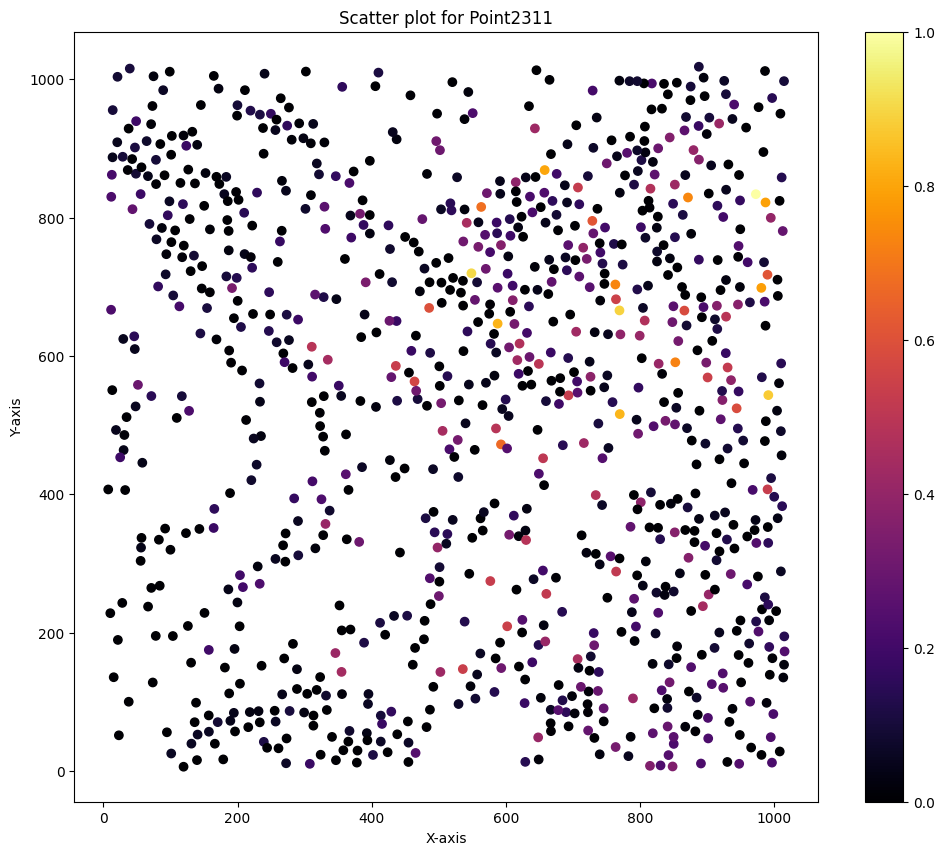

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

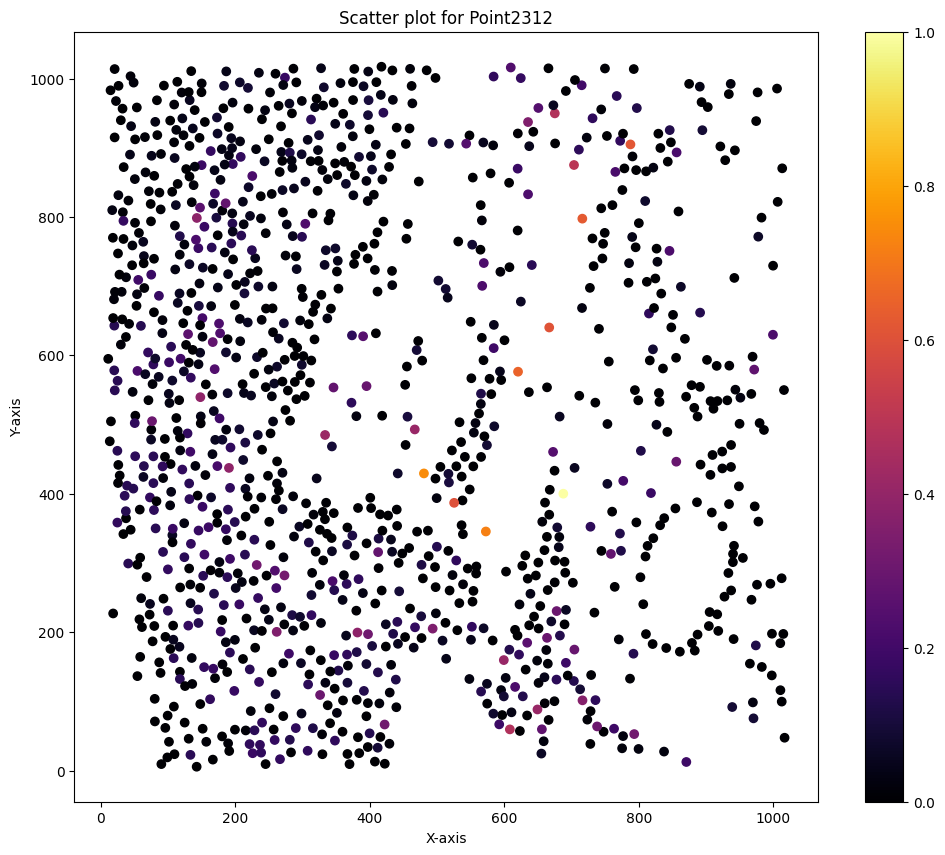

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

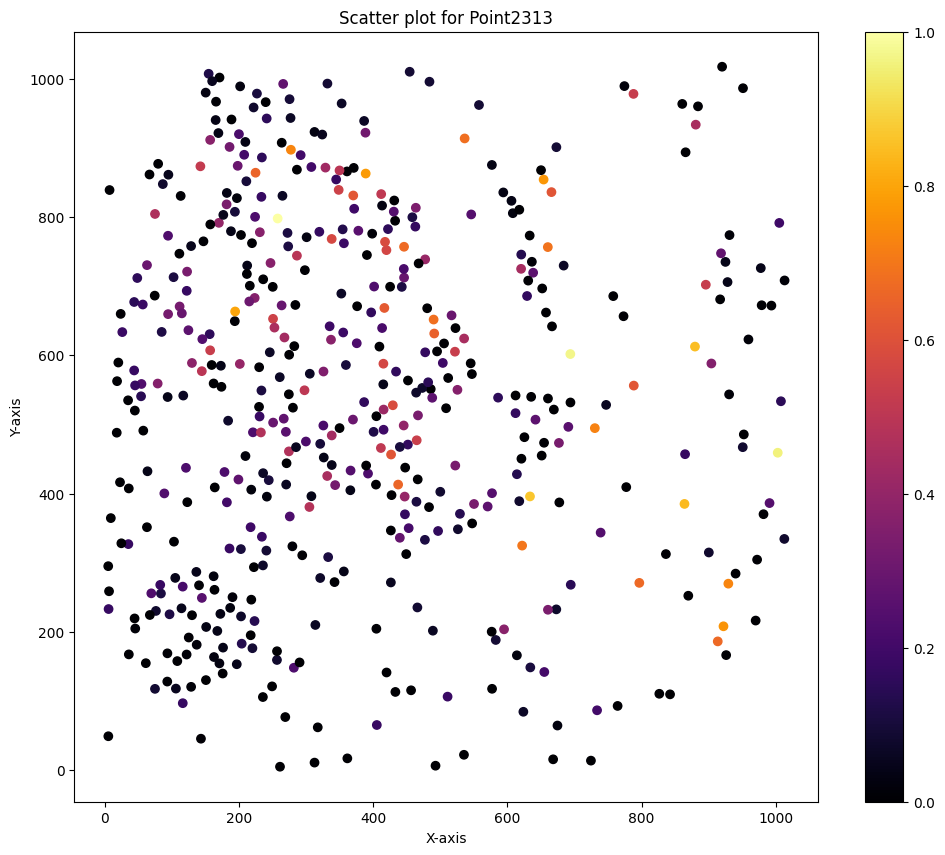

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

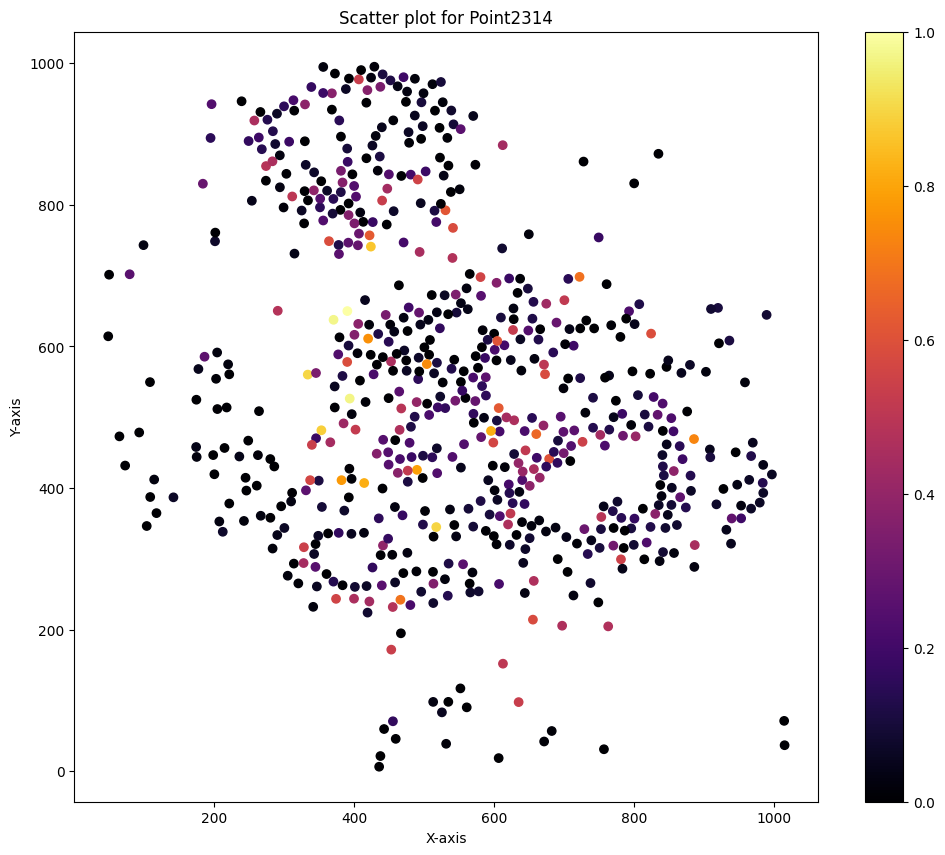

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

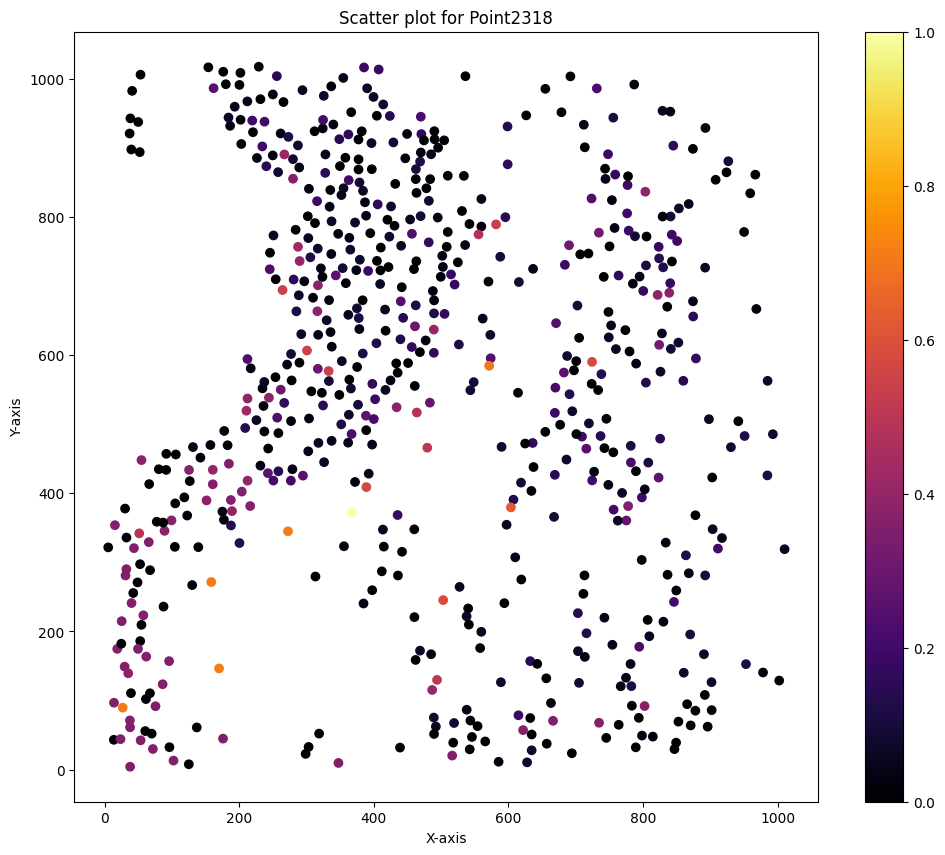

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

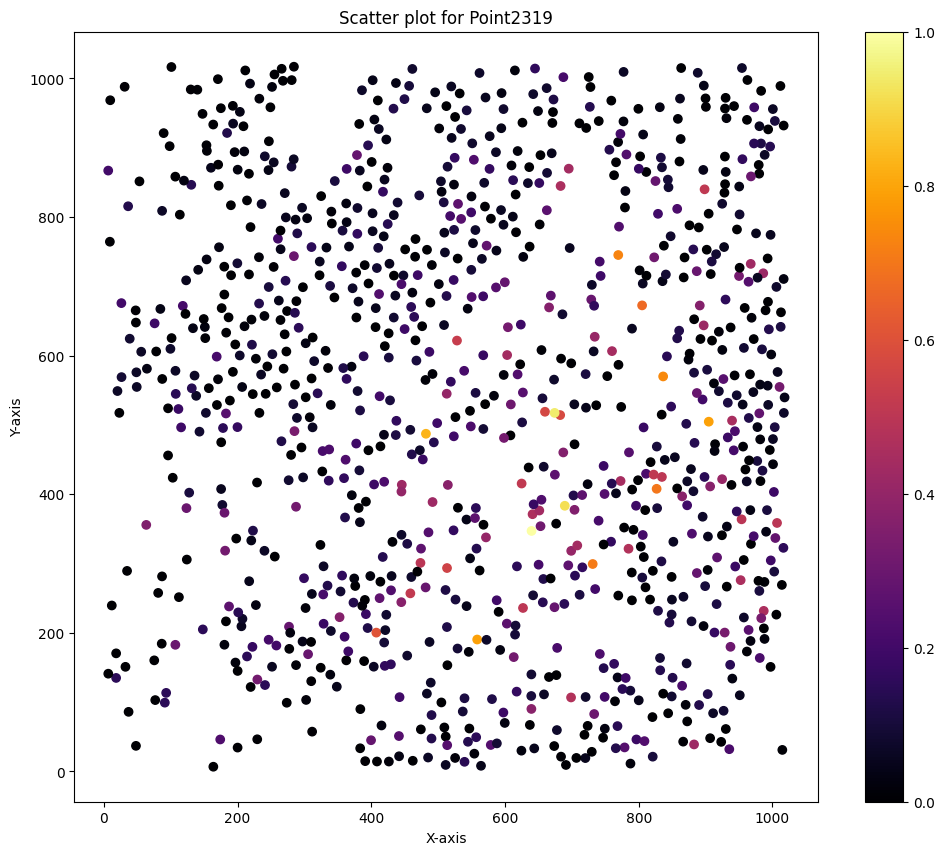

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

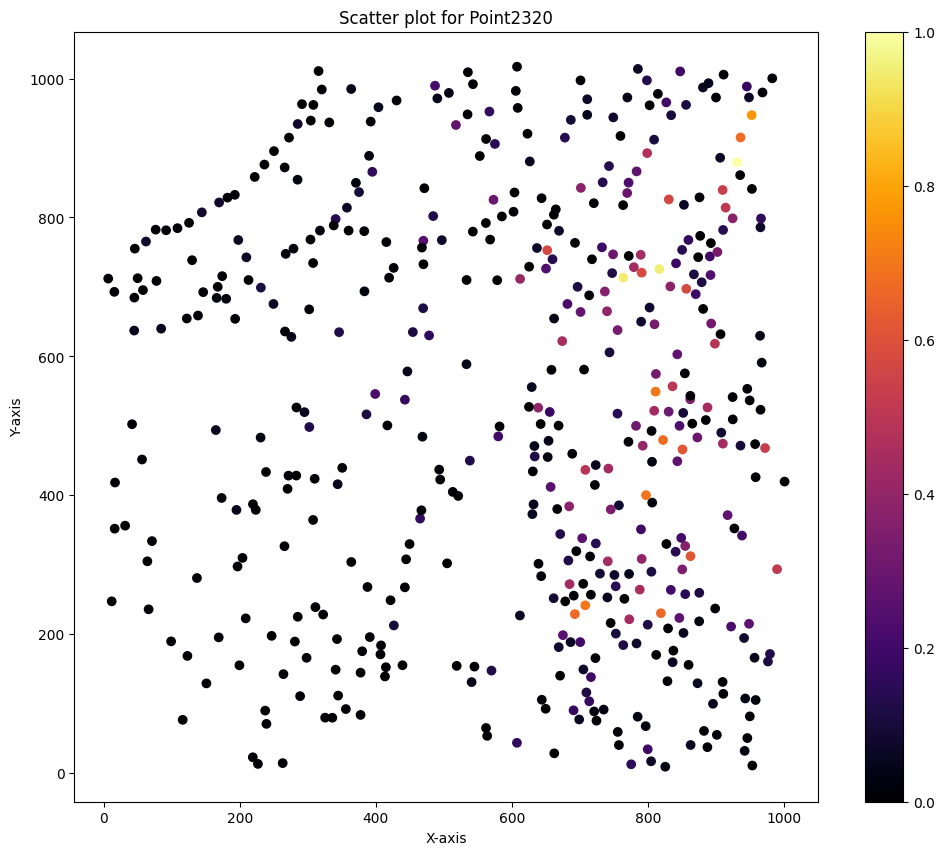

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

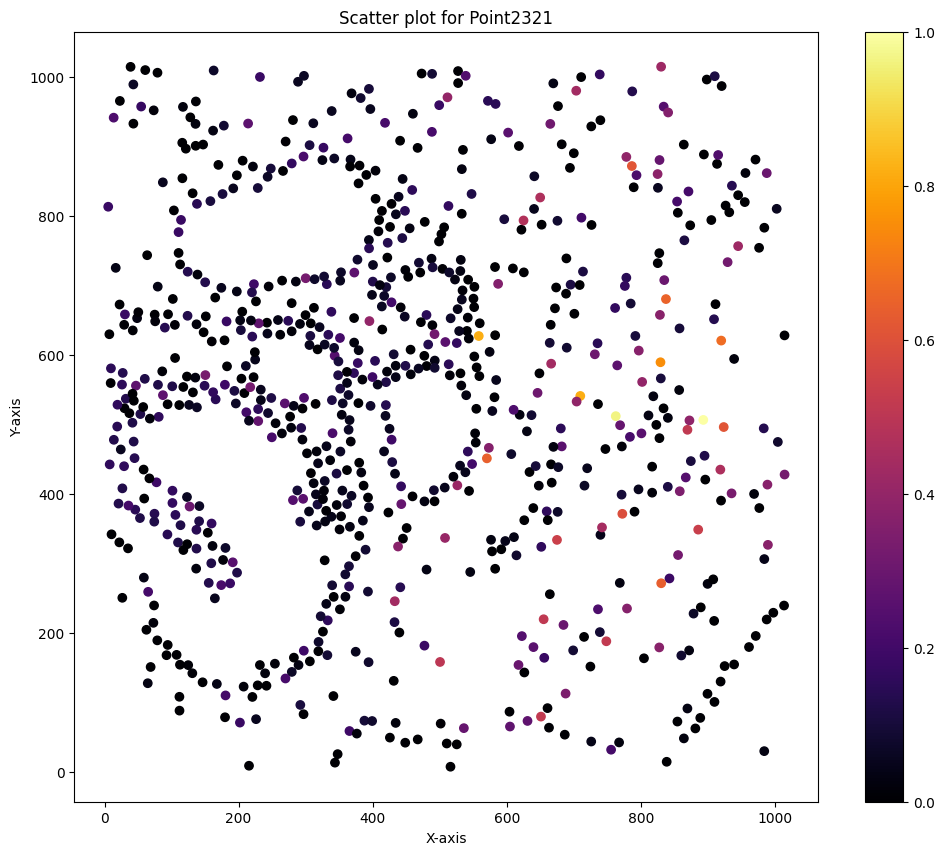

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

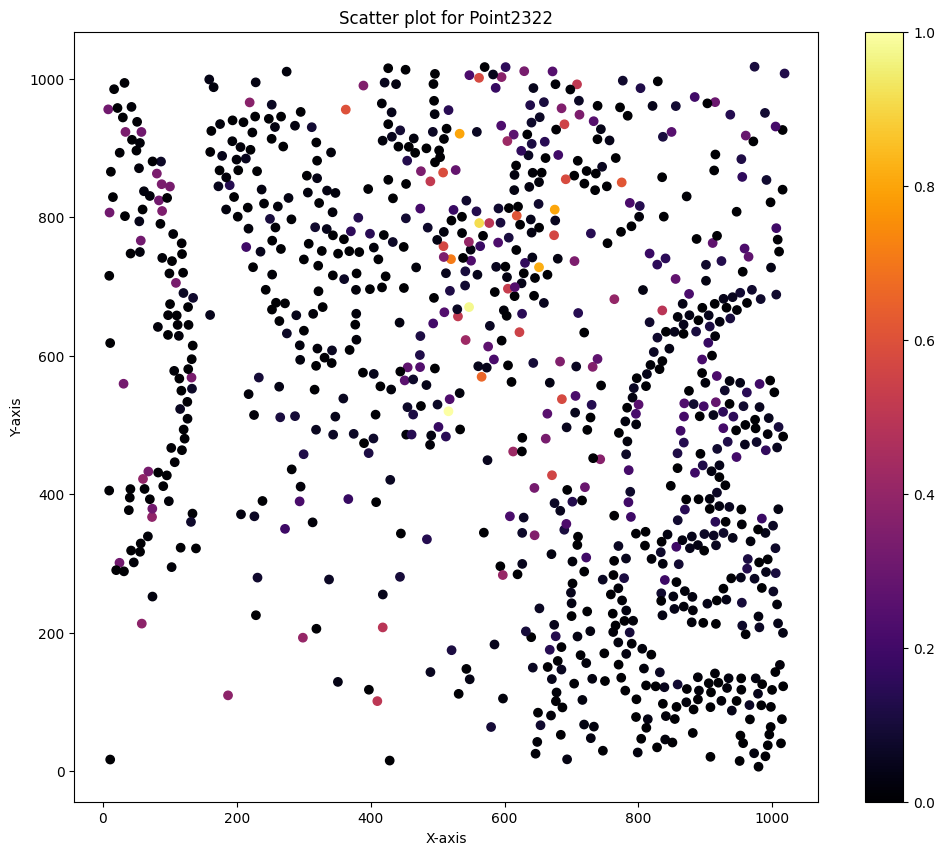

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

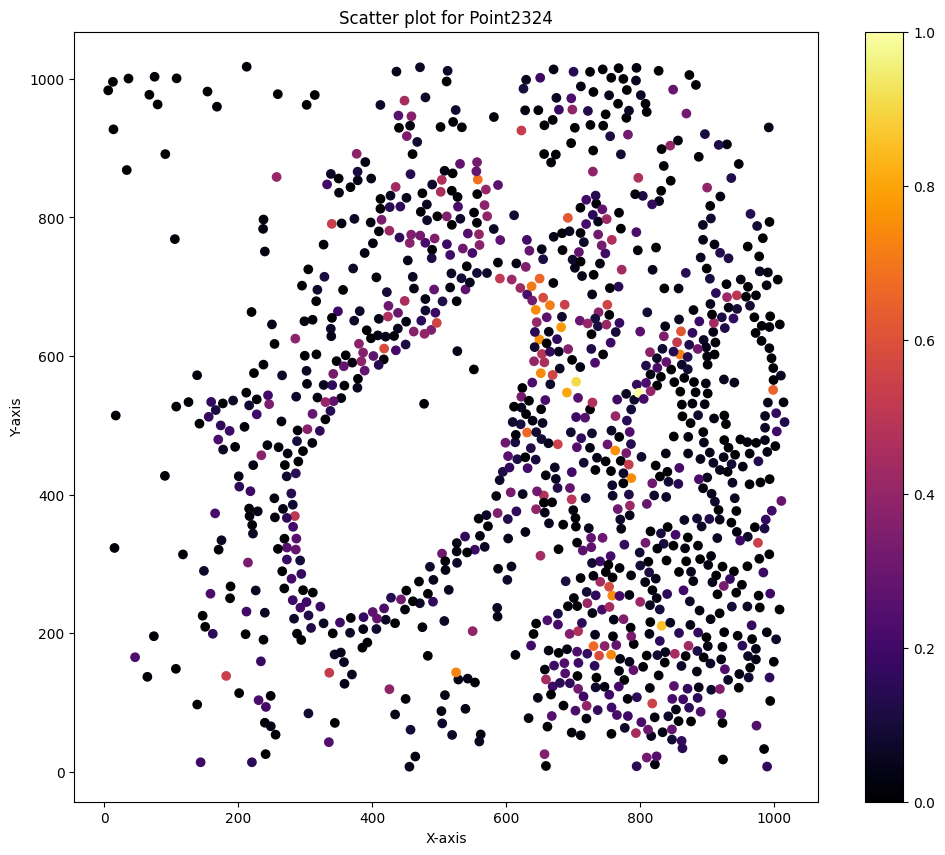

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

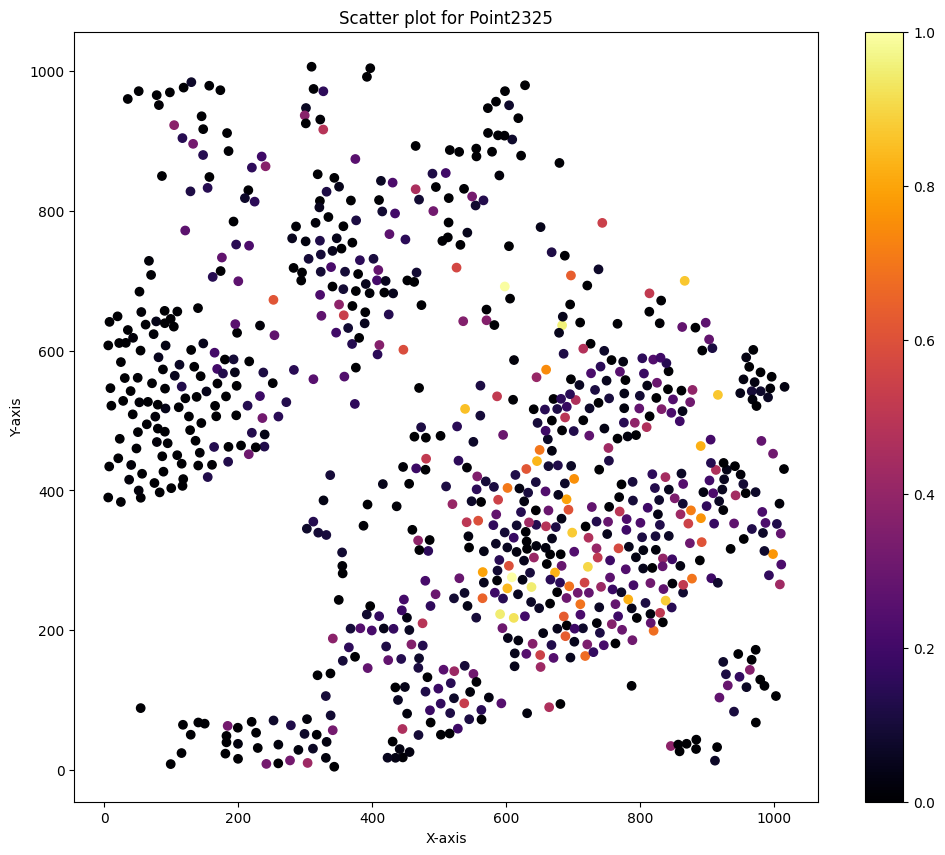

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

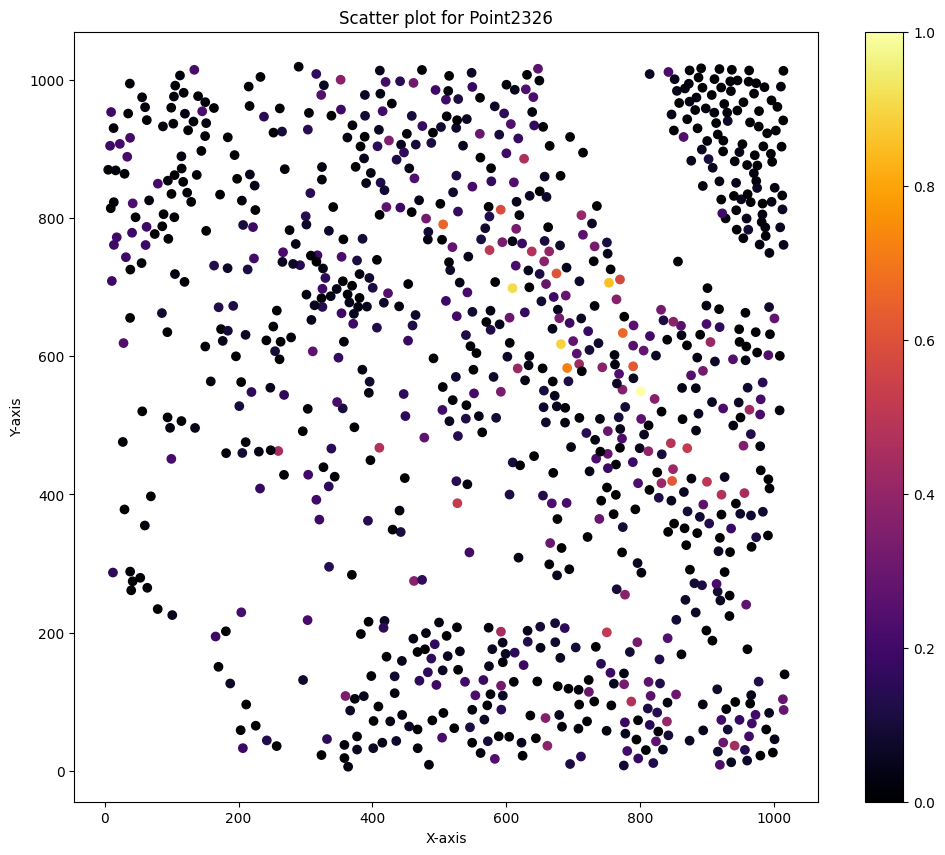

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

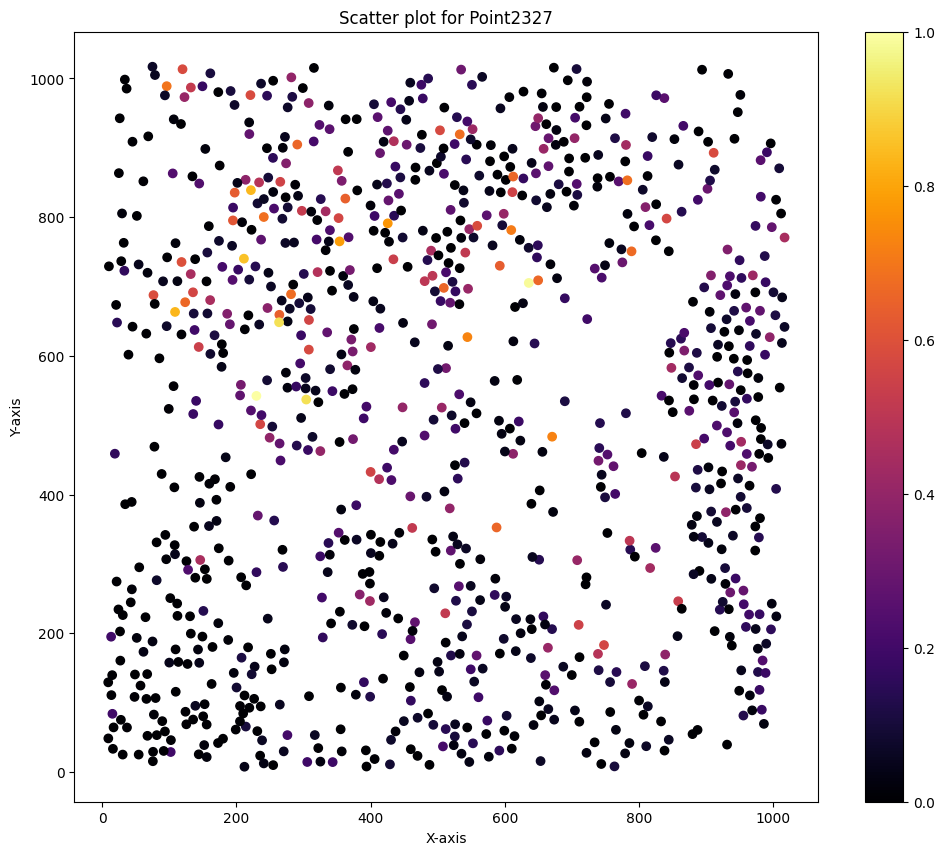

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

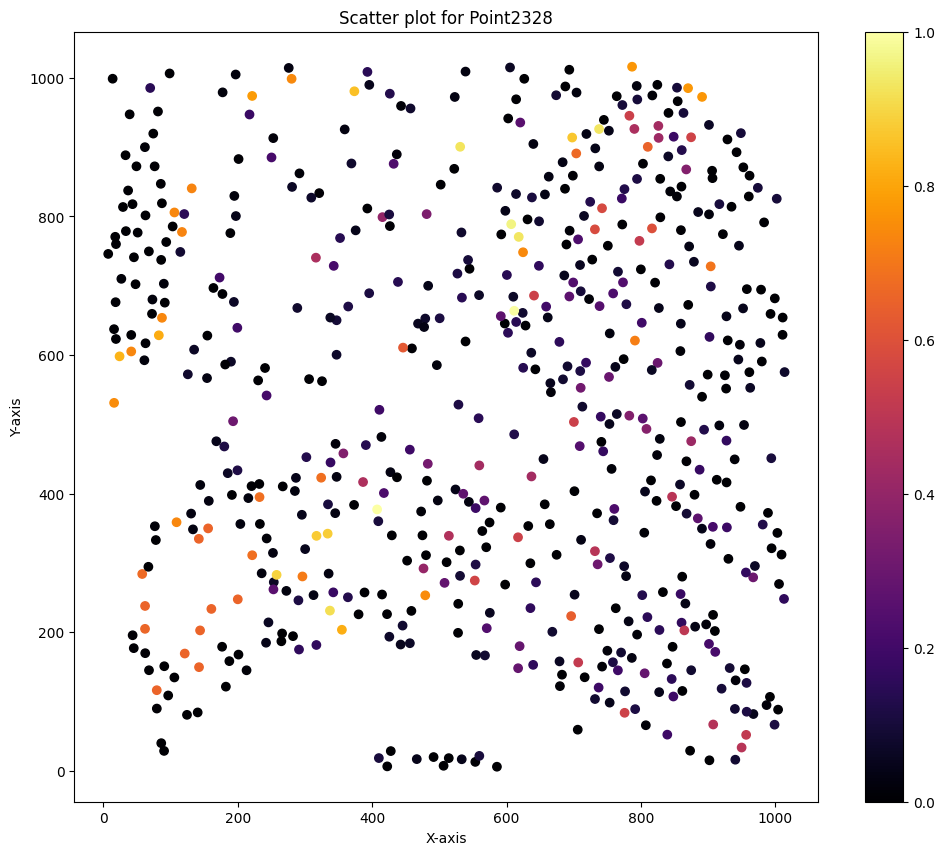

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

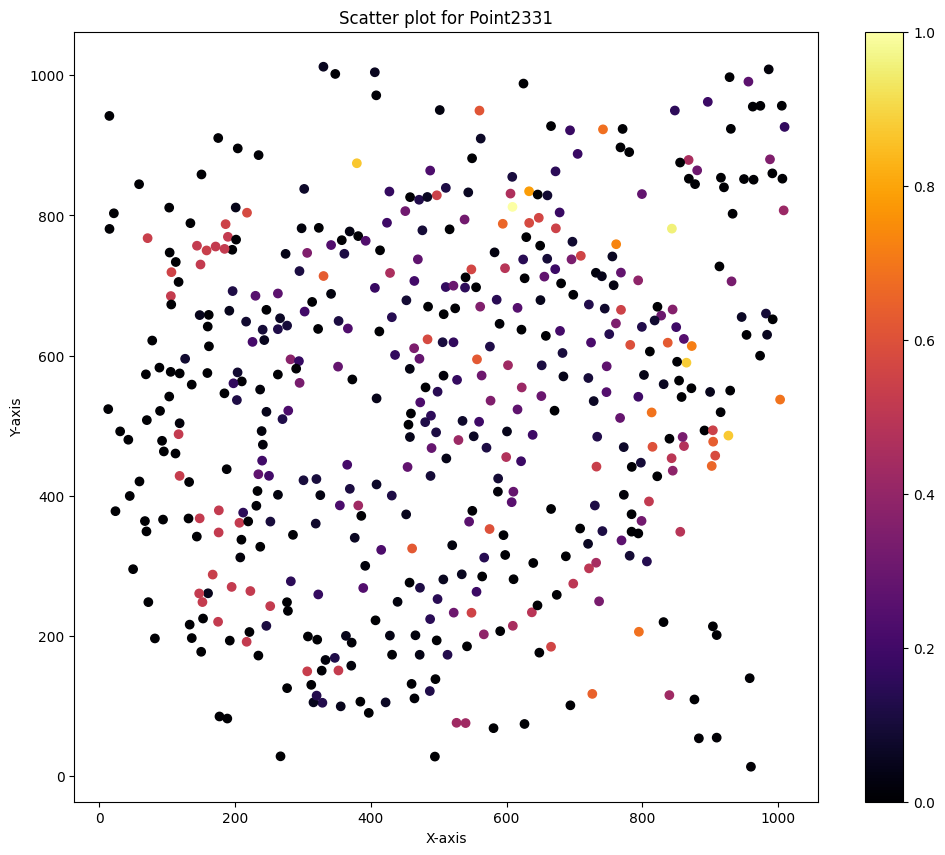

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

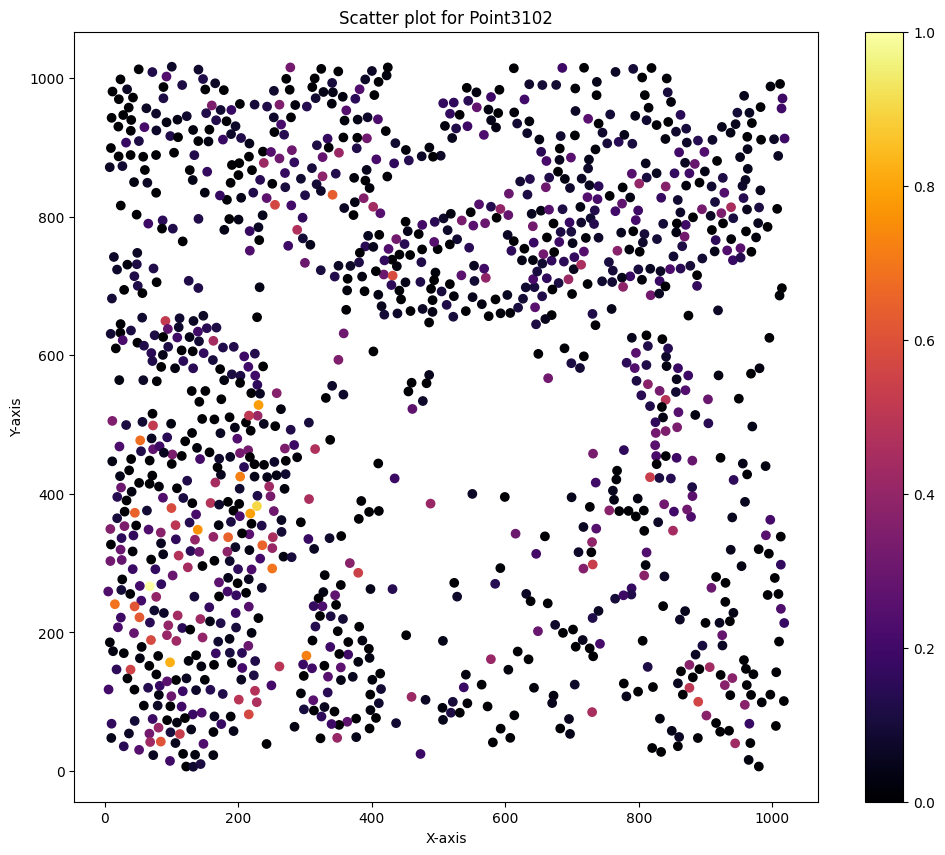

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

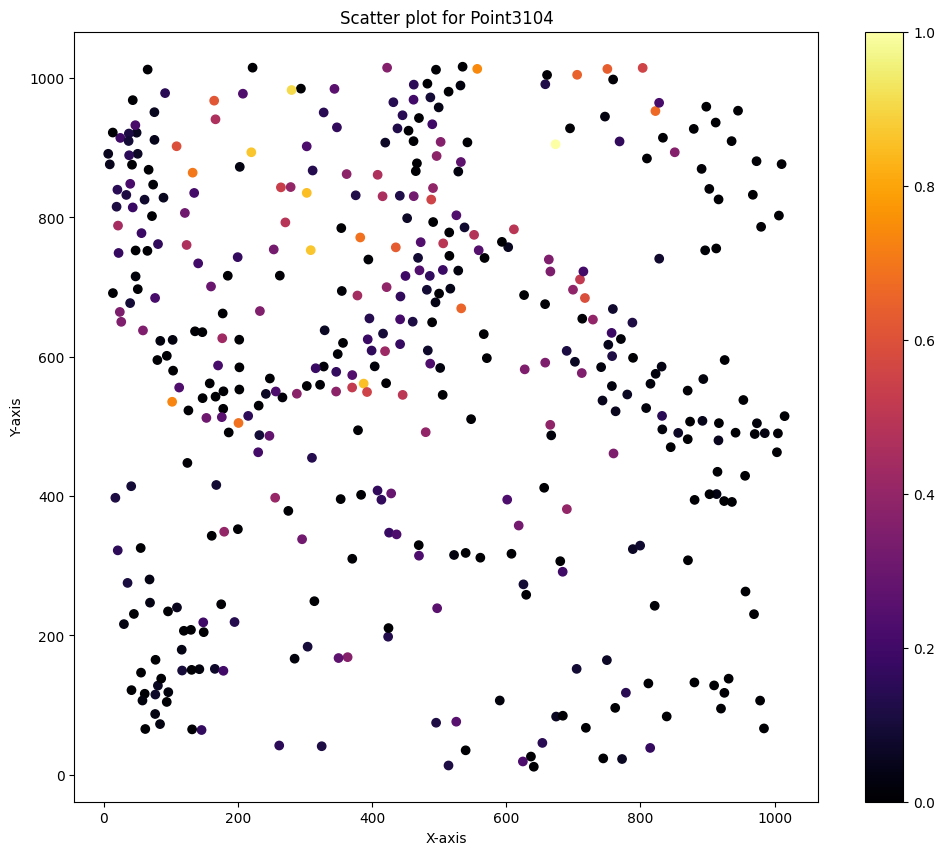

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

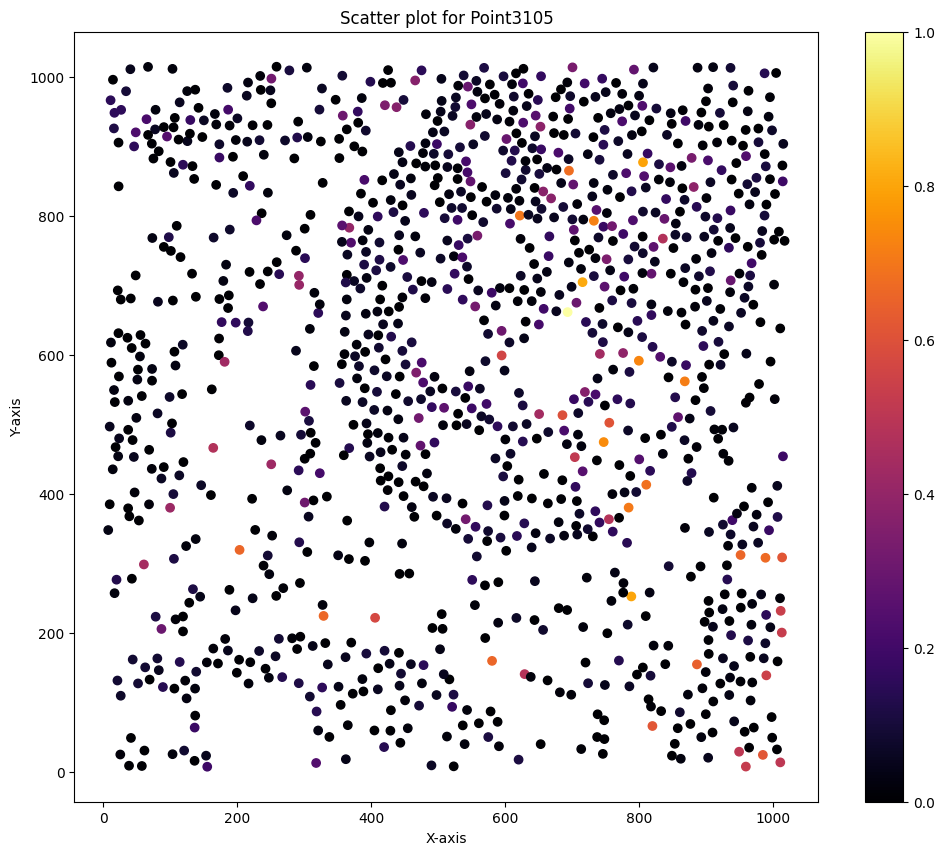

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

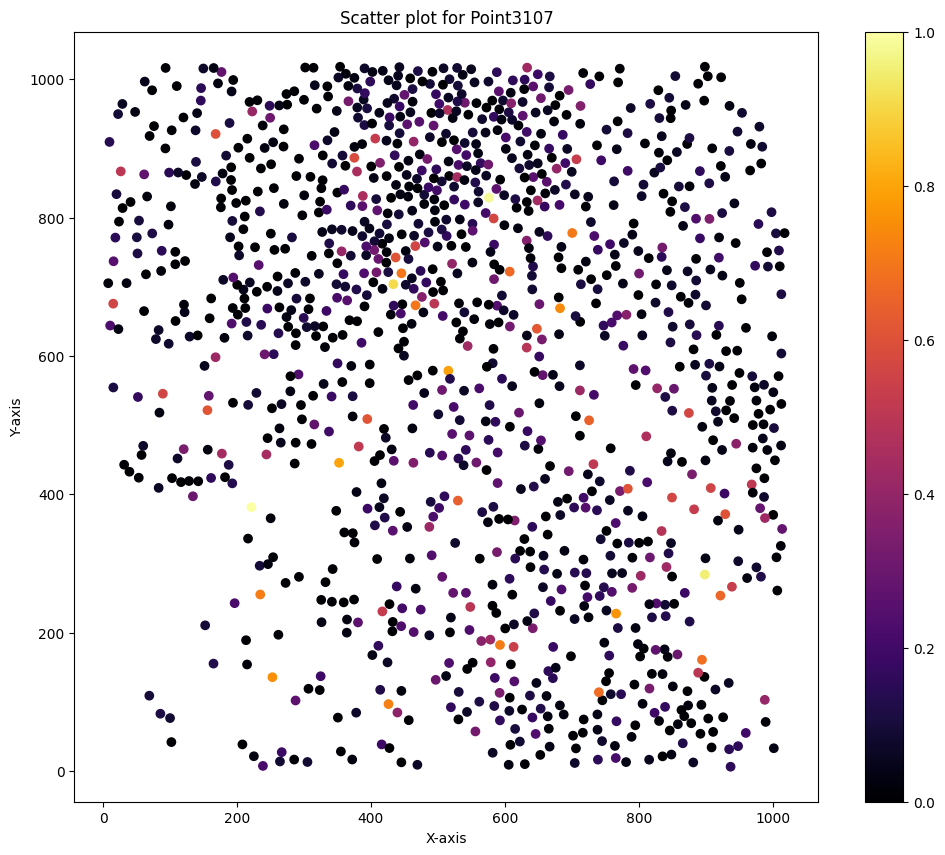

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

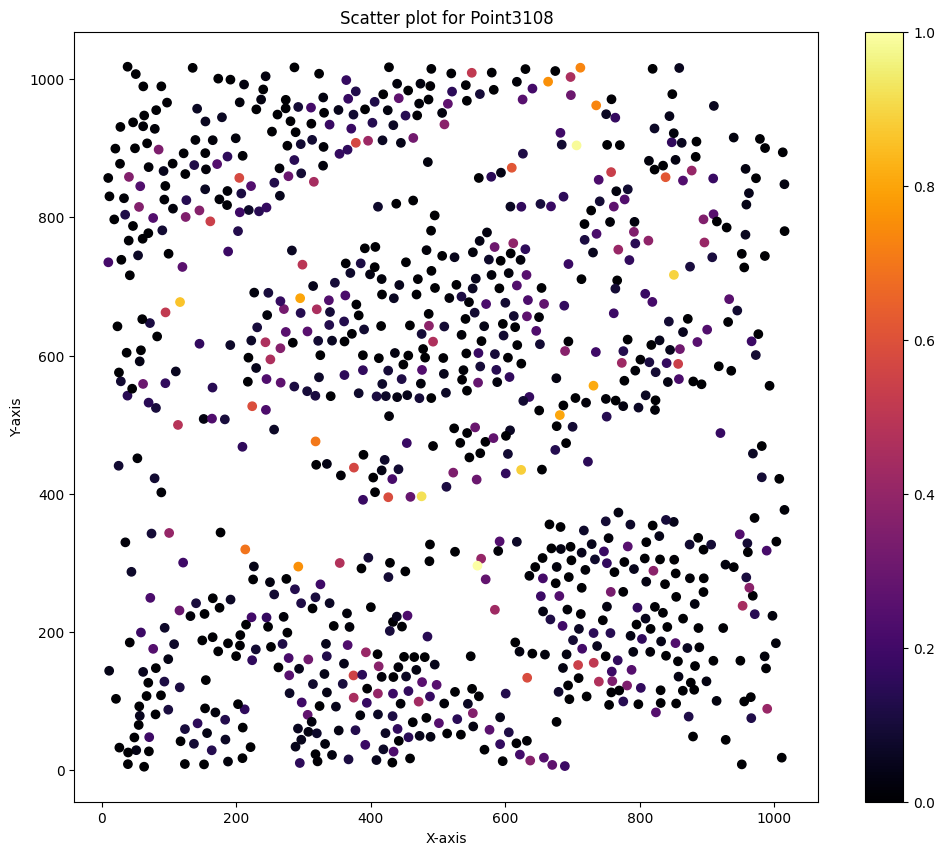

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

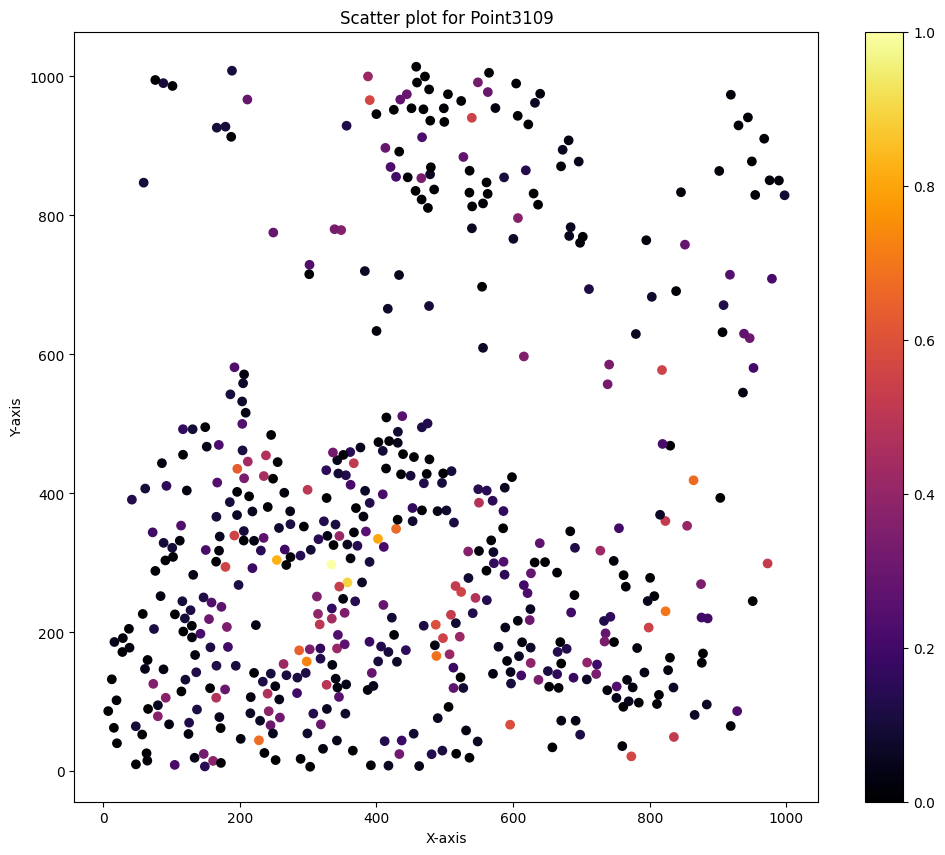

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

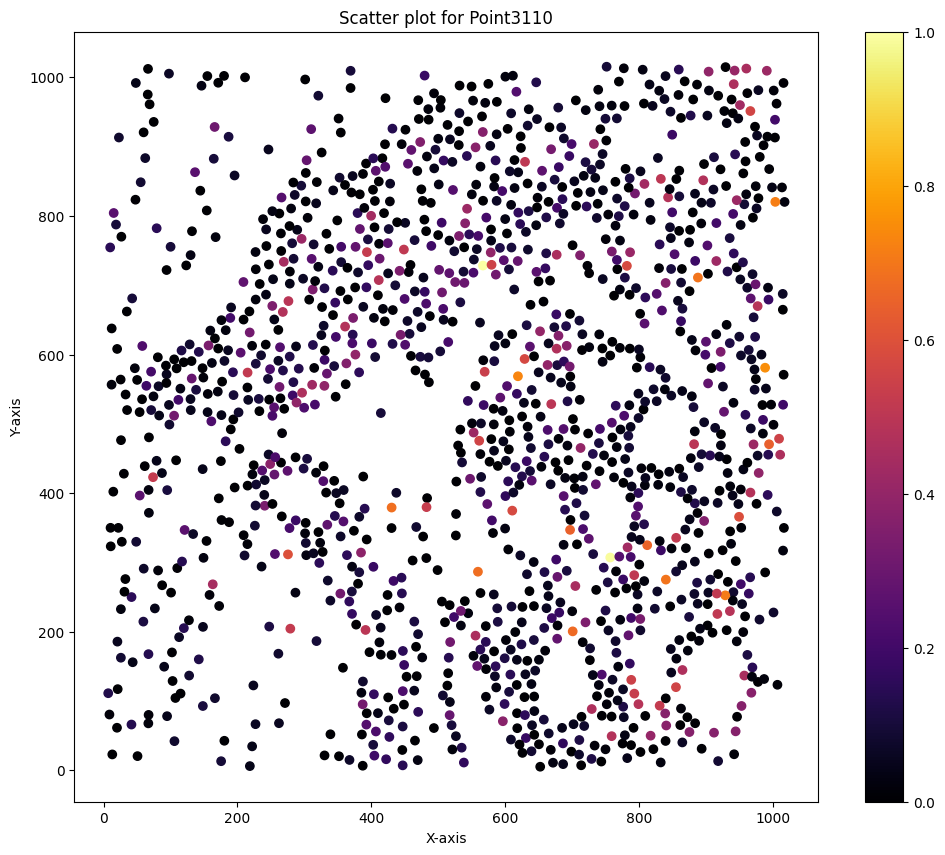

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

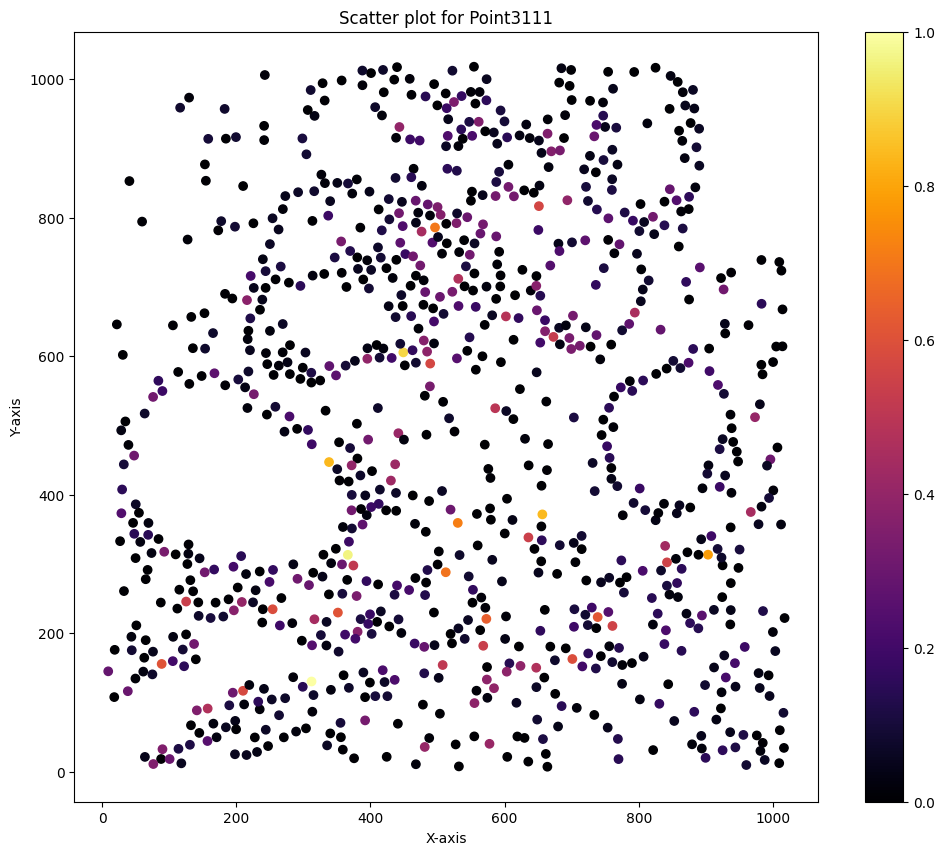

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

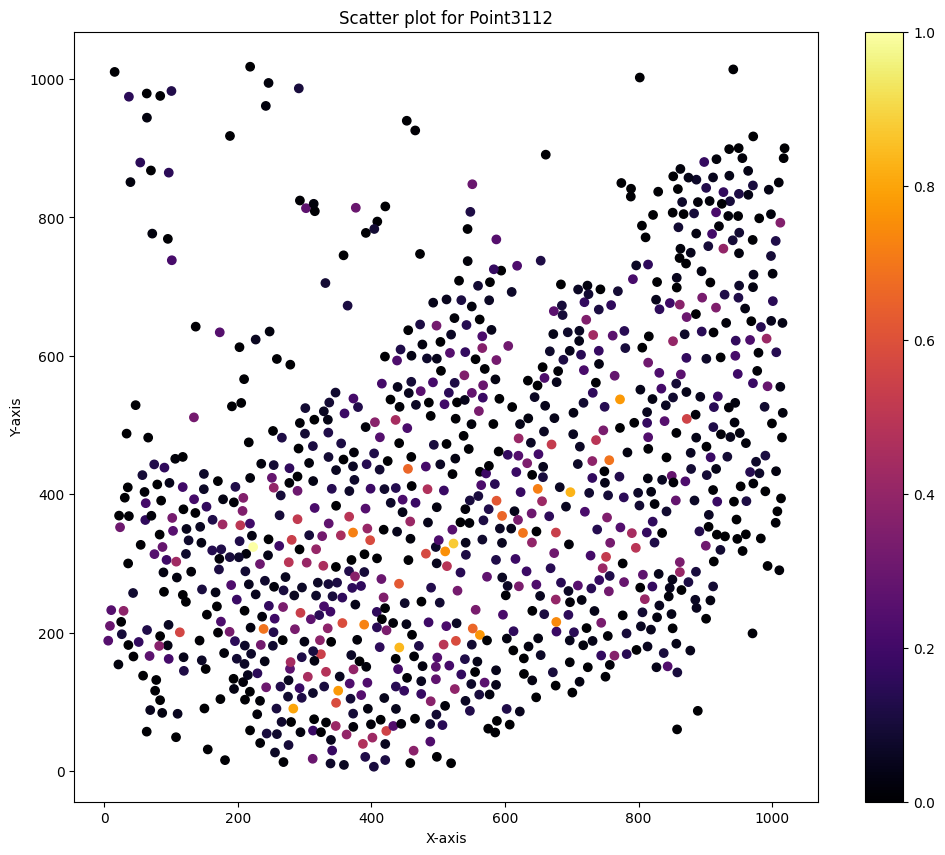

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

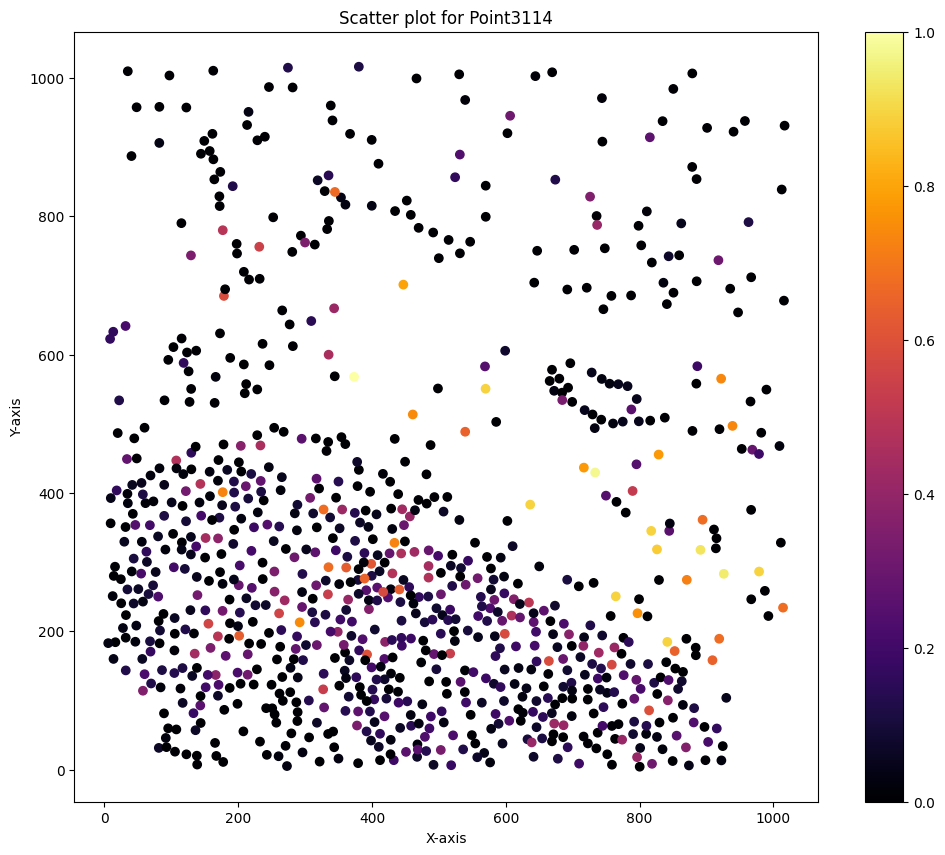

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

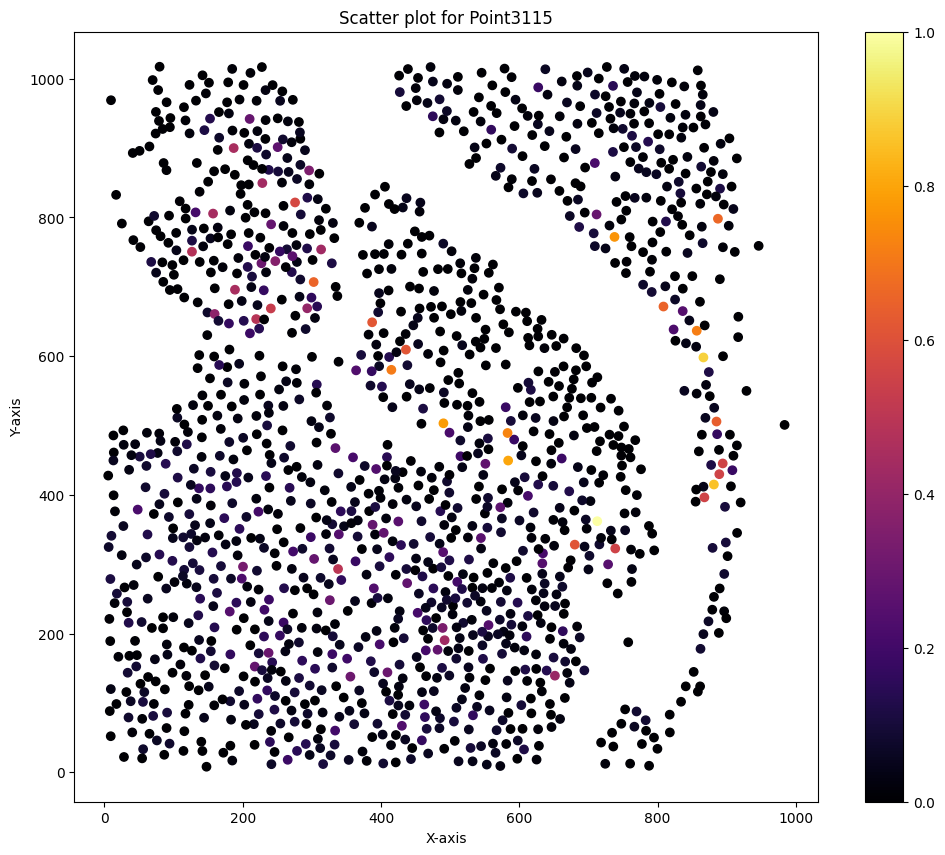

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

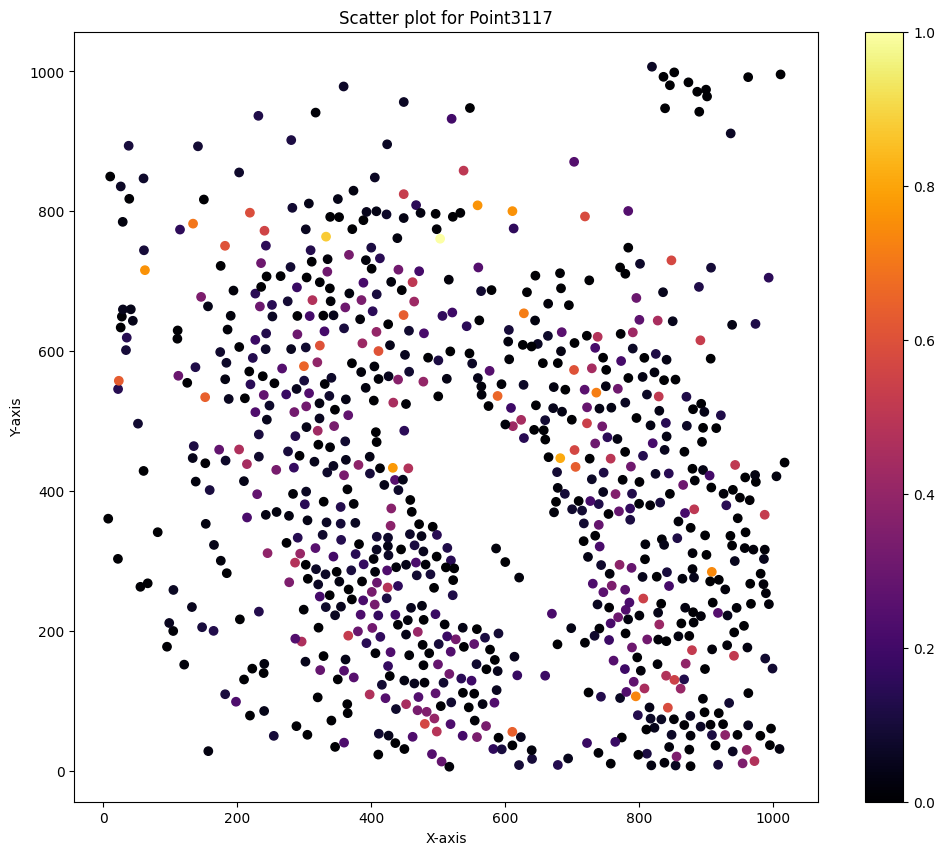

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

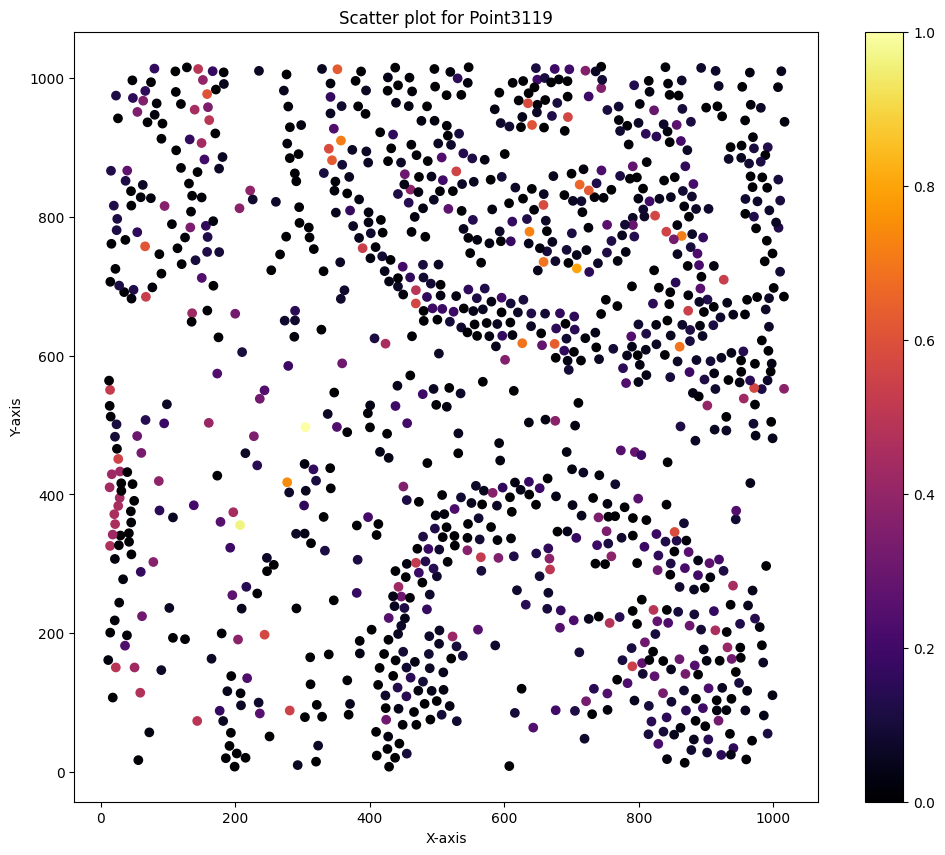

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

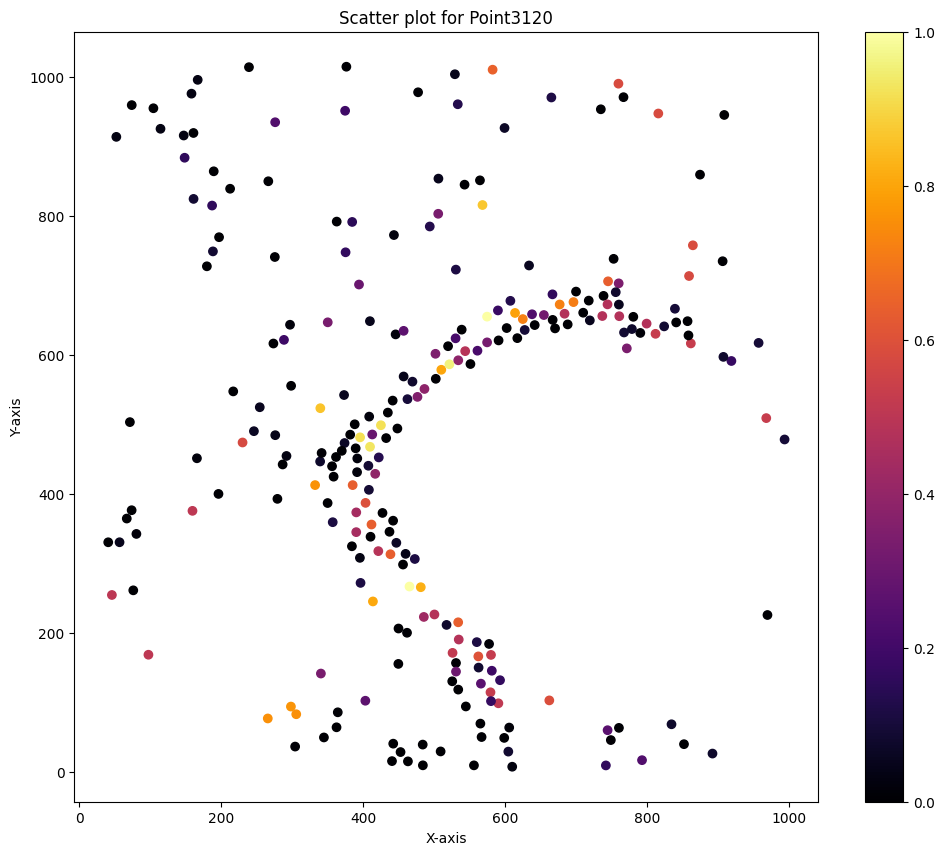

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

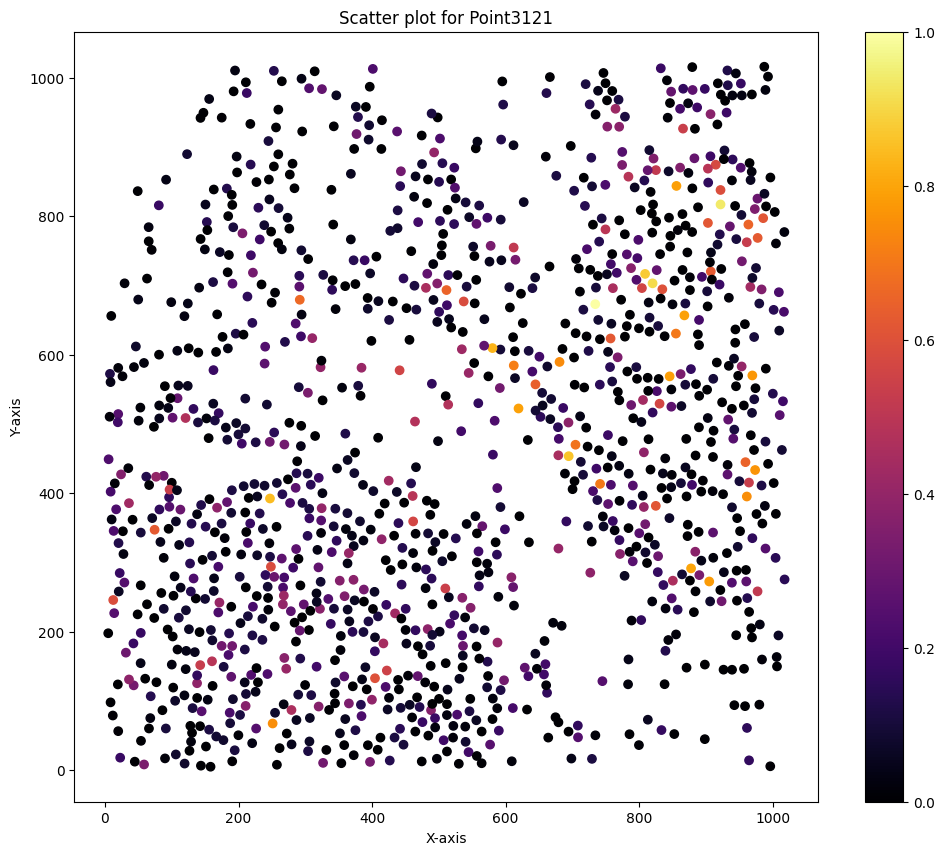

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

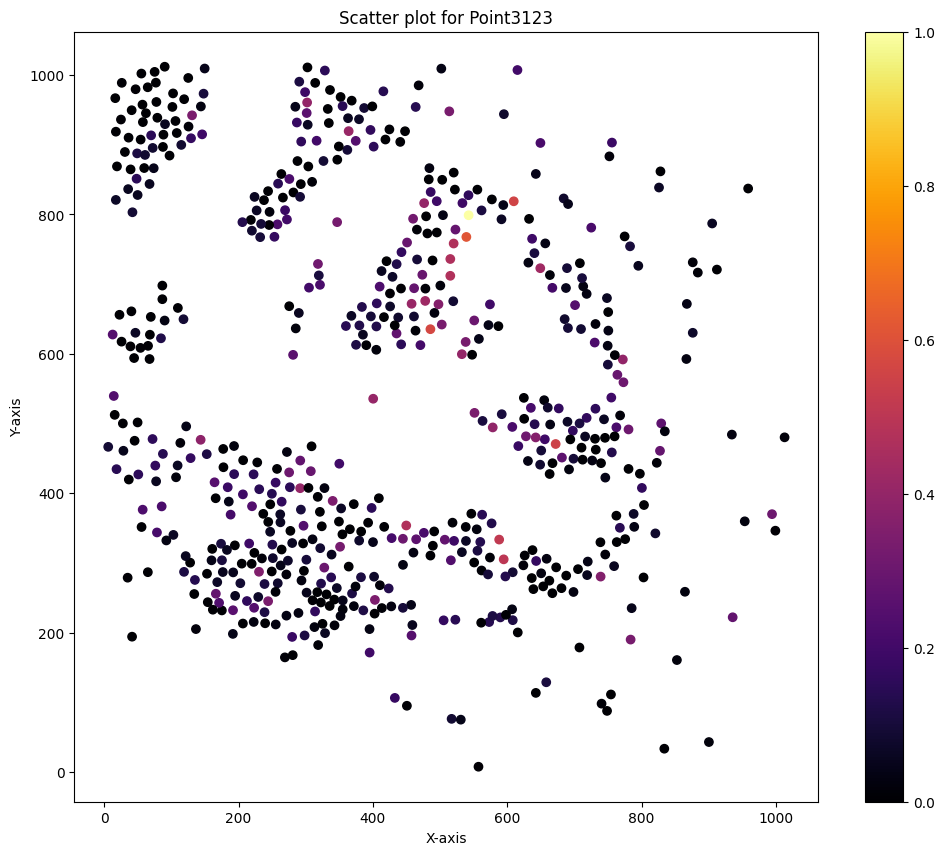

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

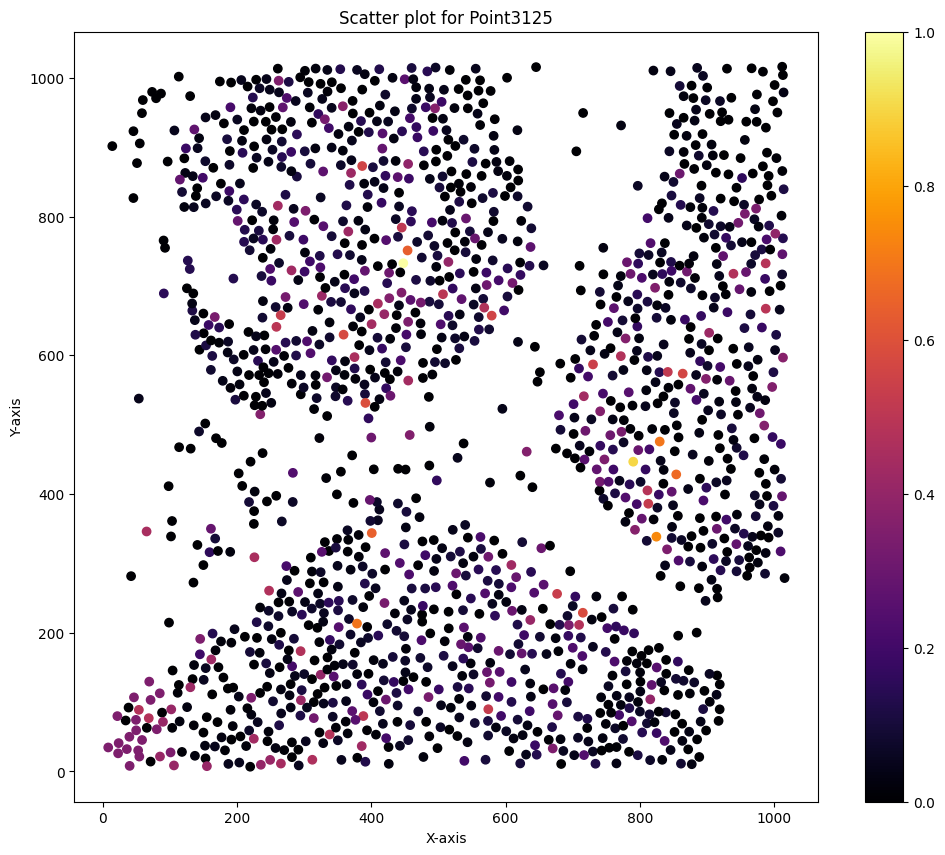

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

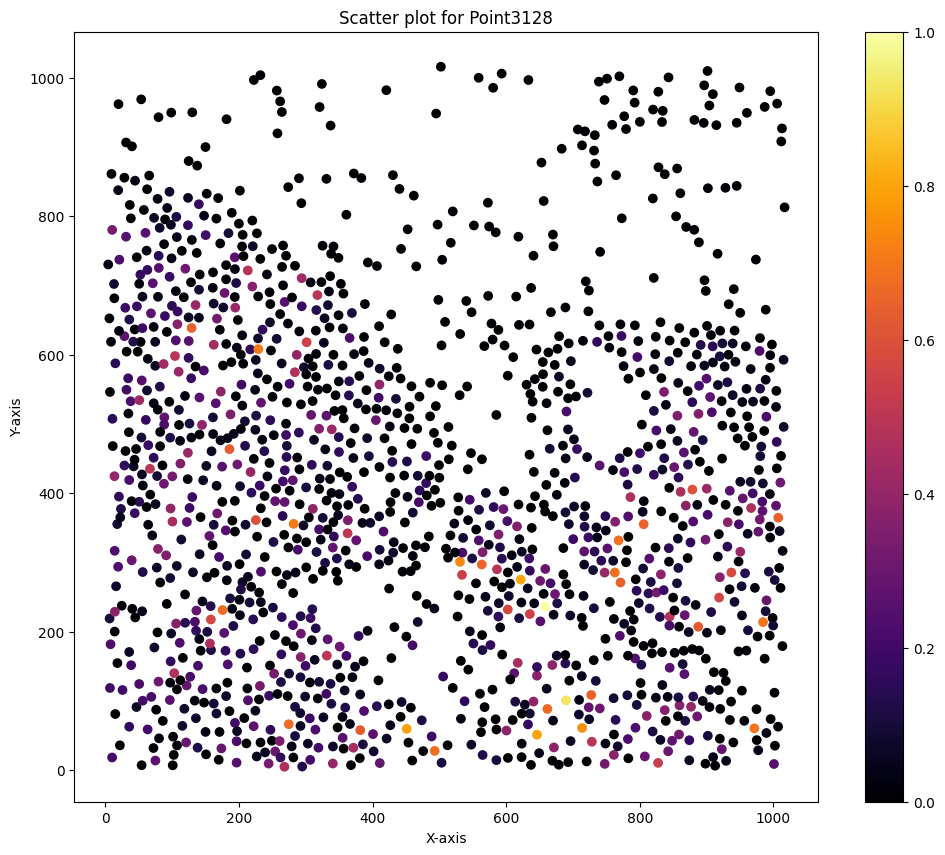

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

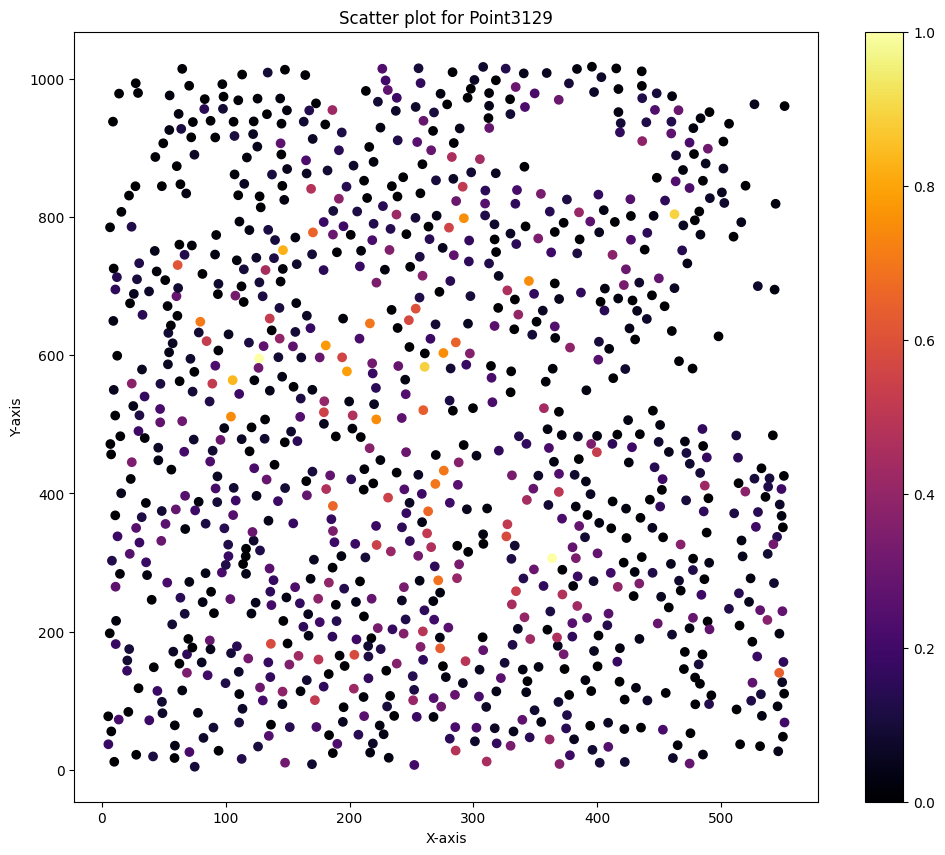

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

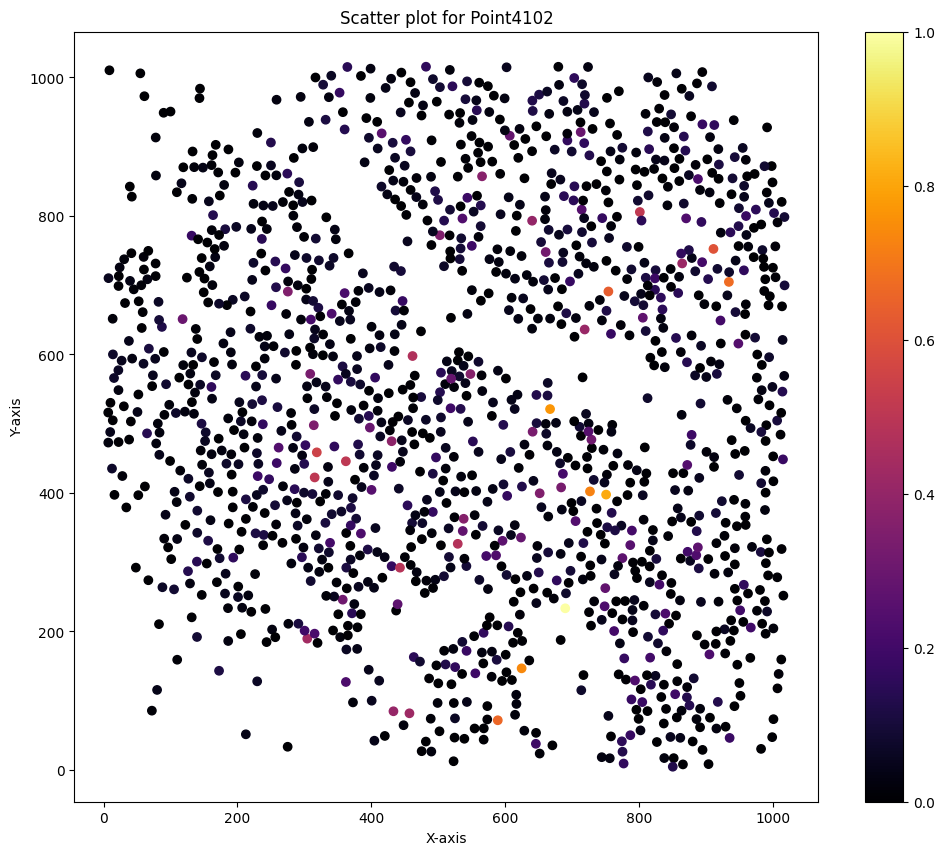

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

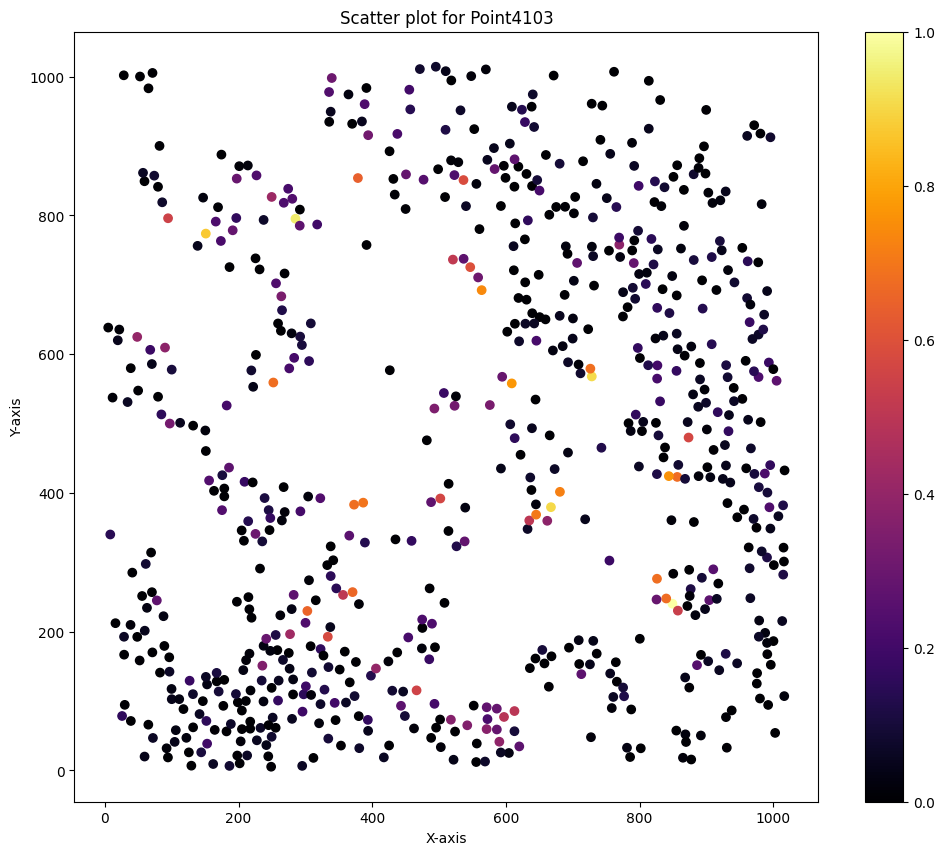

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

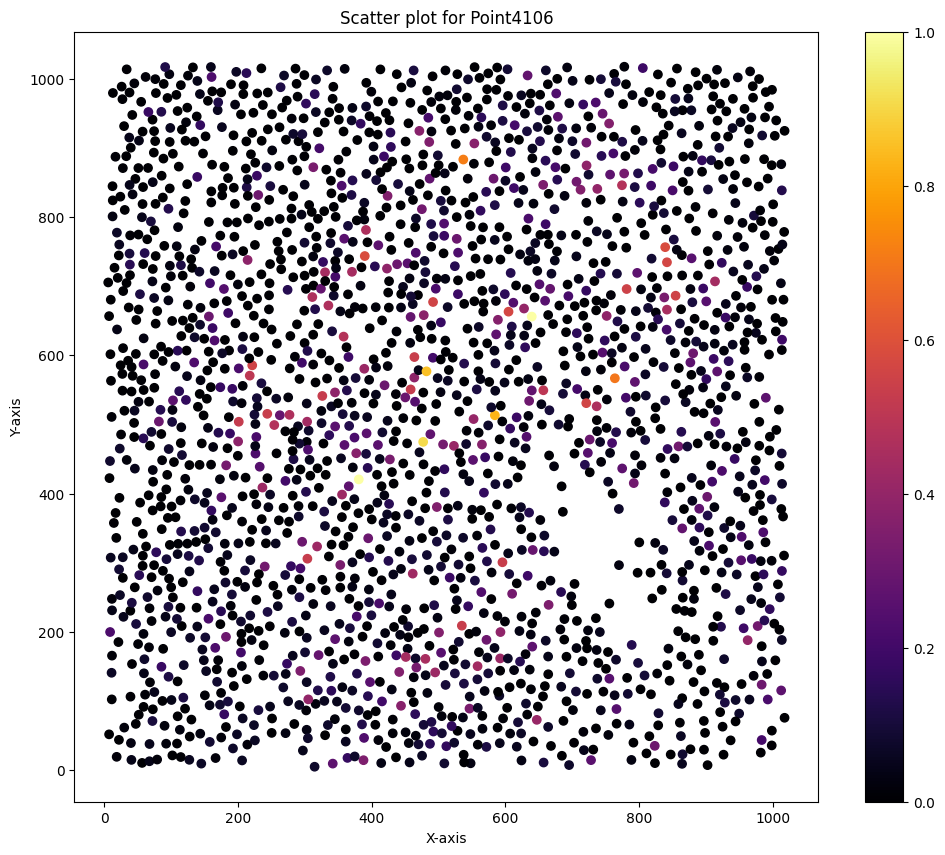

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

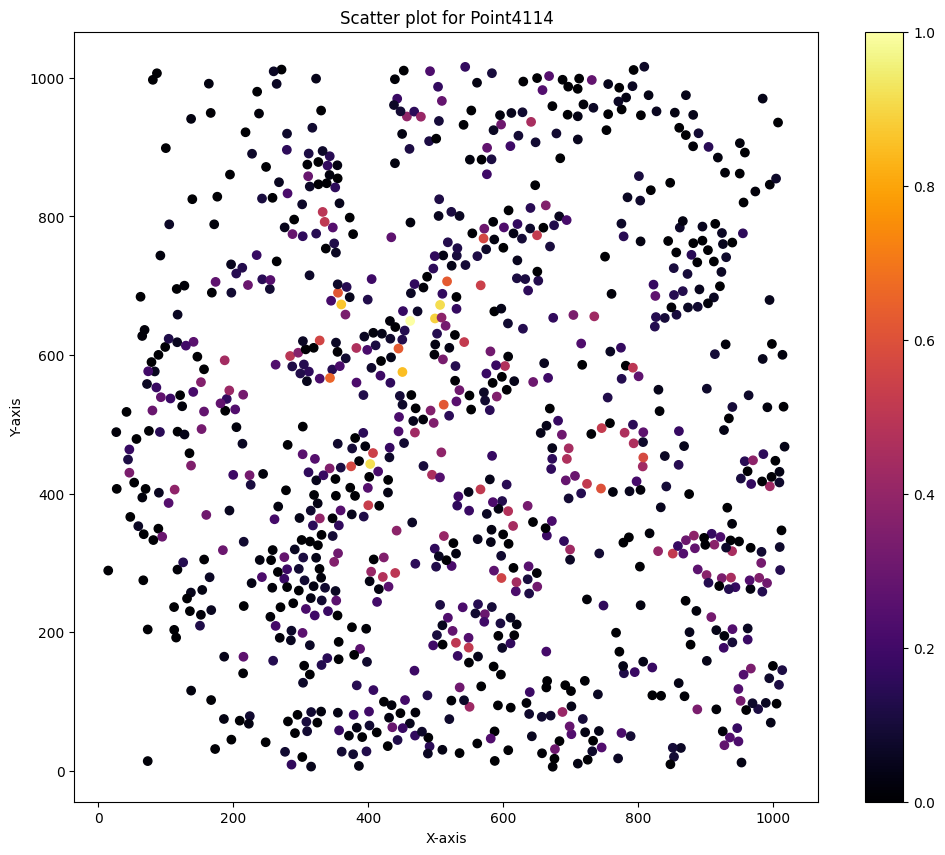

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

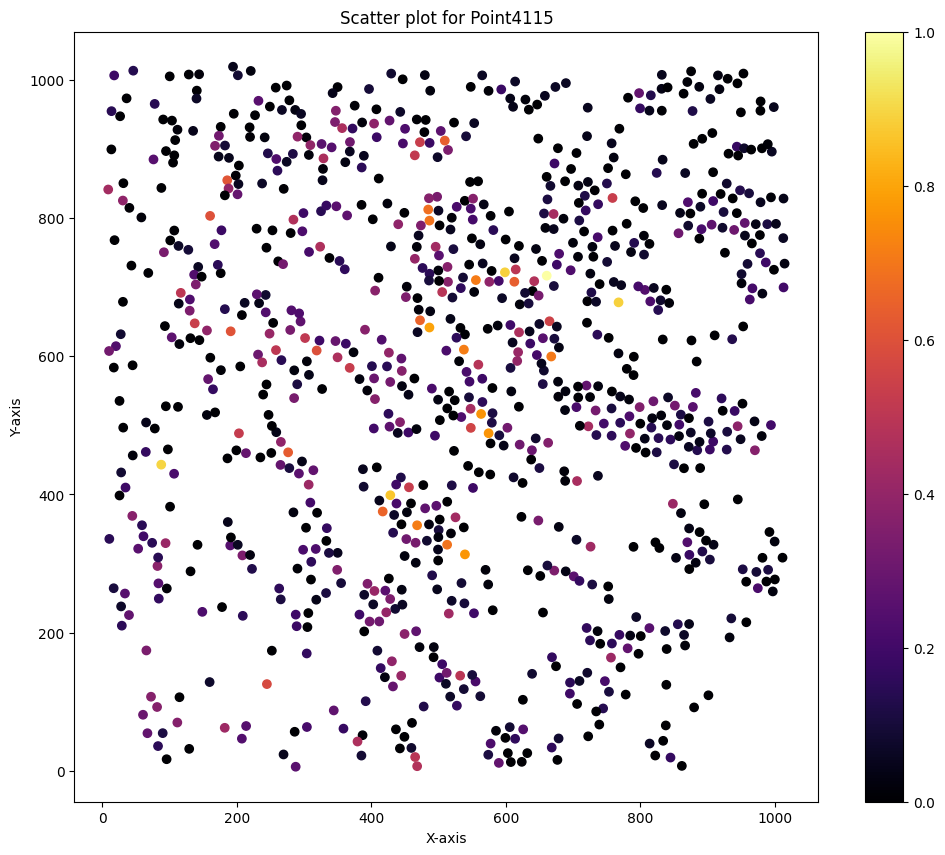

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

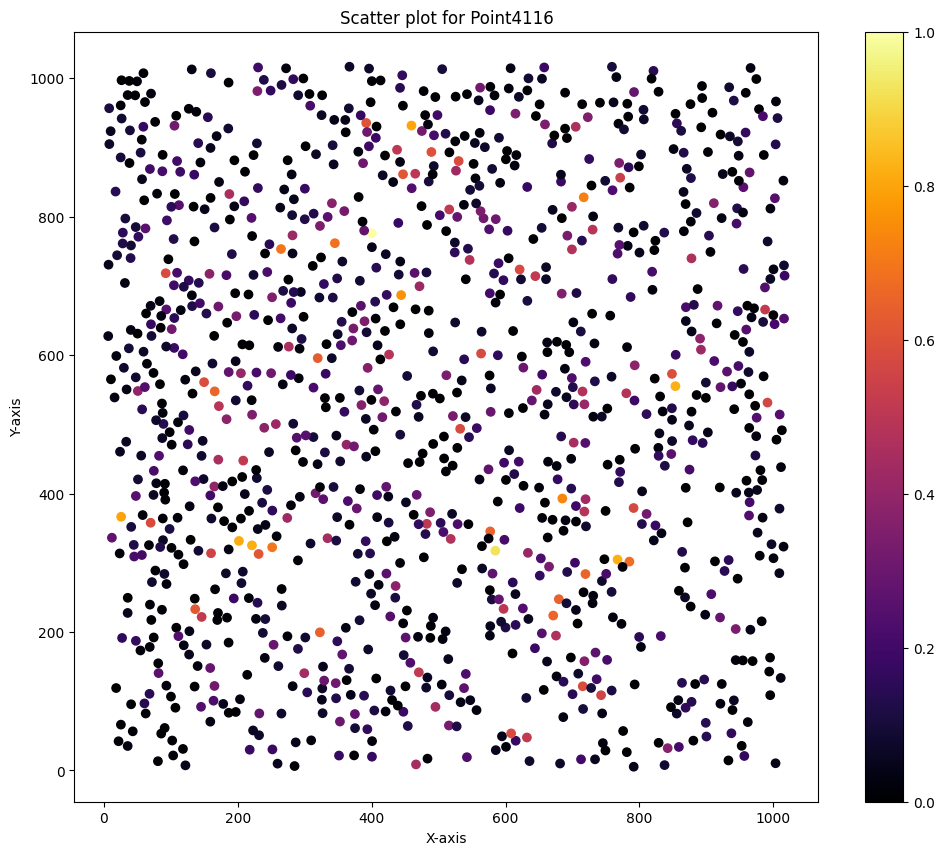

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

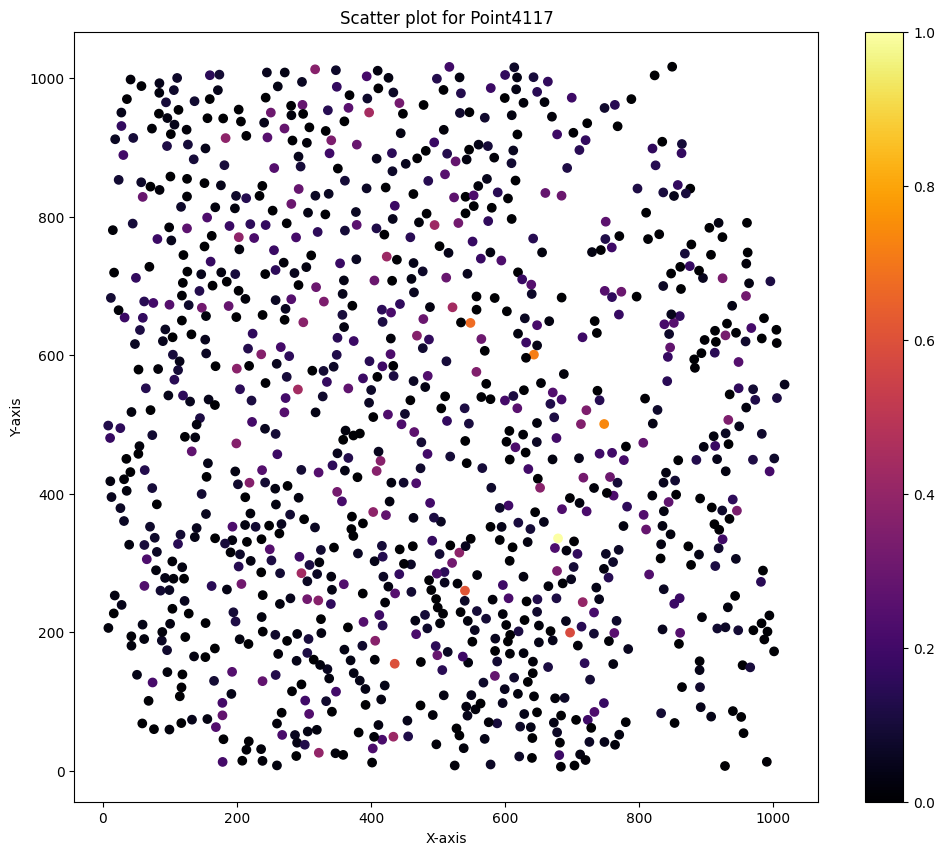

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

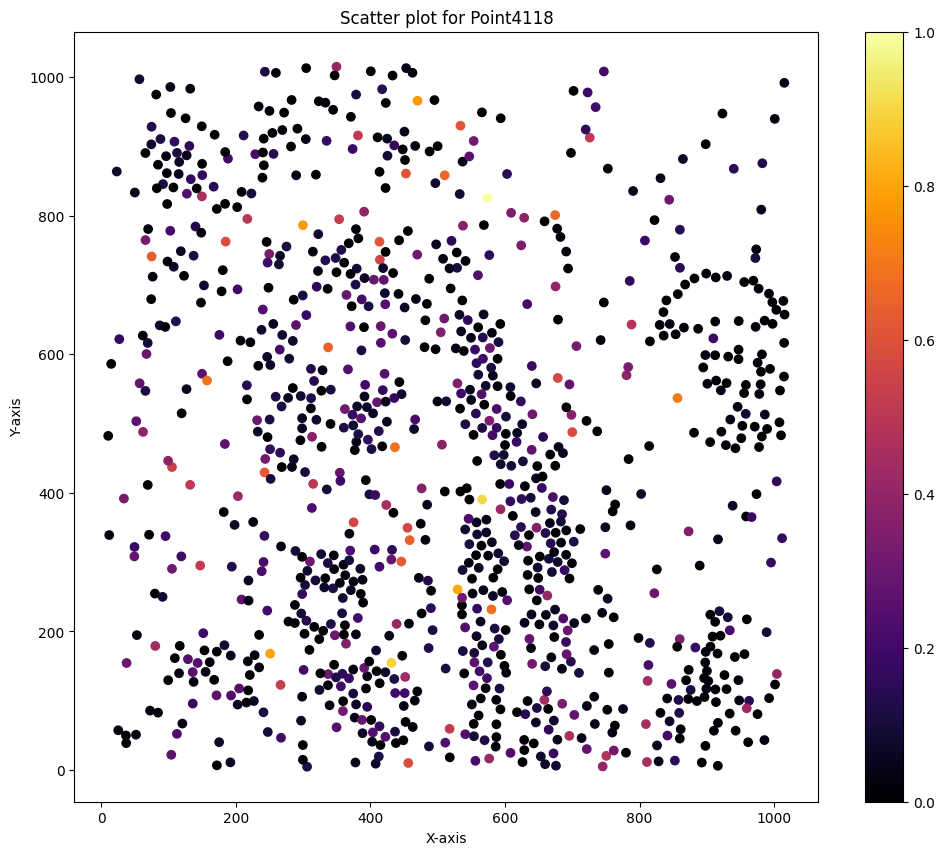

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

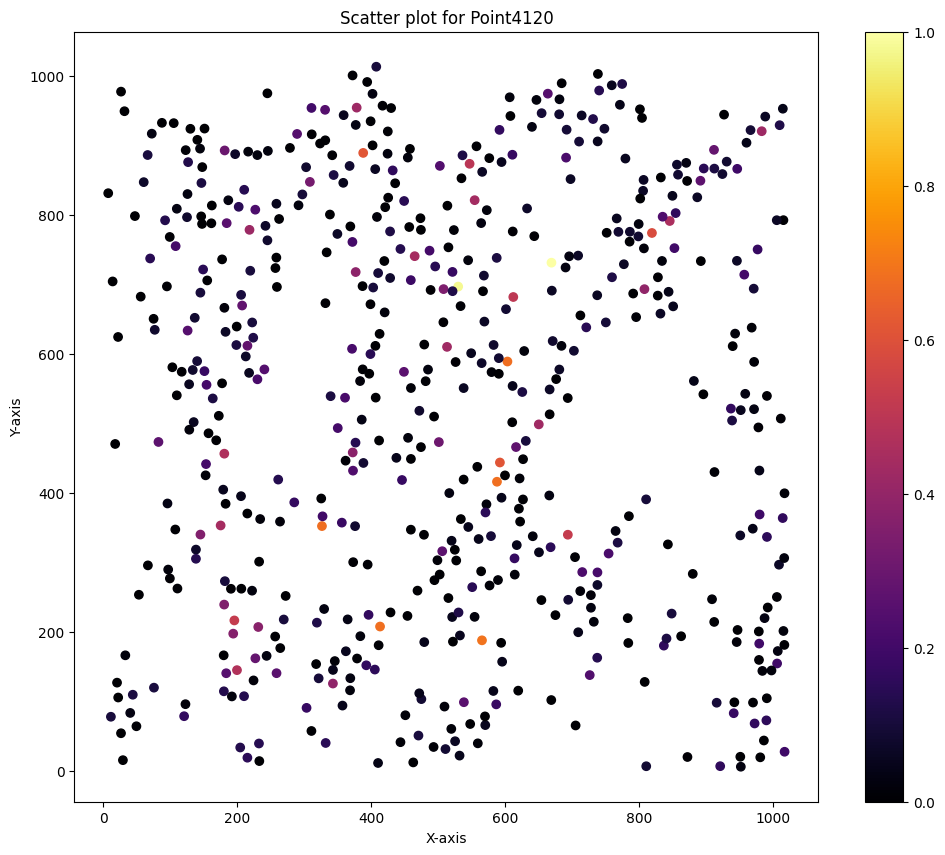

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

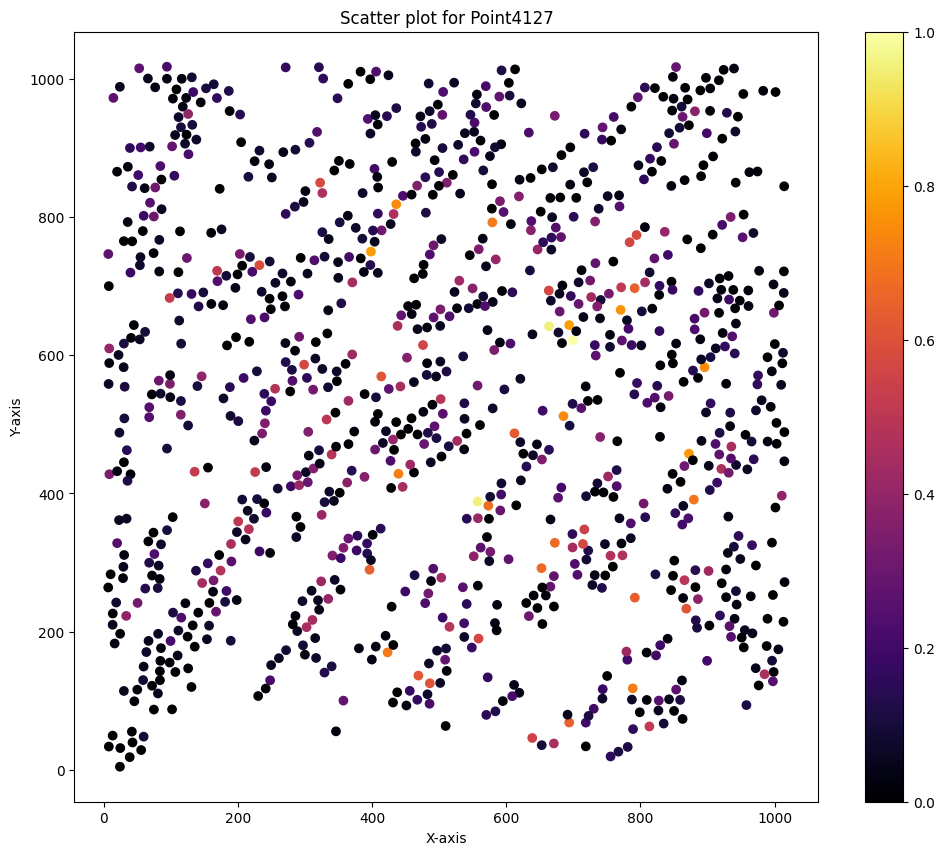

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

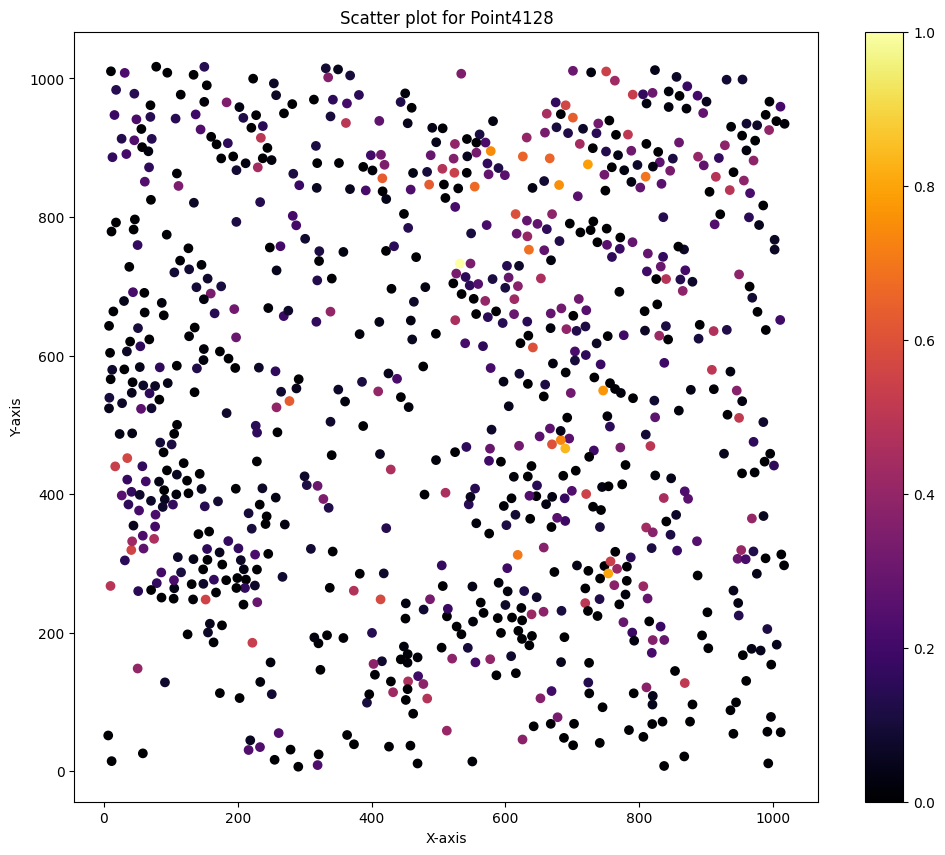

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

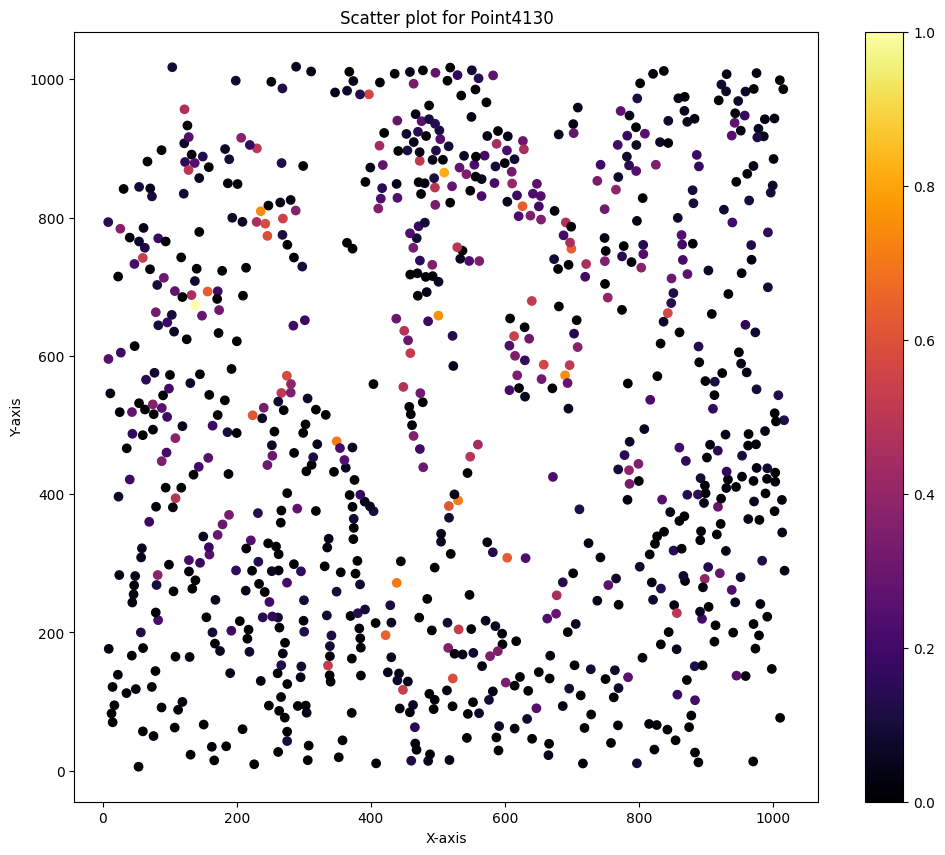

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

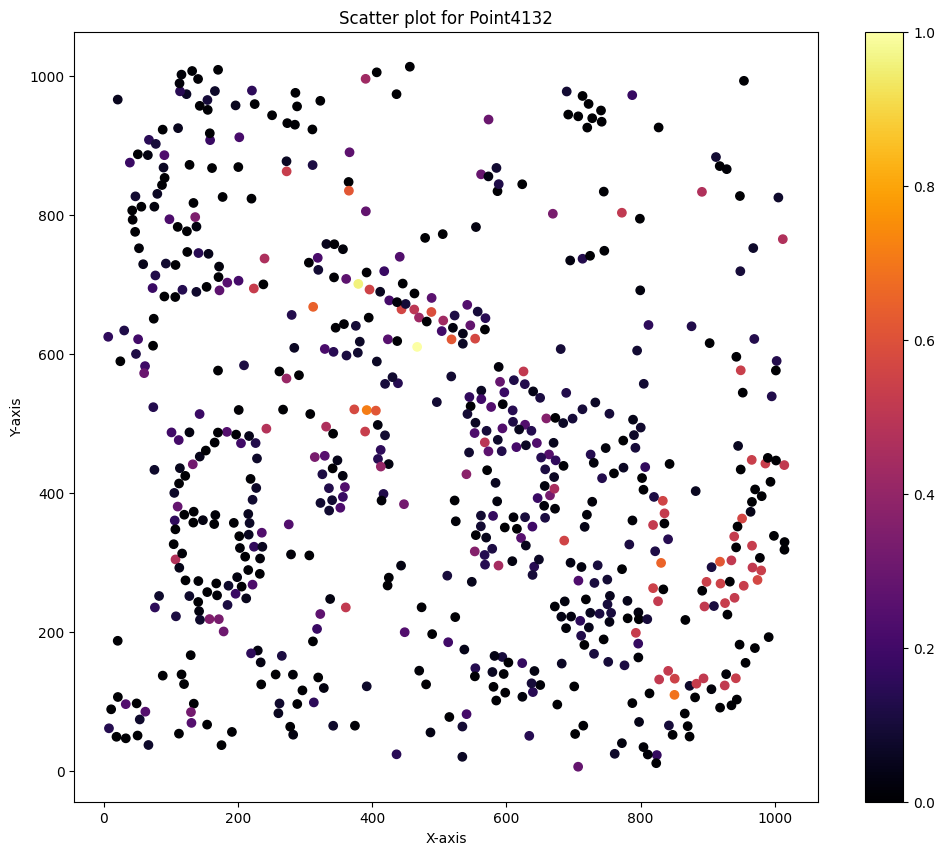

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

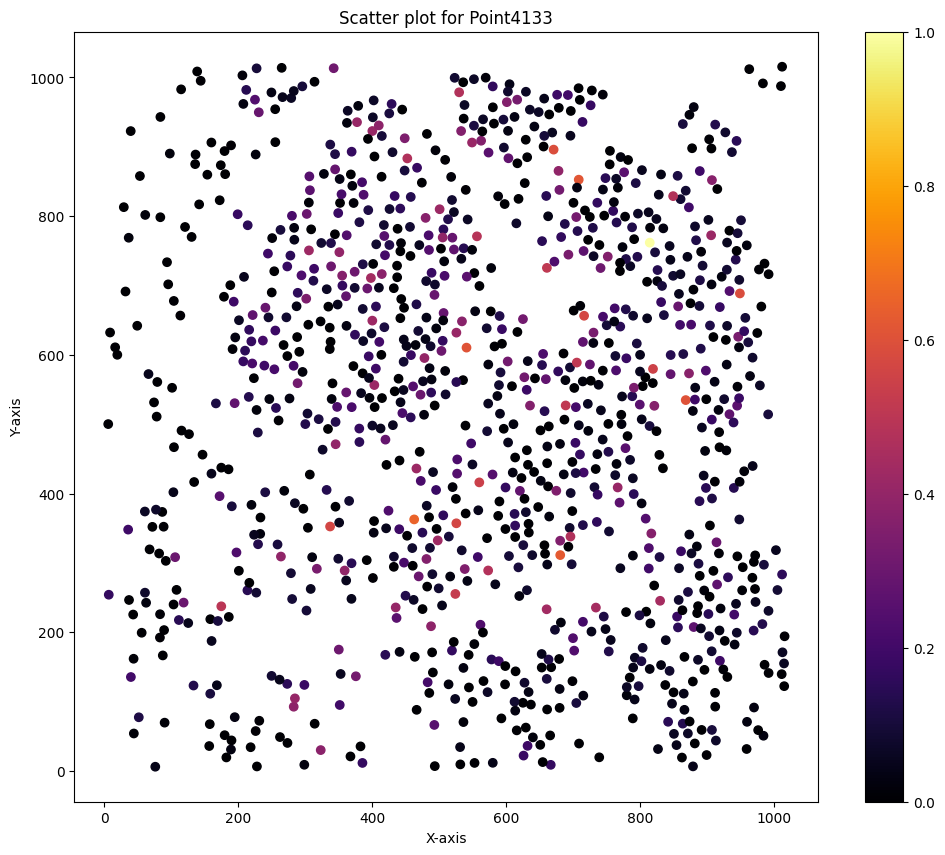

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

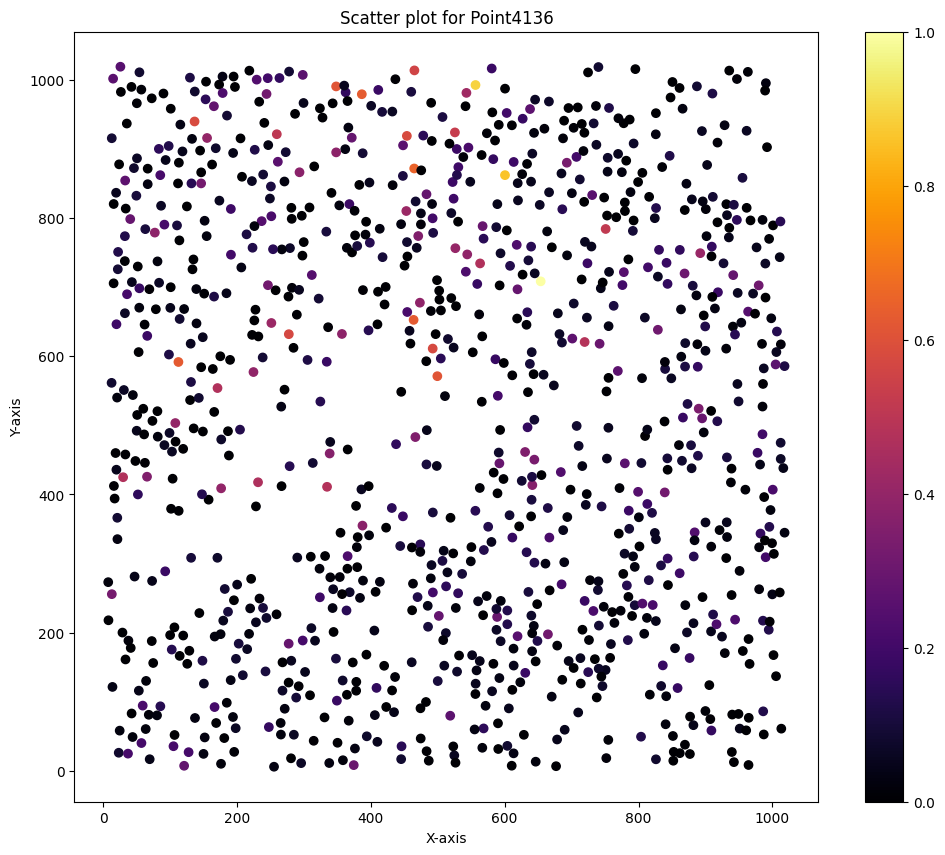

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

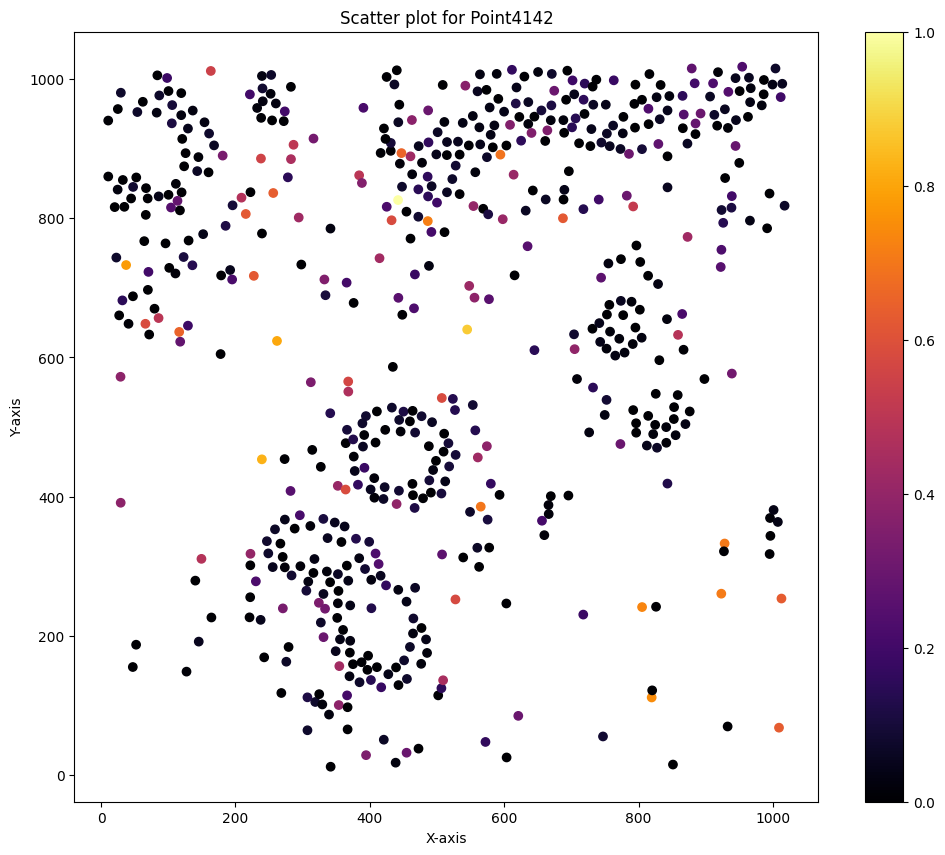

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

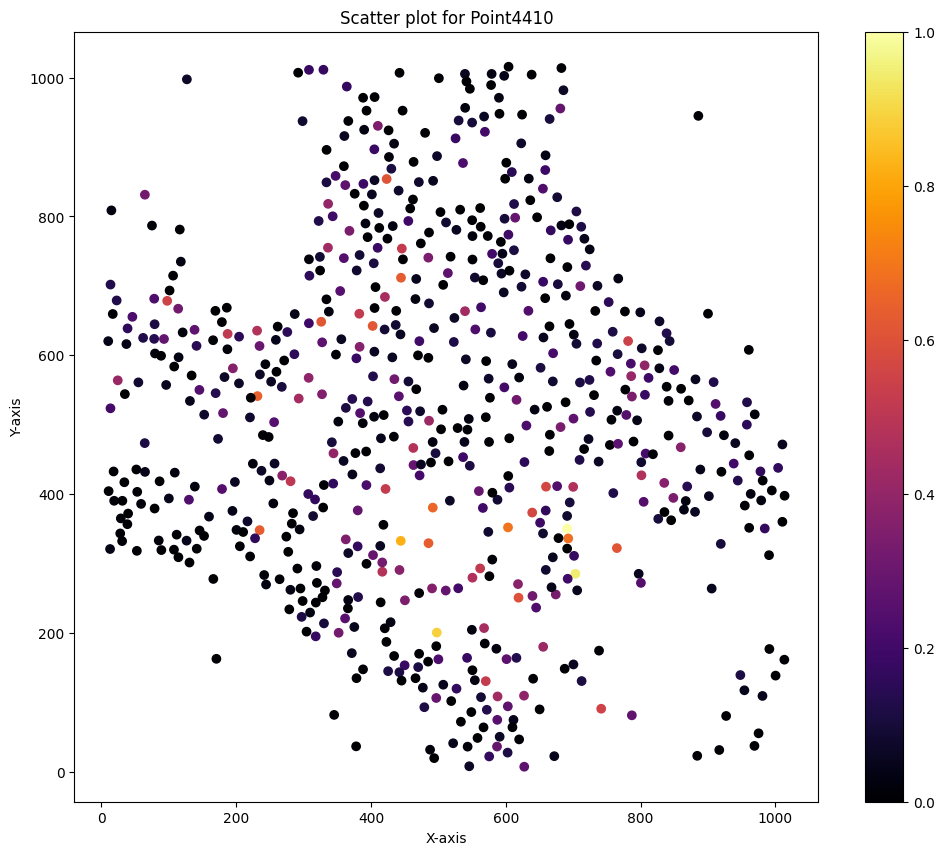

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

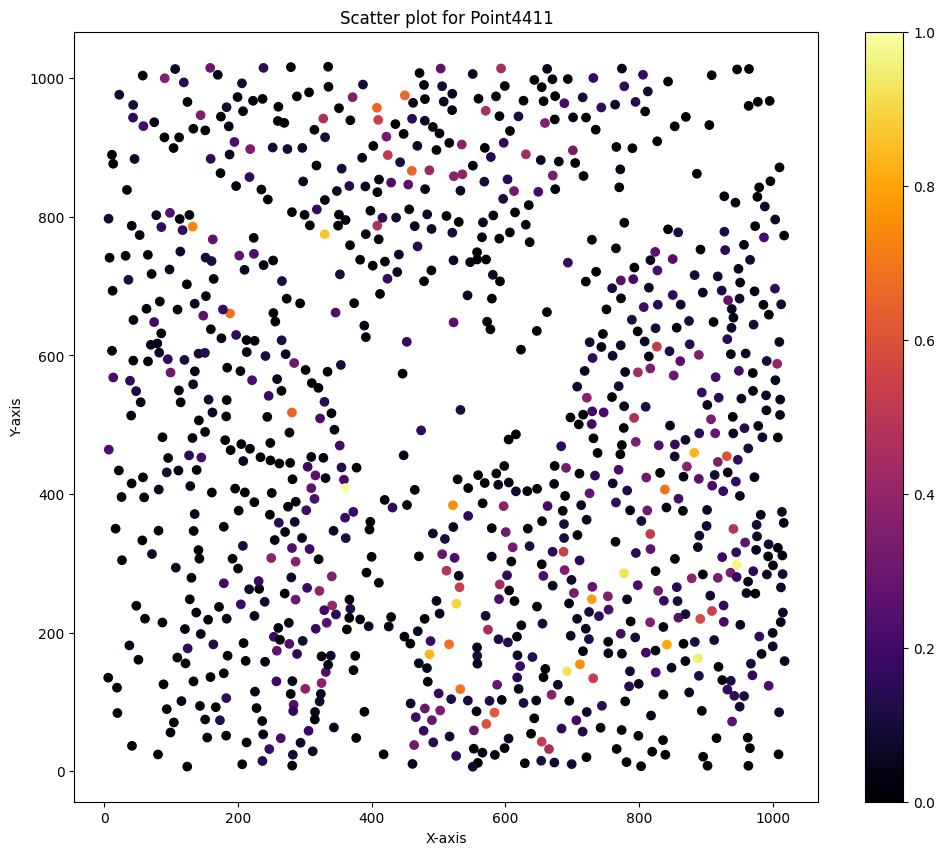

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

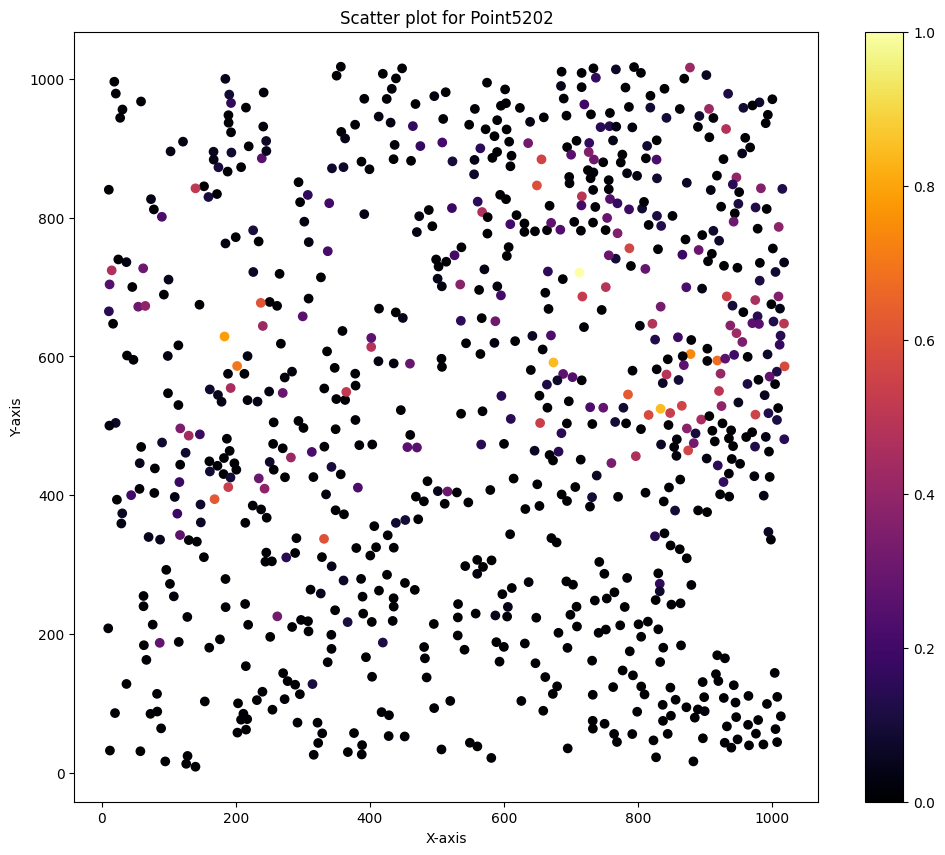

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

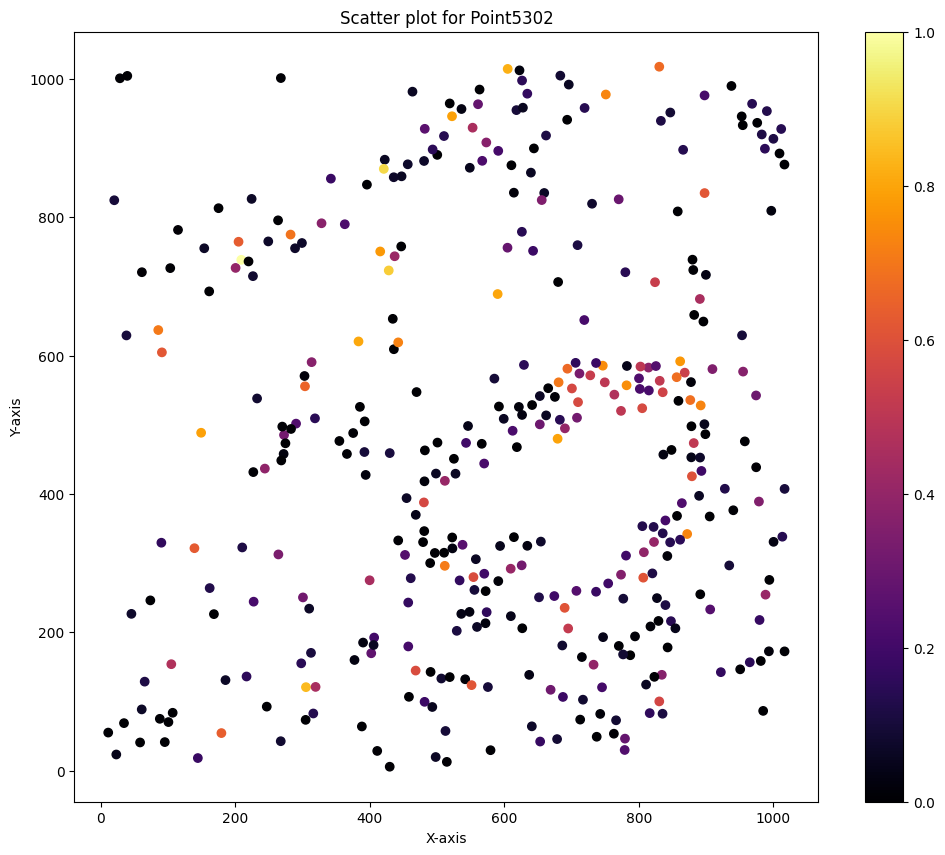

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

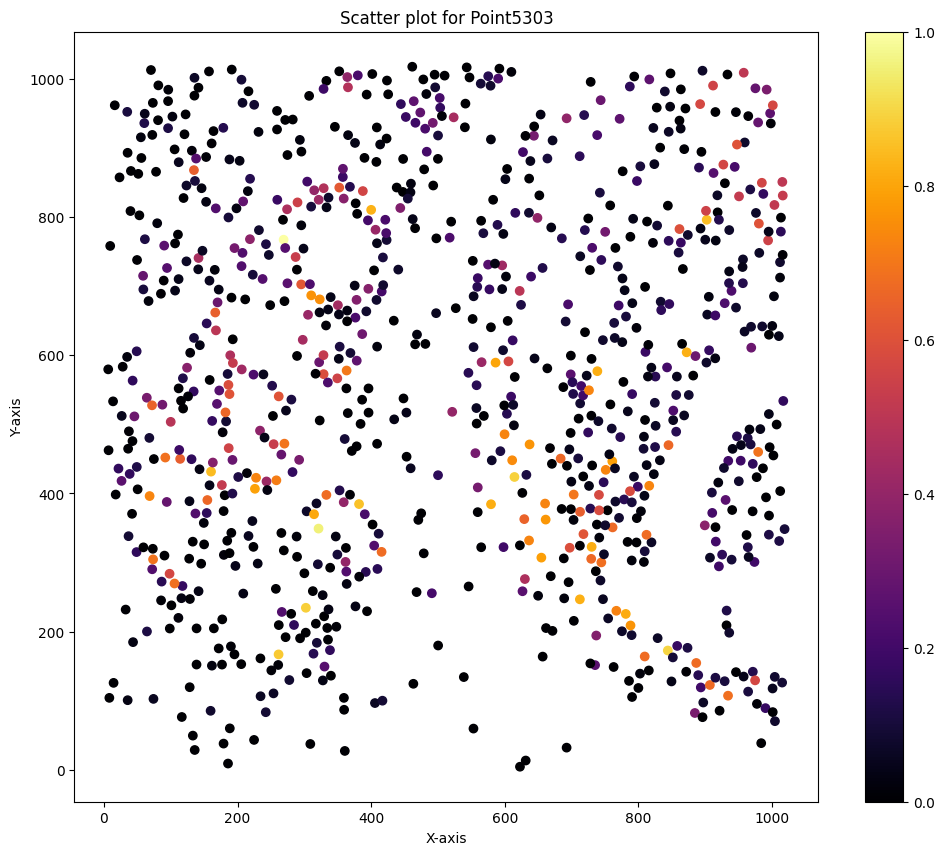

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

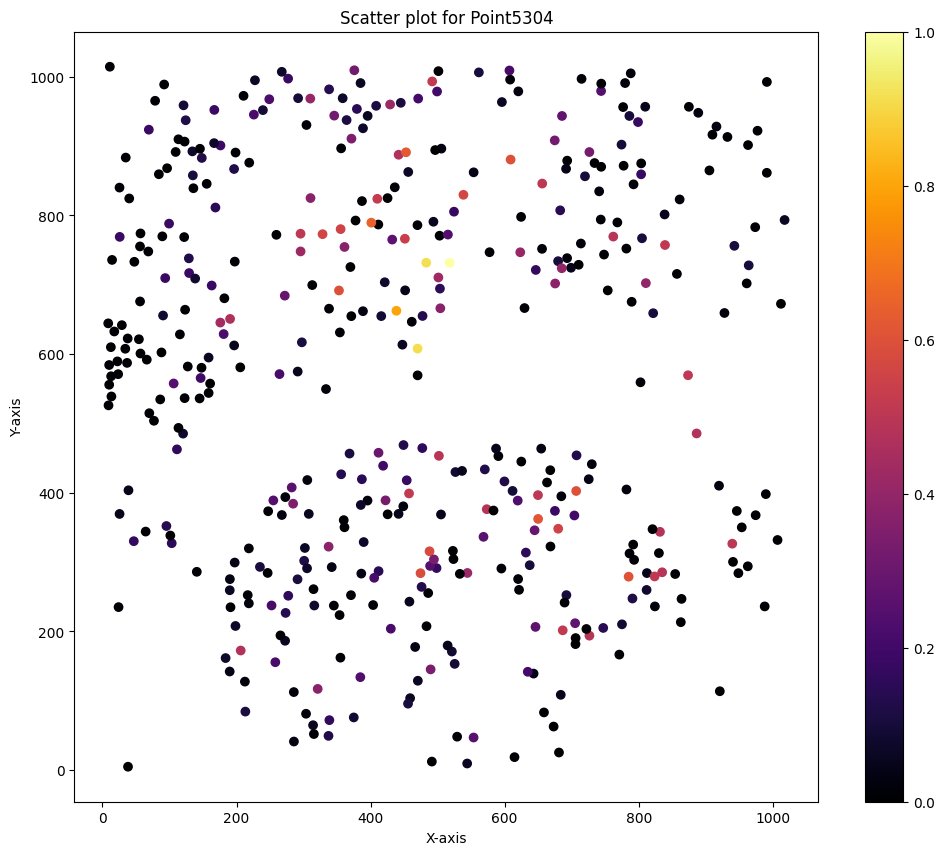

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

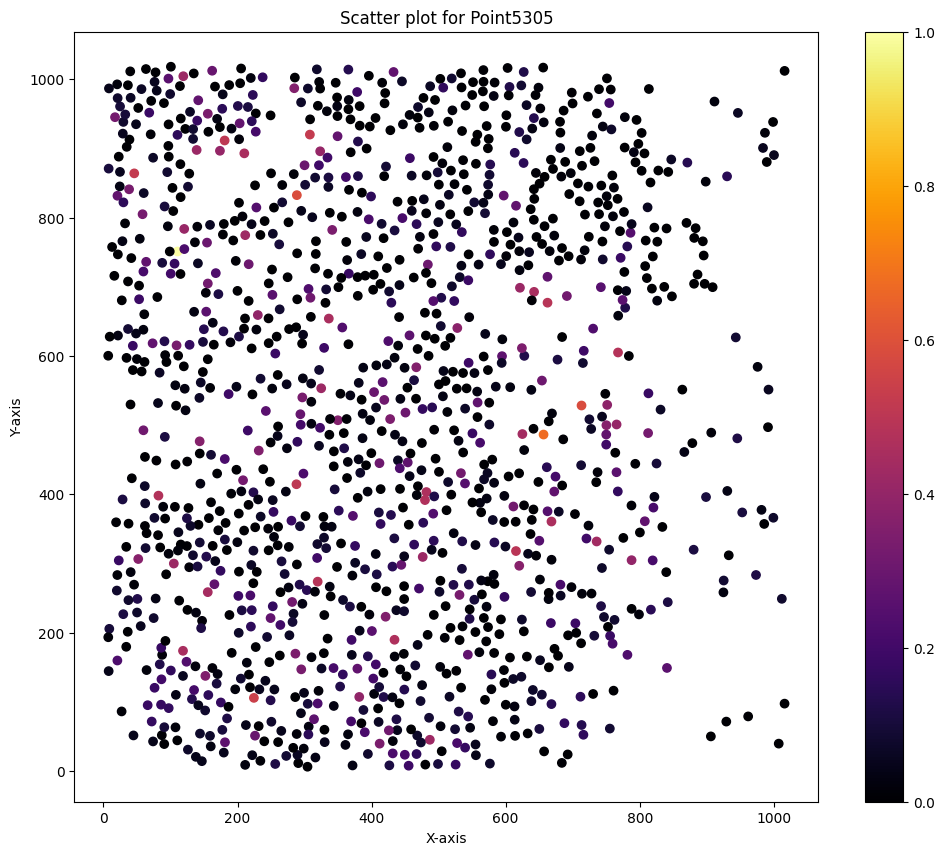

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

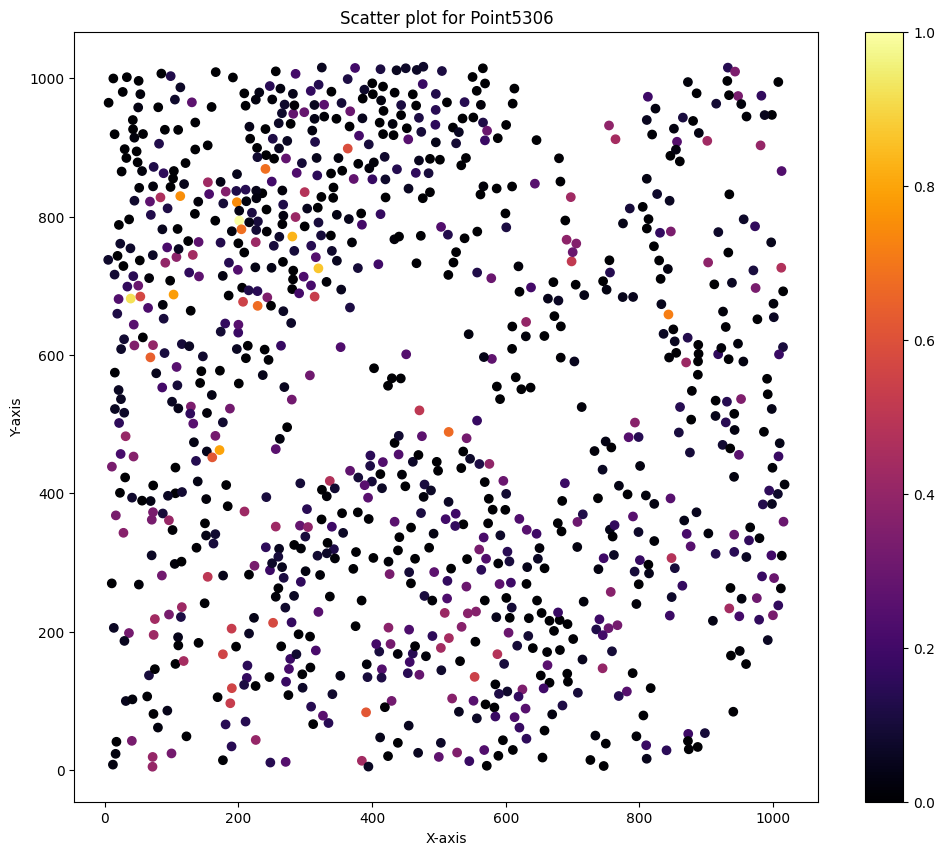

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

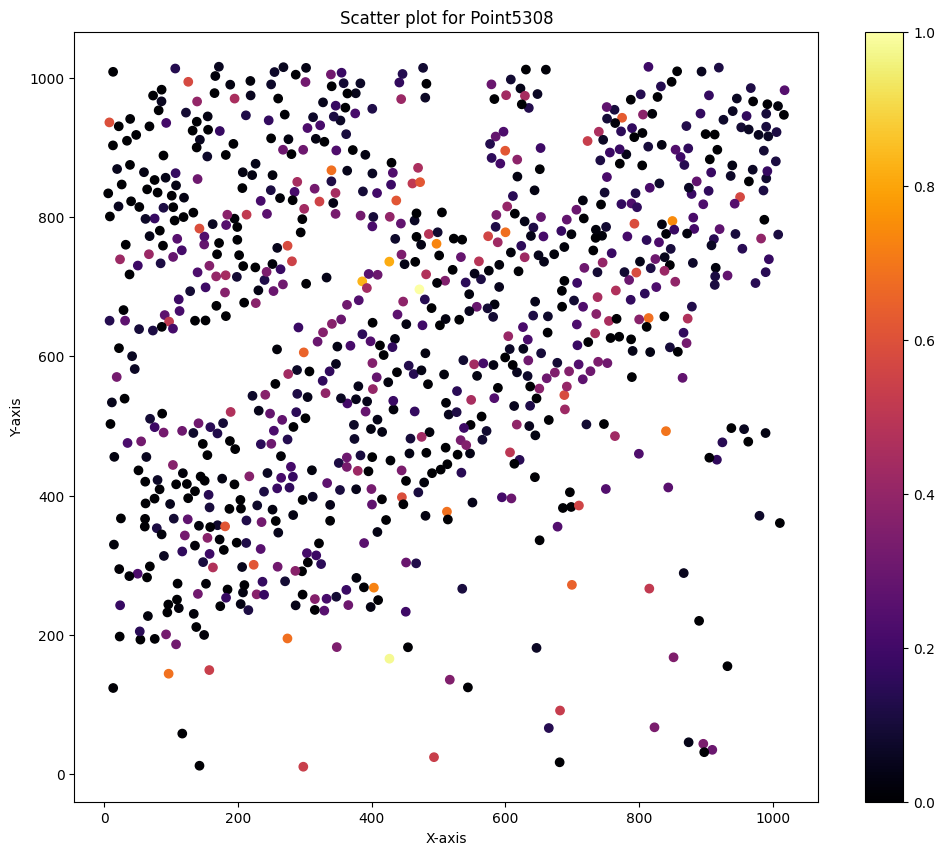

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

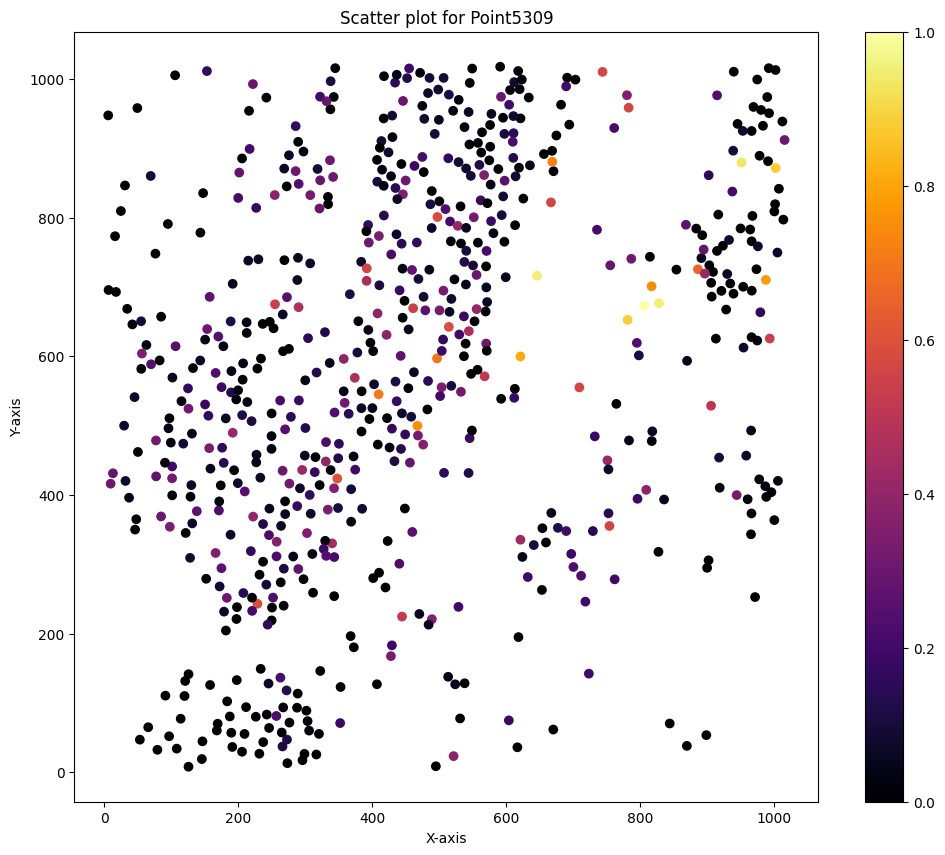

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

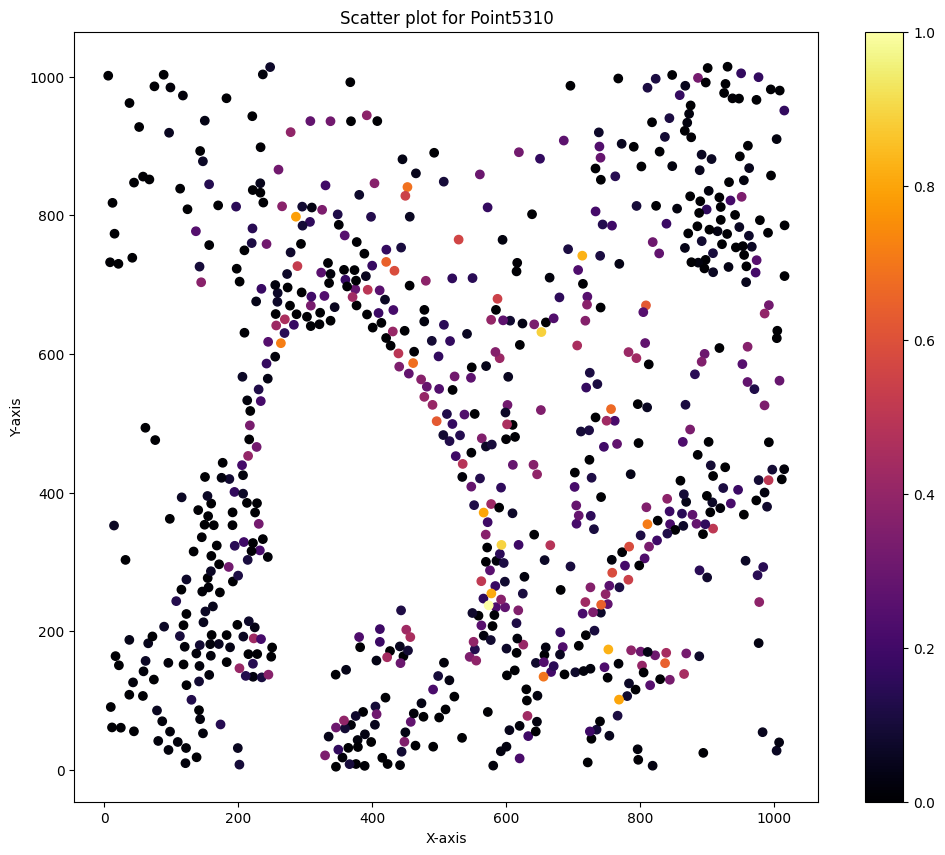

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

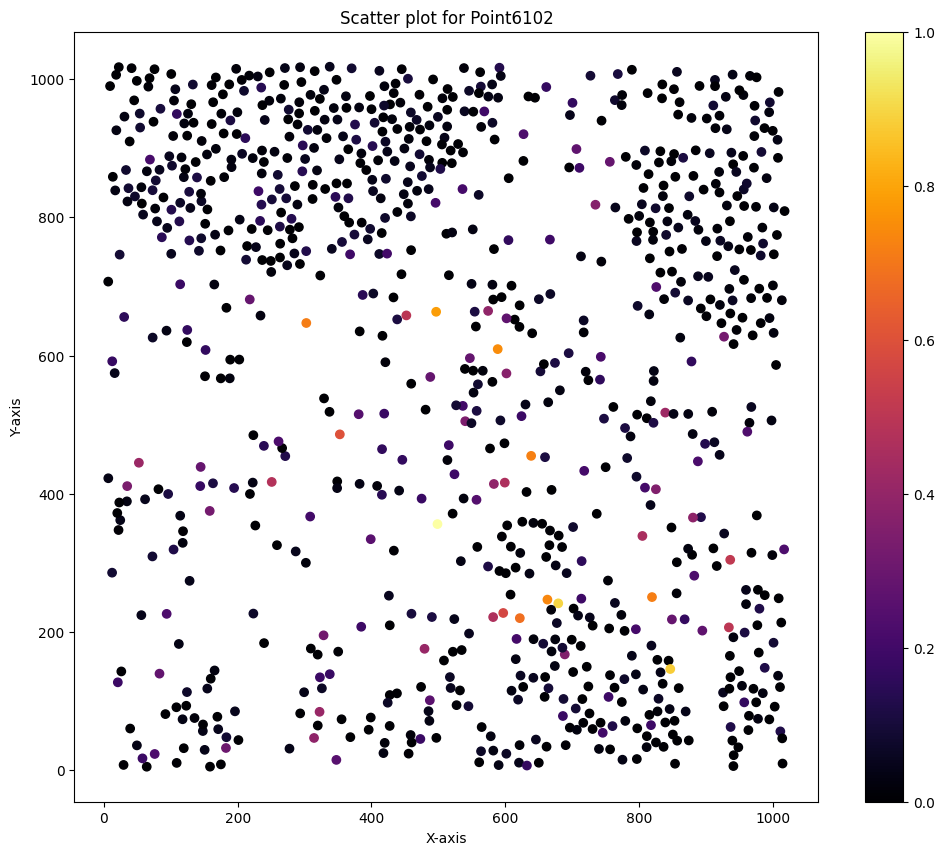

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

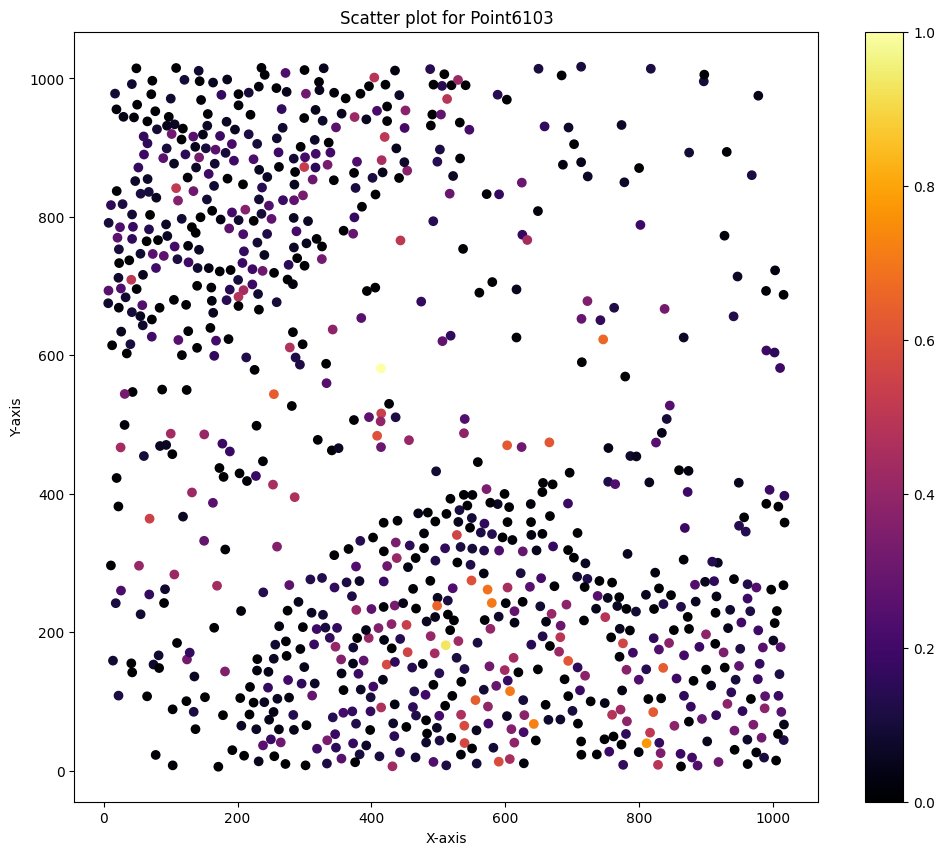

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

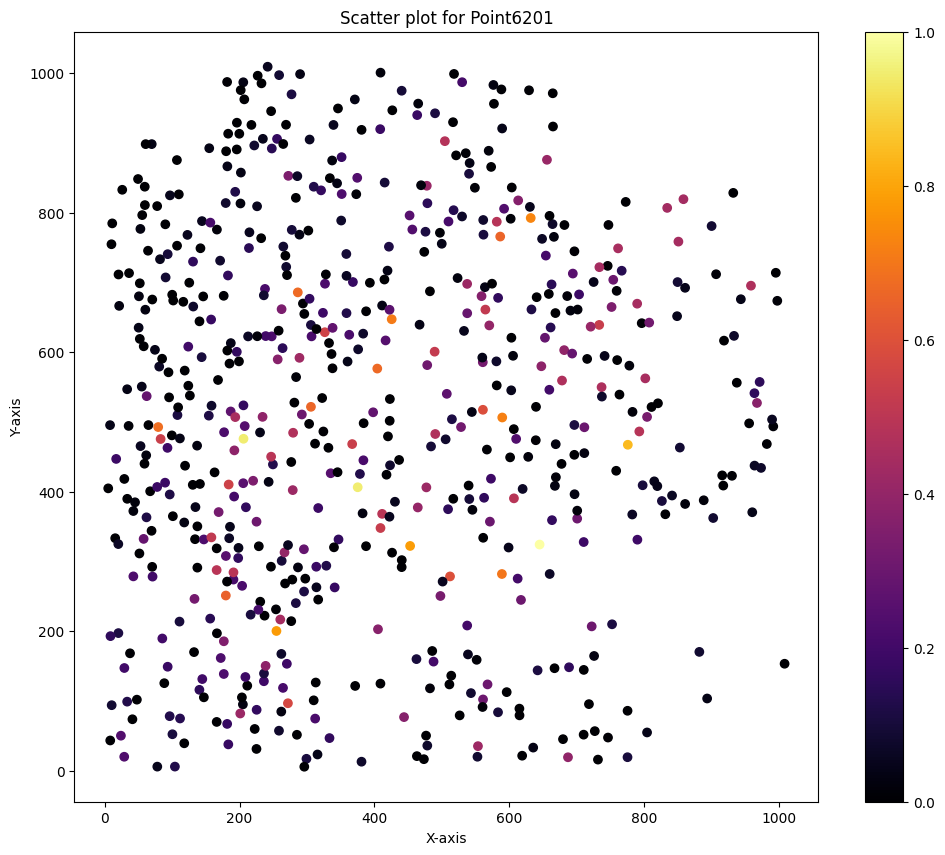

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

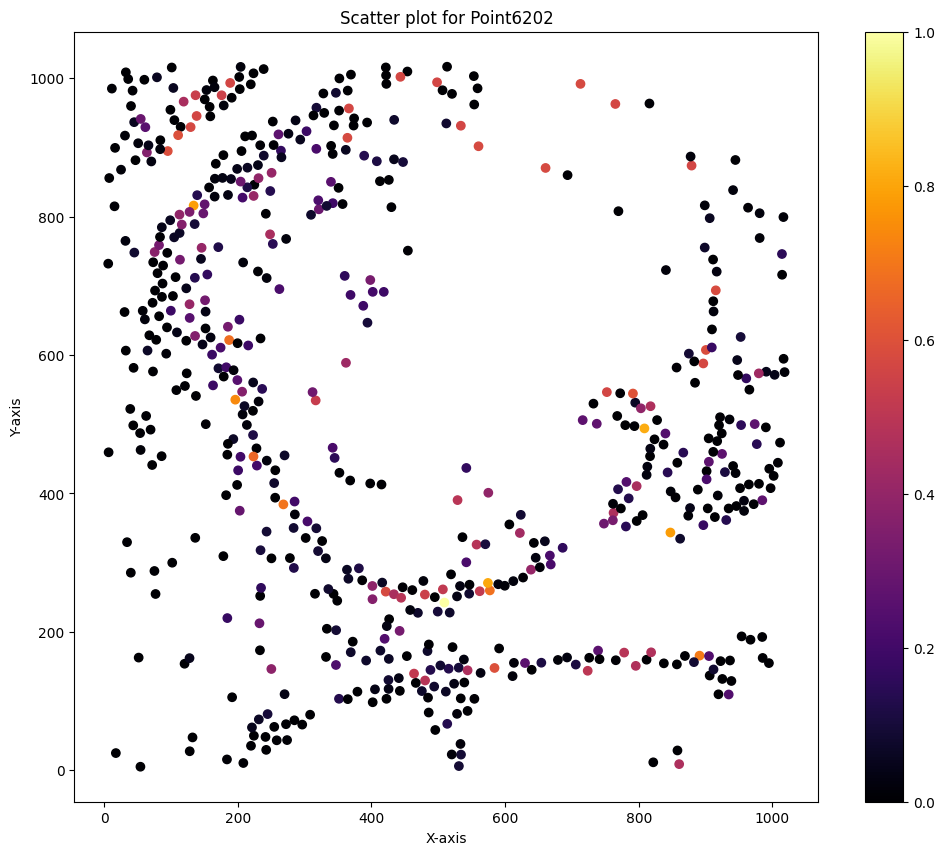

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

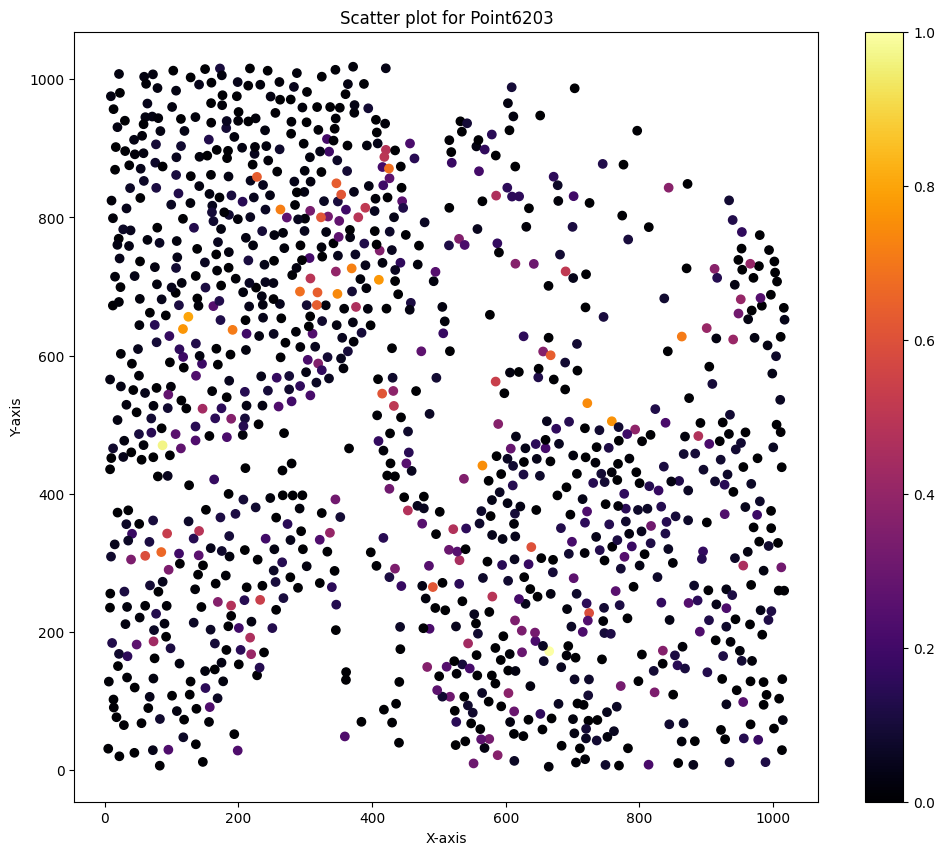

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

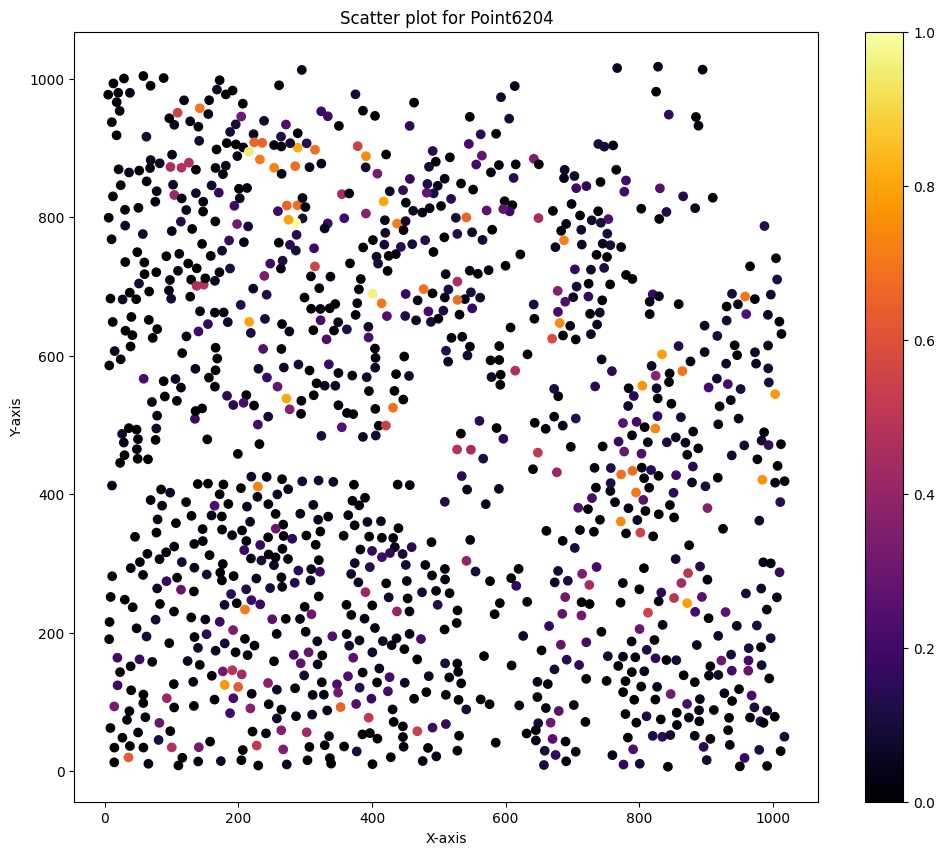

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

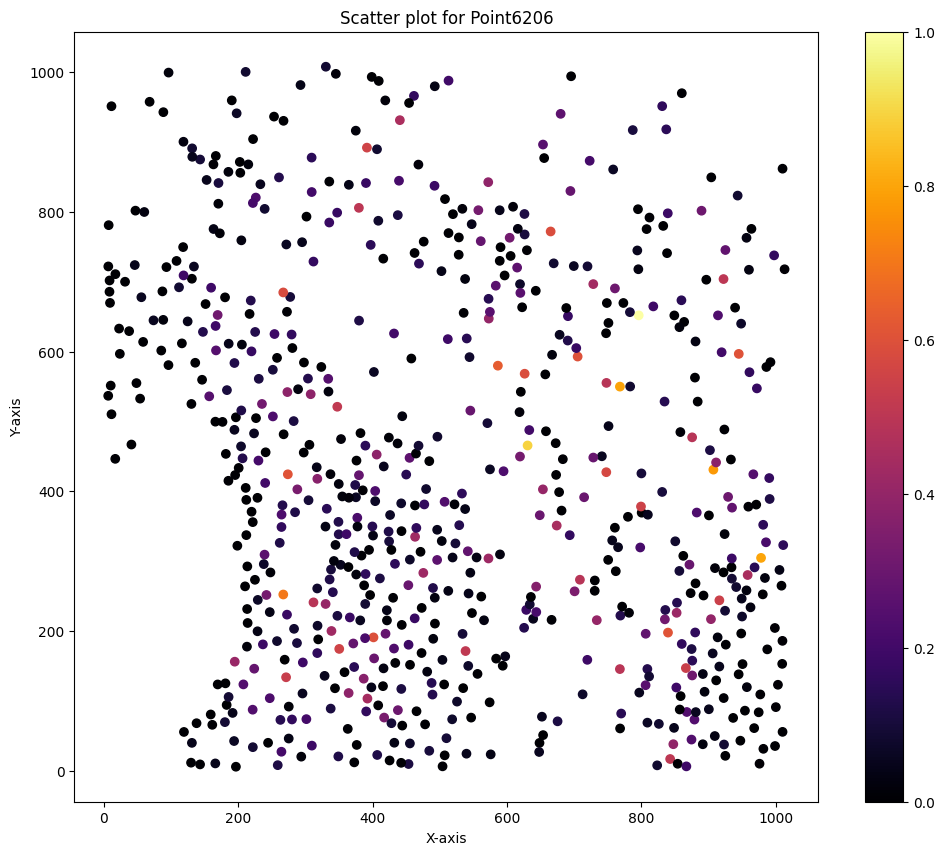

<ipython-input-40-8837ee6a0293>:156: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['score'] = scores


<Figure size 640x480 with 0 Axes>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import os

# Load the 'roi' values from the CSV file
data_1 = pd.read_csv("/content/drive/MyDrive/GIS/Breast Cancer Sim/cell_table_size_normalized.csv")
unique_rois = data_1['fov'].unique()

# Iterate through each 'roi' value
for roi in unique_rois:
    # Load data specific to the current 'roi'
    data1 = data_1[data_1['fov'] == roi]
    X = data1["centroid-0"].values
    Y = data1["centroid-1"].values

    # Load intervals specific to the current 'roi' from a text file
    matching_files = [file for file in os.listdir('/content/drive/MyDrive/GIS/Breast Cancer Sim_new') if file.startswith(roi) and file.endswith('.txt')]
    filename = os.path.join('/content/drive/MyDrive/GIS/Breast Cancer Sim_new', matching_files[0])

    with open(filename, 'r') as file:
        lines = [line.strip() for line in file if line.strip()]

    data_dict = {}
    process_lines = False

    # Process each line
    for line in lines:
        if 'n: 1' in line:
            process_lines = True
            continue

        if not process_lines:
            continue

        if line[0] == '[':
            # Extract the part before ':' as a string
            list1_str = line.split(':')[0]
            boundary = line.split(':')[1].strip()

            # Extract the numbers from list1_str
            list1 = [float(num) for num in list1_str.strip('[)').split(',')]

            # Add the list to the dictionary
            data_dict[tuple(list1)] = boundary

    threshold = 0

    Loop = []
    Time = []

    max_first_element = max(list1[0] for list1 in data_dict.keys())


    for list1, boundary in data_dict.items():
        if list1[1] == np.inf:
            list1 = (list1[0], max_first_element)
        time = list1[1] - list1[0]
        if time >= 0:
            Loop.append([boundary])
            Time.append(time)

    '''
    for list1, boundary in data_dict.items():
        if list1[1] == np.inf:
            continue
        else:
            time = list1[1] - list1[0]
            if time >= 0:
              Loop.append([boundary])
              Time.append(time)
    '''



    def process_input_string(input_string):
        # Use regular expressions to find the coordinate pairs and symbols
        items = re.findall(r'\[.*?\]|[-+*]', input_string)

        input_data = []
        sublist = []
        should_swap = False

        for item in items:
            if item.startswith('['):
                # Convert the coordinate pair string to a list of integers
                sublist = [int(coord) for coord in re.findall(r'\d+', item)]

                # Swap the values within the coordinate pair if required
                if should_swap:
                    sublist = [sublist[1], sublist[0]]

                input_data.extend(sublist)
            else:
                # Check for the symbol to determine whether to swap values
                should_swap = (item == '-')

        return input_data

    input_strings = Loop
    output = []
    for input_string in input_strings:
      output.append(set(process_input_string(input_string[0])))


    num_points = X.shape[0]
    score = [0]*num_points
    for i in range(len(output)):
      interval = output[i]
      value = Time[i]
      for j in interval:
        score[j]+=value


    def normalize_scores(scores):
        min_score = min(scores)
        max_score = max(scores)

        normalized_scores = [(score - min_score) / (max_score - min_score) for score in scores]

        return normalized_scores

    # Example scores
    scores = score

    # Normalize scores
    normalized_scores = normalize_scores(scores)

    # Create a scatter plot with color based on normalized scores
    plt.figure(figsize =(12,10))
    plt.scatter(X, Y, c=normalized_scores, cmap='inferno')
    plt.colorbar()

    # Customize the plot (add labels, title, etc. if needed)
    plt.xlabel('X-axis')
    plt.ylabel('Y-axis')
    plt.title(f'Scatter plot for {roi}')

    # Save the plot as an image file with a unique name for each 'roi'
    image_filename = f'/content/drive/MyDrive/GIS/Breast Cancer Sim_new/{roi}_scatter_plot_sim_selected.png'
    plt.savefig(image_filename)

    # Show the plot if needed (optional)
    plt.show()

    # Clear the current plot to prepare for the next 'roi'
    plt.clf()

    # Read the CSV file and filter the data
    data_1 = pd.read_csv("/content/drive/MyDrive/GIS/Breast Cancer Sim/cell_table_size_normalized.csv")
    data1 = data_1[data_1['fov'] == roi ]

    # Create a new column 'score' with your list of scores
    scores = normalized_scores  # Replace with your actual list of scores
    data1['score'] = scores

    # Sort the data by the 'score' column in descending order
    data1 = data1.sort_values(by='score', ascending=False)

    # Save the sorted DataFrame to a new CSV file
    data1.to_csv(f"/content/drive/MyDrive/GIS/Breast Cancer Sim_new/{roi}_sorted_output_sim_selected.csv", index=False)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


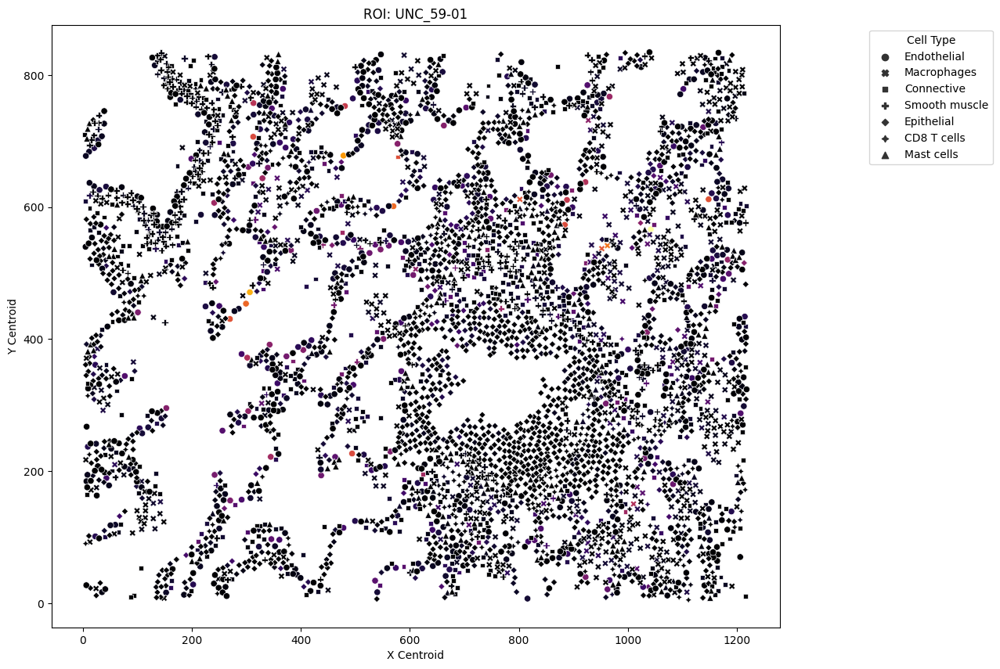

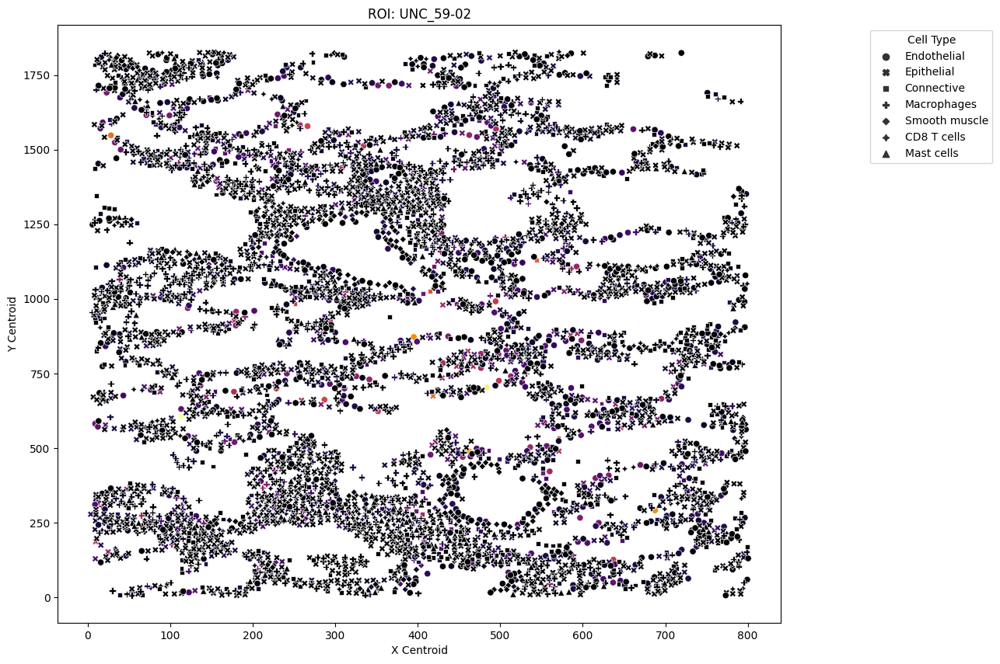

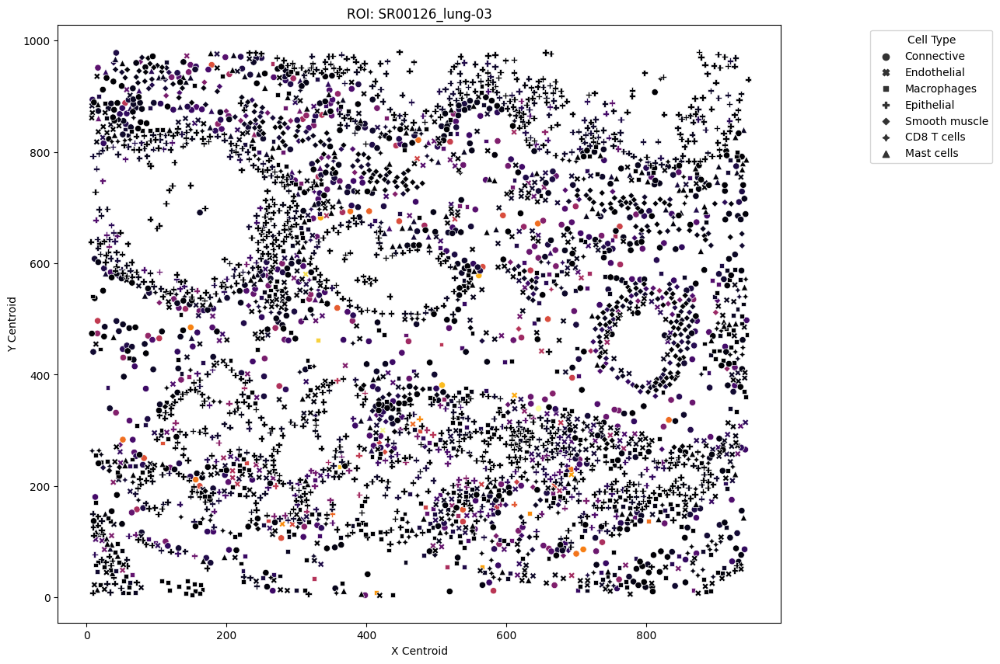

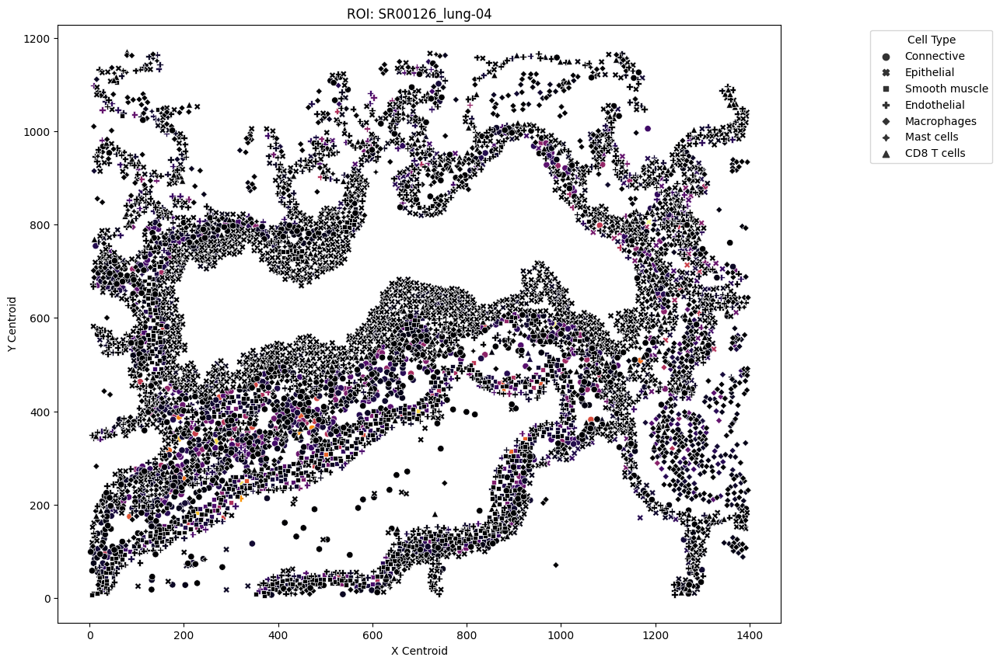

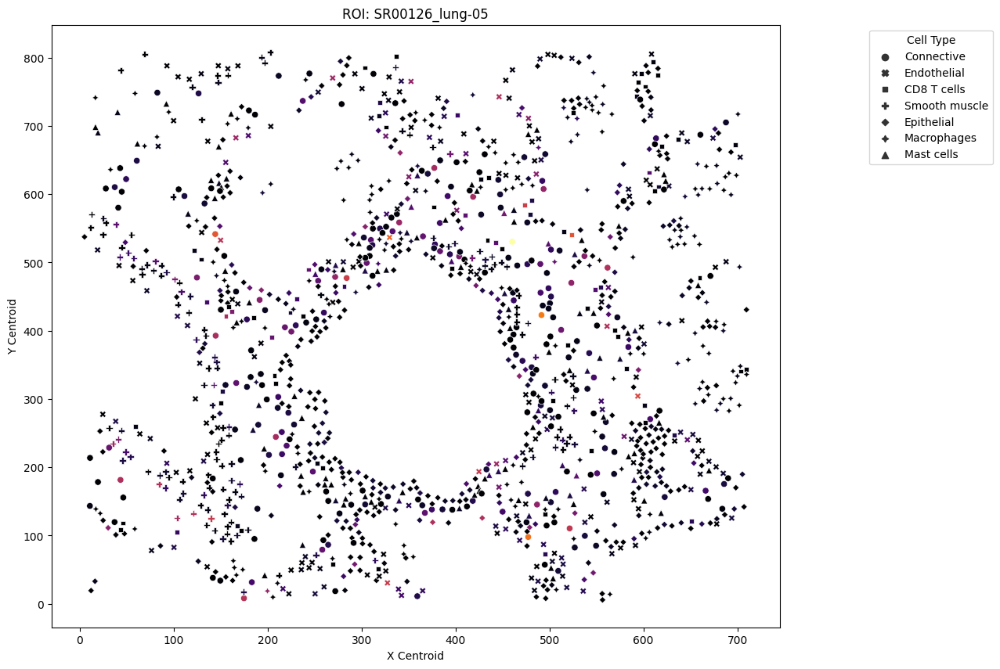

...

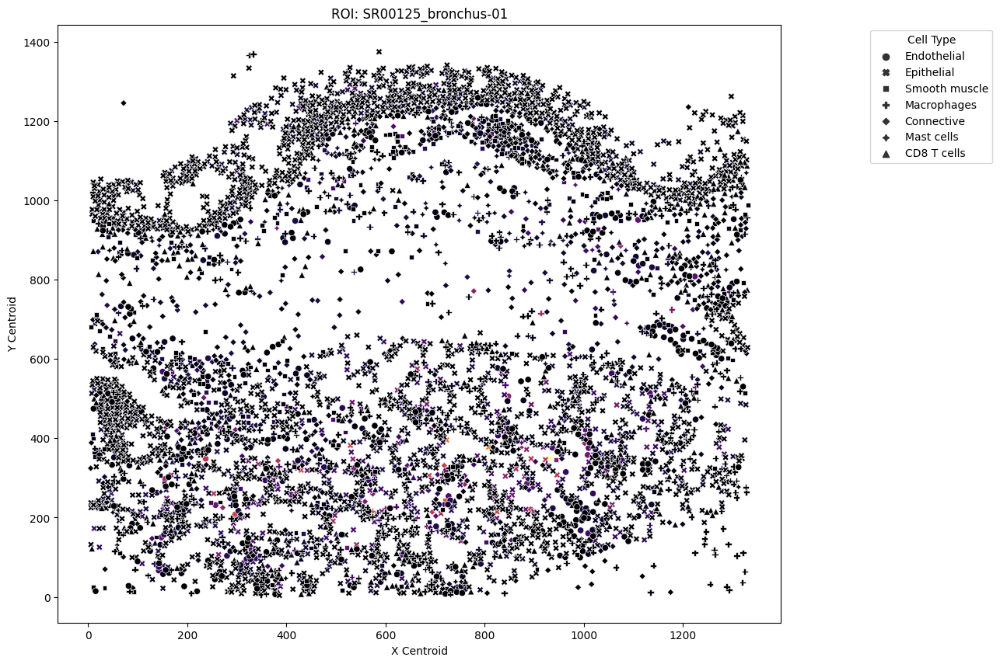

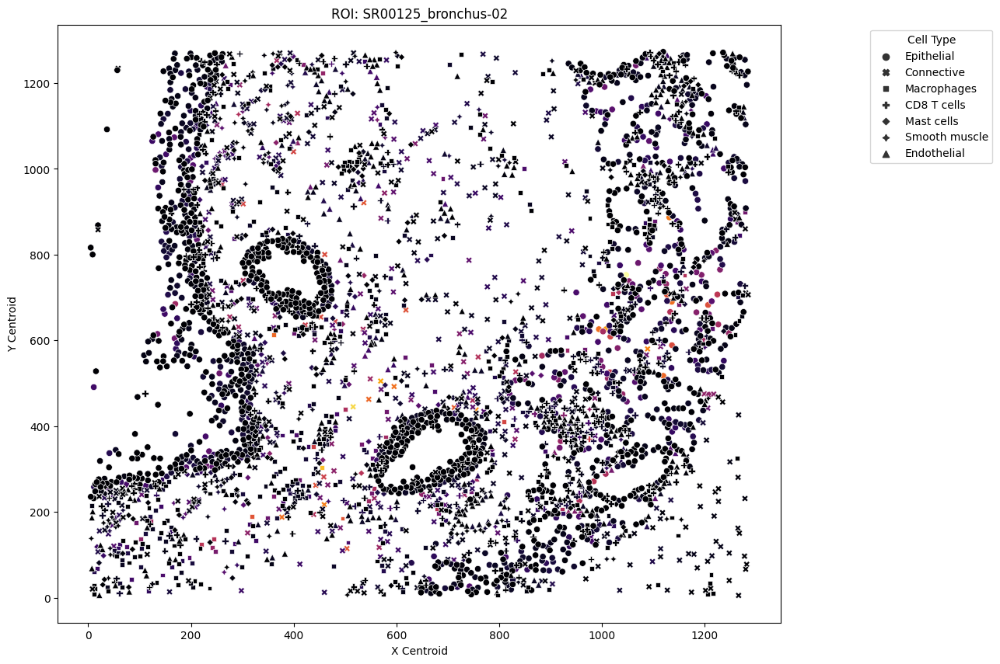

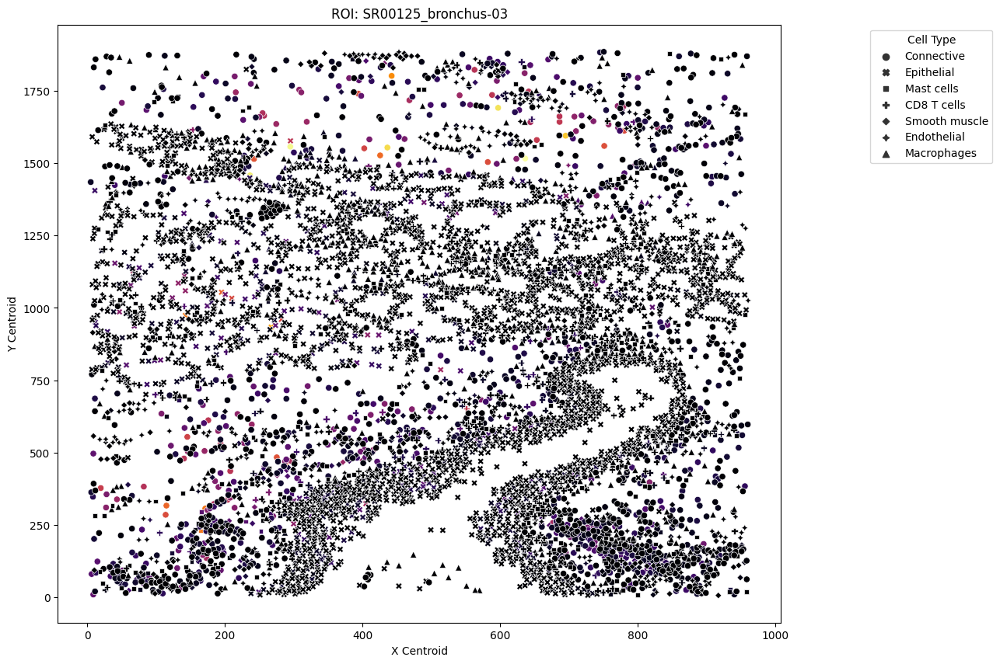

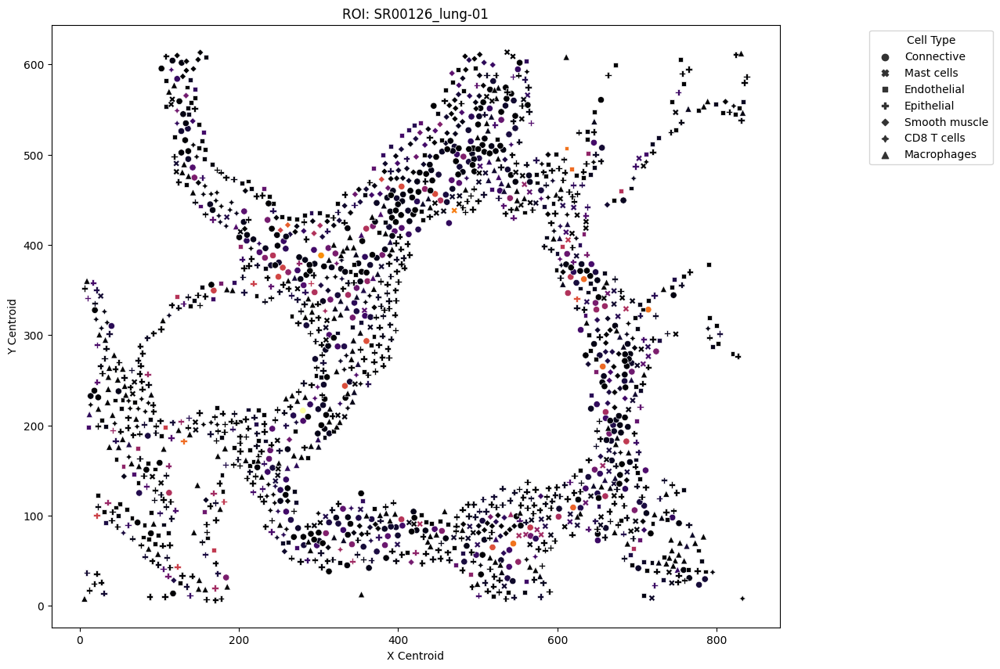

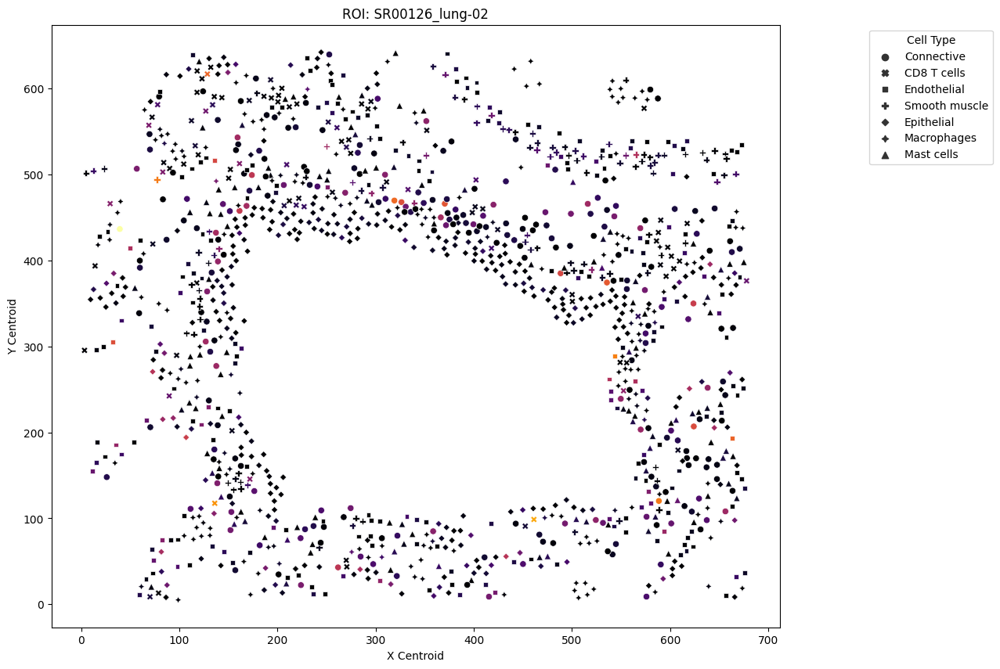

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the data from the CSV file
data_all = pd.read_csv("/content/drive/MyDrive/GIS/Healthy_Lung_Sim/combined_output.csv")

unique_rois = data_all['roi'].unique()

# Iterate through each 'roi' value
for roi in unique_rois:
    # Load data specific to the current 'roi'
    data1 = data_all[data_all['roi'] == roi]
    X = data1["X_centroid"].values
    Y = data1["Y_centroid"].values
    cell_type = data1["cell type"].values
    score = data1["score"].values

    # Get unique cell types for the current 'roi'
    unique_cell_types = set(cell_type)

    # Create a dictionary to map unique cell types to marker shapes
    marker_shapes = {cell_type: f"{cell_type}" for index, cell_type in enumerate(unique_cell_types)}

    # Map the marker shapes using a list comprehension
    mapped_marker_shapes = [marker_shapes[cell] for cell in cell_type]

    # Create a scatter plot for the current 'roi'
    plt.figure(figsize=(12, 10))
    sns.scatterplot(
        x=X,
        y=Y,
        c=score,
        style=mapped_marker_shapes,
        cmap='inferno',
        markers=True,
    )

    plt.title(f"ROI: {roi}")
    plt.legend(title='Cell Type', loc='upper right', bbox_to_anchor=(1.3, 1))
    plt.xlabel('X Centroid')
    plt.ylabel('Y Centroid')
    plt.show()


In [ ]:
print(data_all)

       cell_size   AR         Au     Aumask  Background          C     CD11c  \
0          144.0  0.0   1.916667   0.000000    0.763889   9.076389  0.000000   
1          238.0  0.0  17.676471   0.000000    1.420168  10.176471  0.000000   
2          181.0  0.0  57.022099   7.044199    1.325967   6.480663  0.000000   
3          253.0  0.0   8.442688   0.000000    1.019763   9.747036  0.000000   
4          119.0  0.0  29.478992   0.000000    1.109244   8.890756  0.000000   
...          ...  ...        ...        ...         ...        ...       ...   
69667       30.0  0.0   3.966667   0.000000   19.666667   7.633333  0.000000   
69668       65.0  0.0  39.523077   0.000000    3.384615   5.753846  0.000000   
69669       79.0  0.0  32.037975   0.000000    1.088608   6.037975  0.050633   
69670      133.0  0.0  87.842105  24.924812    2.984962   5.639098  0.000000   
69671      376.0  0.0  10.085106   0.000000    1.390957   7.430851  0.000000   

           CD14  CD20       CD3  ...  p

In [ ]:
# Directory containing the CSV files
directory = "/content/drive/MyDrive/GIS/Breast Cancer Sim_new"

# List of CSV files in the directory
csv_files = [filename for filename in os.listdir(directory) if filename.endswith("_sorted_output_sim_selected.csv")]

# Initialize an empty DataFrame to store the combined data
combined_data = pd.DataFrame()

# Loop through each CSV file and append its data to the combined_data DataFrame
for filename in csv_files:
    filepath = os.path.join(directory, filename)
    df = pd.read_csv(filepath)
    combined_data = combined_data.append(df, ignore_index=True)

# Save the combined data to a new CSV file
combined_data.to_csv("/content/drive/MyDrive/GIS/Breast Cancer Sim_new/combined_output_sim_selected_breast.csv", index=False)

print("CSV files have been successfully combined.")

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [ ]:
import pandas as pd

# Load your data into a Pandas DataFrame (replace the file path with your dataset's location)
df = pd.read_csv("/content/drive/MyDrive/GIS/Breast Cancer Diss_new/combined_output_diss_selected_breast.csv")




In [ ]:
import os

folder_path = '/content/drive/MyDrive/Colab Notebooks'  # Replace with the path to your folder

# List all files in the folder
files = os.listdir(folder_path)

# Loop through the files and delete PNG files
for file in files:
    if file.endswith(".png"):
        file_path = os.path.join(folder_path, file)
        os.remove(file_path)
        print(f"Deleted: {file_path}")

print("PNG files deleted.")


In [ ]:


# Create a histogram for the filtered data
plt.figure(figsize=(8, 6))
sns.histplot(df['score'], bins=20, kde=True)
plt.title('Distribution of Scores')
plt.xlabel('Score')
plt.ylabel('Frequency')
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
# Get the list of all columns in the DataFrame (excluding 'score')
all_columns = df.columns.tolist()
all_columns.remove('score')

# Create subplots for each column
num_columns = len(all_columns)
num_rows = num_columns // 2 + num_columns % 2  # Calculate the number of rows for subplots

plt.figure(figsize=(15, 5 * num_rows))

for i, column_name in enumerate(all_columns, start=1):
    plt.subplot(num_rows, 2, i)
    plt.scatter(df[column_name], df['score'], alpha=0.5)
    plt.title(f'{column_name} vs. Score')
    plt.xlabel(column_name)
    plt.ylabel('Score')

# Adjust spacing for the subplots
plt.tight_layout()
plt.show()

# Calculate and print correlation coefficients
correlation_scores = {}
for column_name in all_columns:
    correlation = df['score'].corr(df[column_name])
    correlation_scores[column_name] = correlation

print("Correlation coefficients:")
for column_name, correlation in correlation_scores.items():
    print(f"{column_name}: {correlation}")


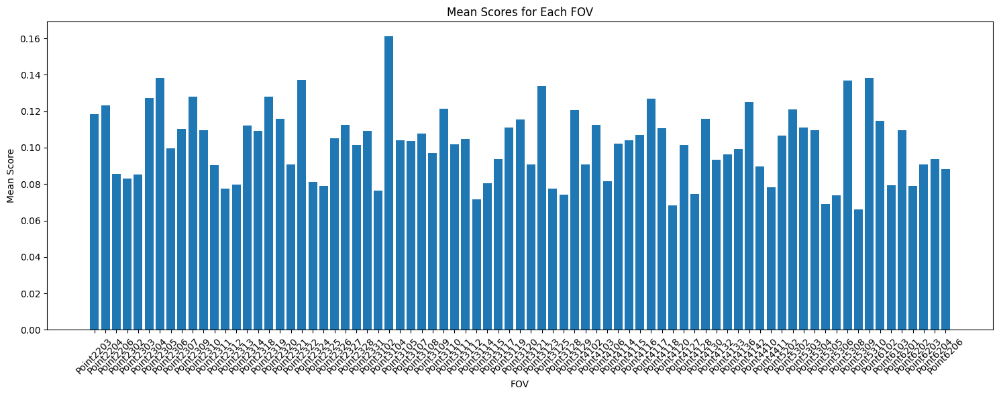

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
# Calculate mean scores for each FOV
fov_scores = df.groupby('fov')['score'].mean()

# Create a bar plot
plt.figure(figsize=(15, 6))
plt.bar(fov_scores.index, fov_scores.values)
plt.title('Mean Scores for Each FOV')
plt.xlabel('FOV')
plt.ylabel('Mean Score')

# Optionally, rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


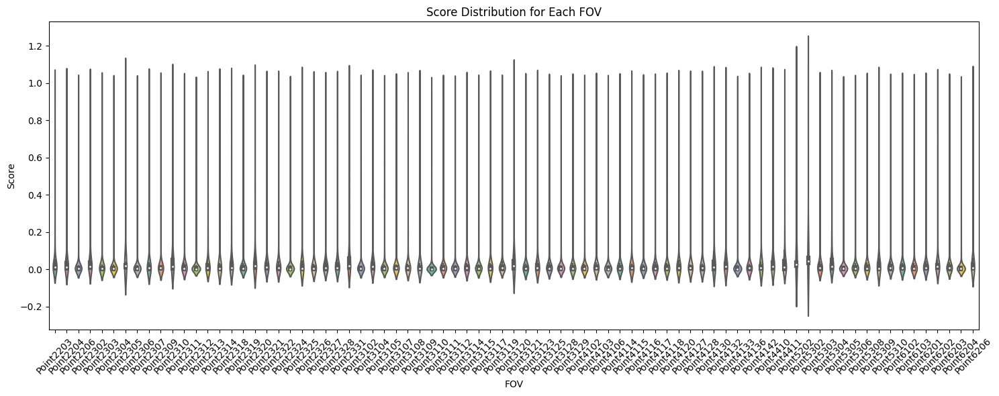

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df_filtered = df[df['score'] != 0]
# Create a violin plot
plt.figure(figsize=(15, 6))
sns.violinplot(x='fov', y='score', data=df_filtered, palette='Set2')
plt.title('Score Distribution for Each FOV')
plt.xlabel('FOV')
plt.ylabel('Score')

# Optionally, rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


In [ ]:
correlation_matrix = df.corr()

<ipython-input-9-68bbfff3c4eb>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


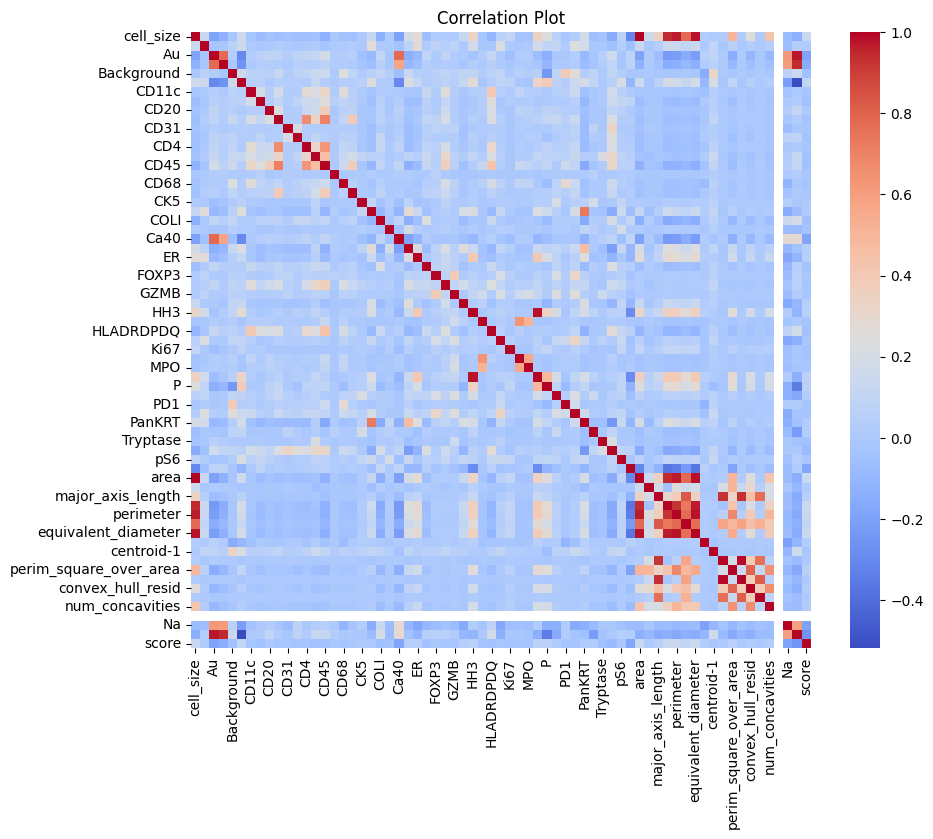

In [ ]:
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Plot")
plt.show()


In [ ]:
import os
import pandas as pd

# Directory containing the CSV files
directory = "/content/drive/MyDrive/GIS/Healthy_Lung_Sim/"

# List of CSV files in the directory
csv_files = [filename for filename in os.listdir(directory) if filename.endswith("_sorted_output.csv")]

# Initialize an empty DataFrame to store the combined data
combined_data = pd.DataFrame()

for filename in csv_files:
    filepath = os.path.join(directory, filename)
    df = pd.read_csv(filepath)

    # Filter data based on score >= 0.5
    df = df[df['score'] >= 0.5]

    combined_data = combined_data.append(df, ignore_index=True)

# Save the combined data to a new CSV file
combined_data.to_csv("/content/drive/MyDrive/GIS/Healthy_Lung_Sim/combined_output_score_above_0.5_sim.csv", index=False)

print("Data with score >= 0.5 have been successfully combined.")


<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method i

Data with score >= 0.5 have been successfully combined.


<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  combined_data = combined_data.append(df, ignore_index=True)
<ipython-input-47-4cab3972d256>:20: FutureWarning: The frame.append method i

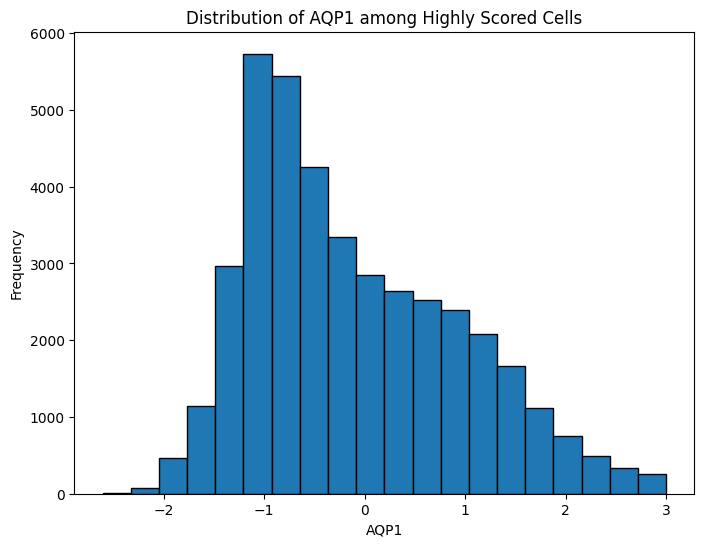

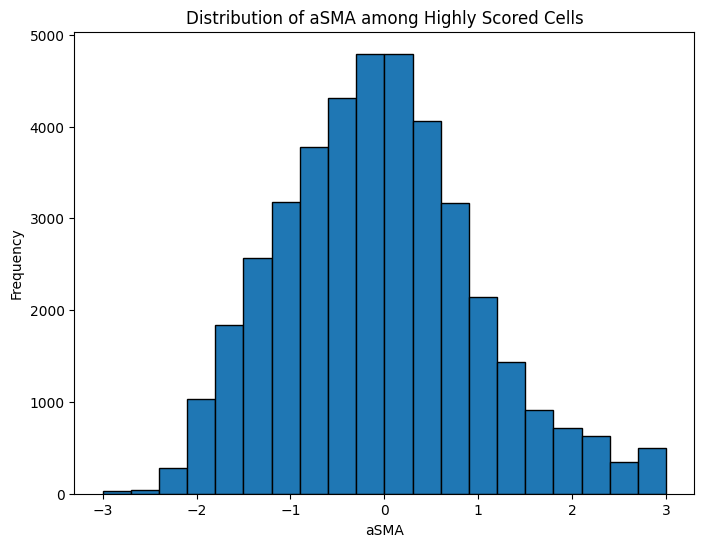

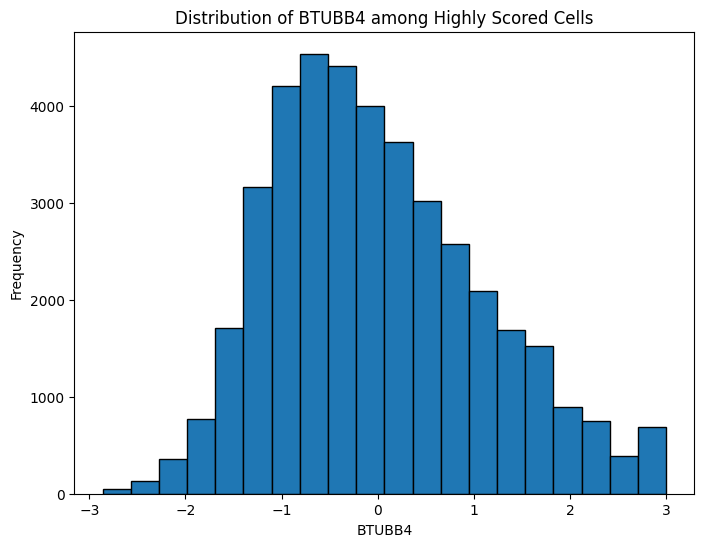

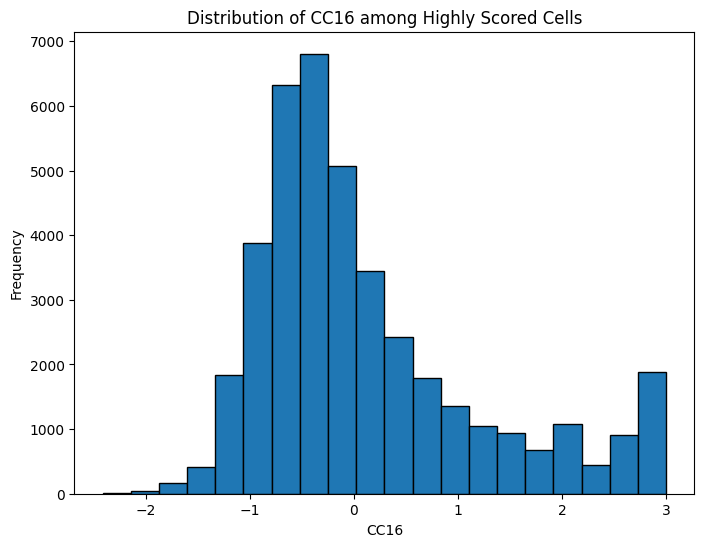

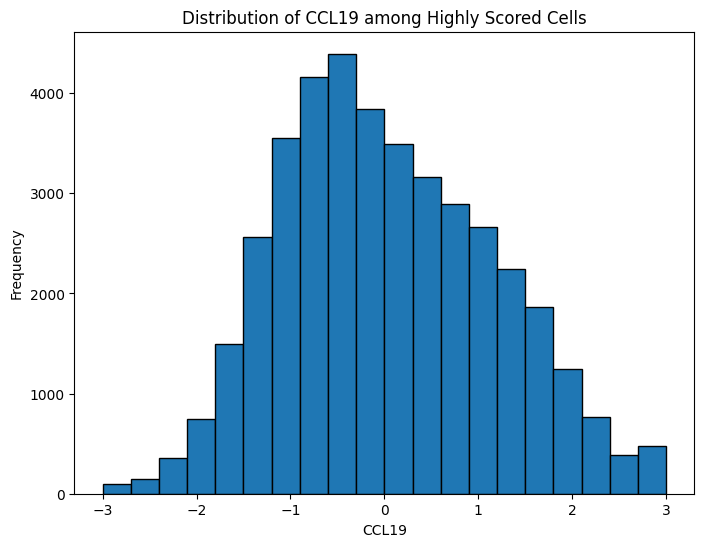

...

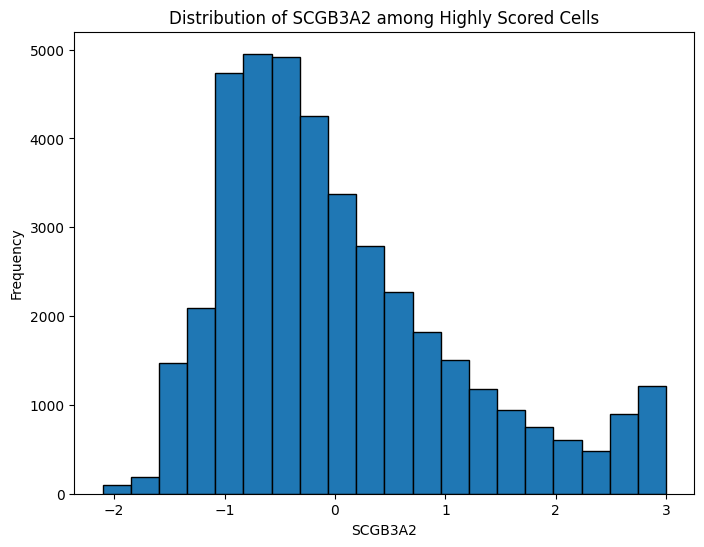

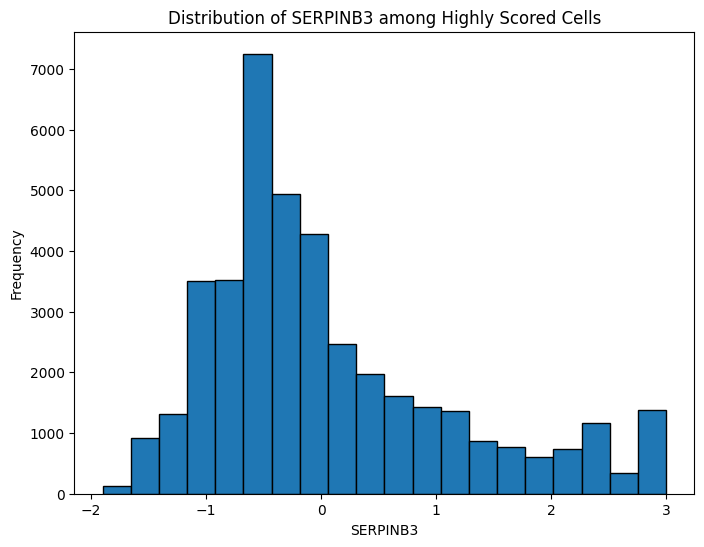

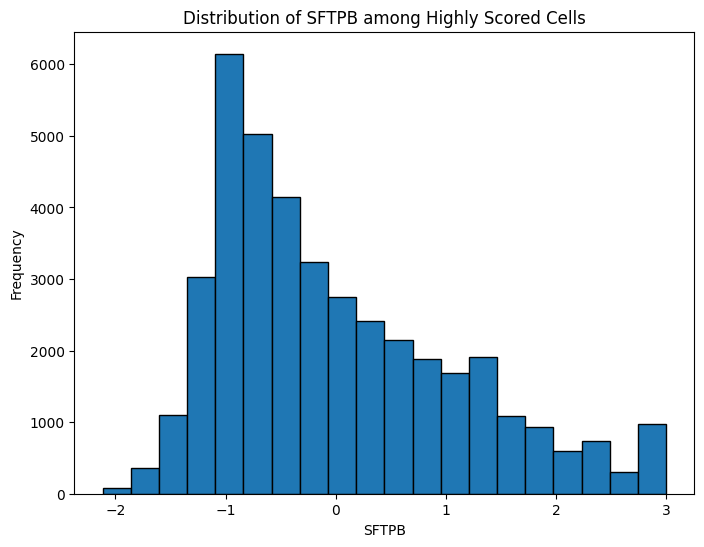

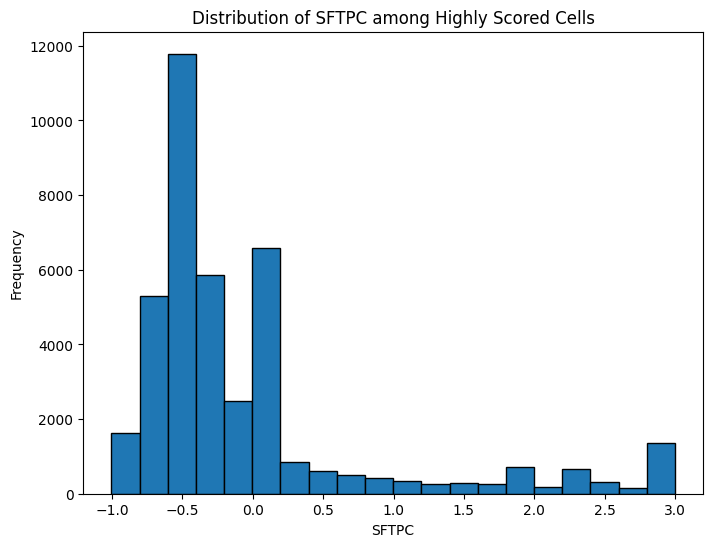

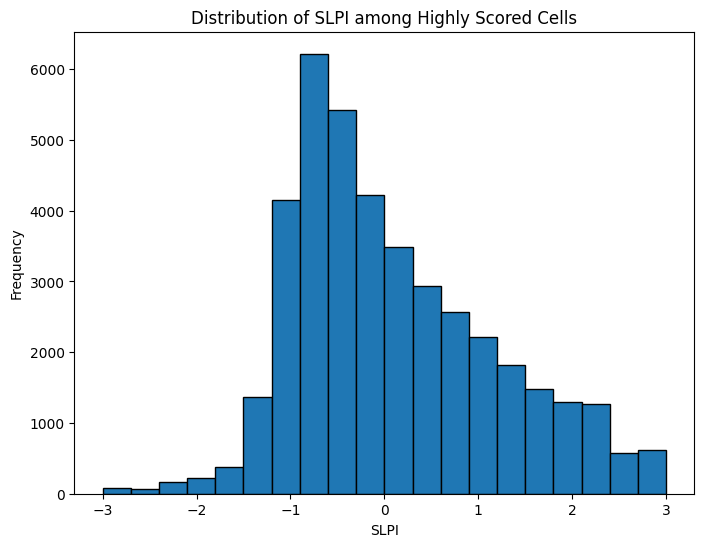

               AQP1          aSMA        BTUBB4          CC16         CCL19  \
count  40549.000000  40549.000000  40549.000000  40549.000000  40549.000000   
mean      -0.109264     -0.060313     -0.002890      0.124744      0.031586   
std        1.041997      1.044305      1.098077      1.091425      1.129447   
min       -2.608914     -3.000000     -2.862015     -2.415251     -3.000000   
25%       -0.938960     -0.804396     -0.823446     -0.617707     -0.816380   
50%       -0.353523     -0.095511     -0.157908     -0.213351     -0.092784   
75%        0.641251      0.575519      0.701750      0.561871      0.848788   
max        3.000000      3.000000      3.000000      3.000000      3.000000   

              CD163          CD31           CD4          CD68          CD8A  \
count  40549.000000  40549.000000  40549.000000  40549.000000  40549.000000   
mean      -0.008712     -0.085161      0.034865     -0.000726      0.039873   
std        0.995693      0.997182      1.059315    

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load your CSV table into a DataFrame
df = pd.read_csv("/content/drive/MyDrive/GIS/Healthy_Lung_Diss/combined_output_diss.csv")

# Select the high-score column and set a threshold
score_column = "score"  # Replace with the actual column name
score_threshold = 0  # Adjust the threshold as needed

# Filter highly scored cells
high_scored_cells = df[df[score_column] > score_threshold]

# Calculate descriptive statistics for specific columns of interest
columns_of_interest =  df.columns[1:29] # Replace with actual column names
statistics = high_scored_cells[columns_of_interest].describe()

# Visualize the distributions of specific columns
for column in columns_of_interest:
    plt.figure(figsize=(8, 6))
    plt.hist(high_scored_cells[column], bins=20, edgecolor='k')
    plt.title(f"Distribution of {column} among Highly Scored Cells")
    plt.xlabel(column)
    plt.ylabel("Frequency")
    plt.show()

# Perform hypothesis tests if needed
# For example, you can use scipy.stats functions for hypothesis testing
# (e.g., t-tests, ANOVA) to compare specific columns between groups.

# Print descriptive statistics
print(statistics)


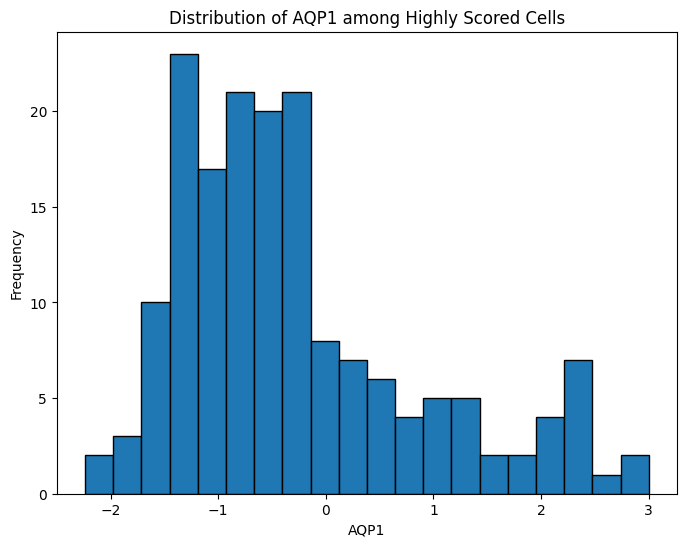

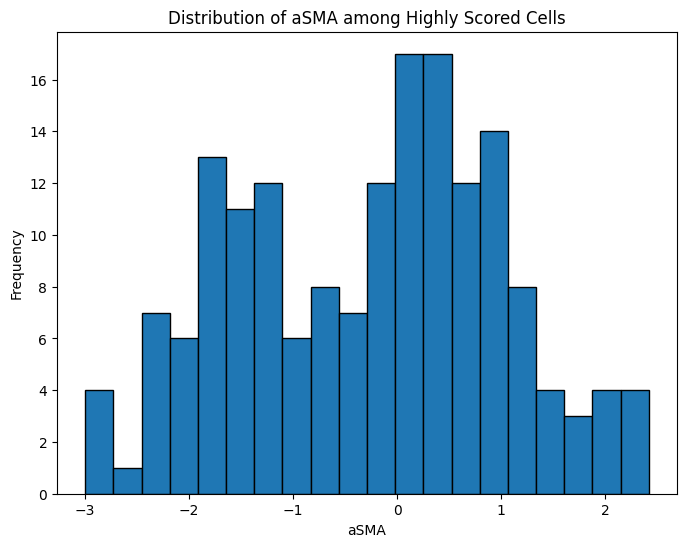

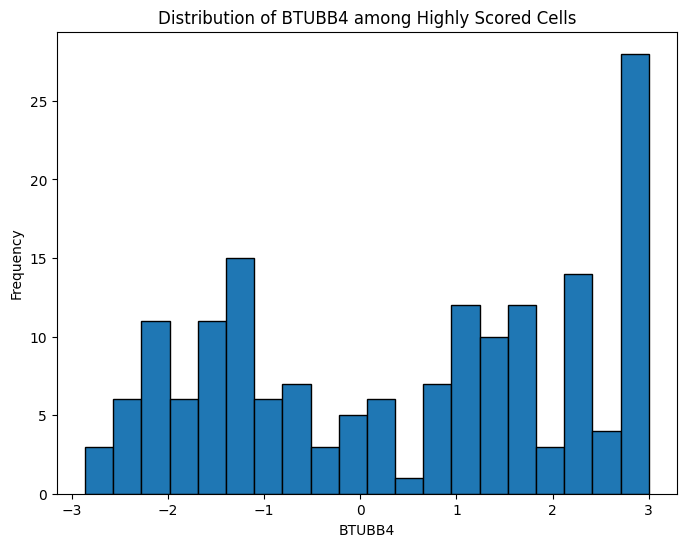

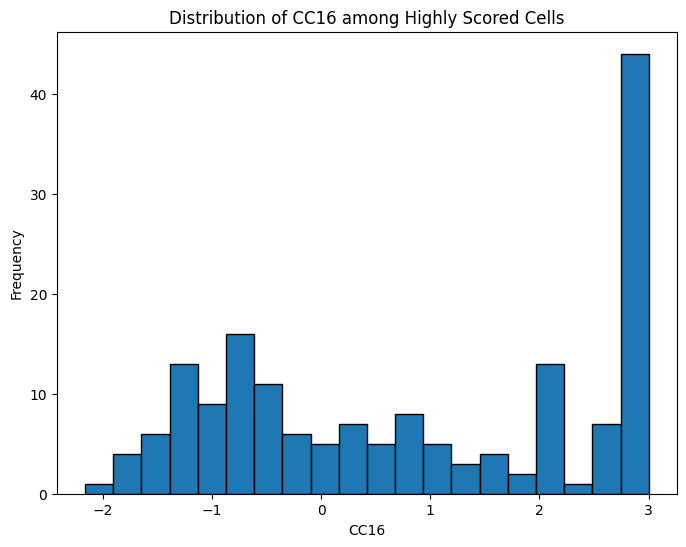

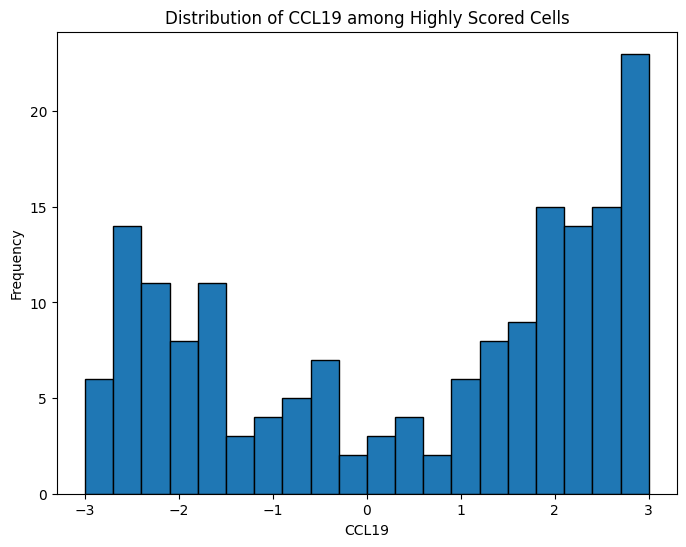

...

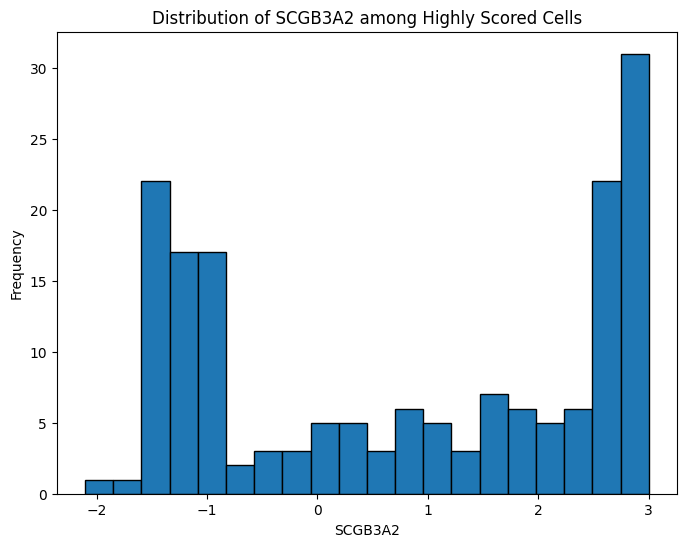

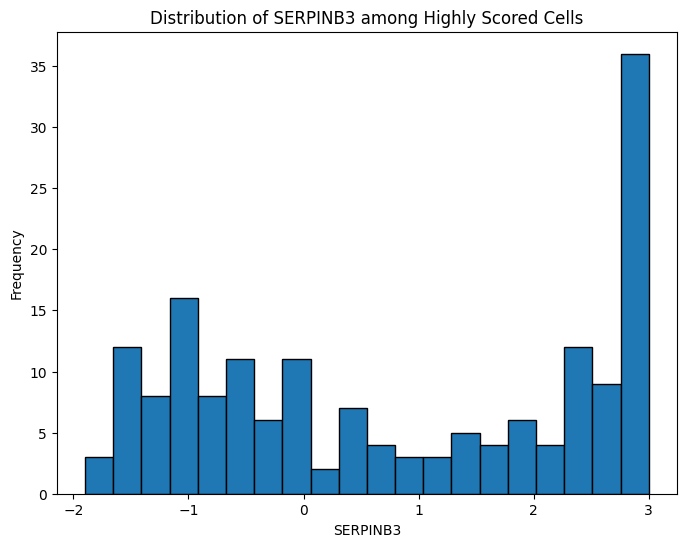

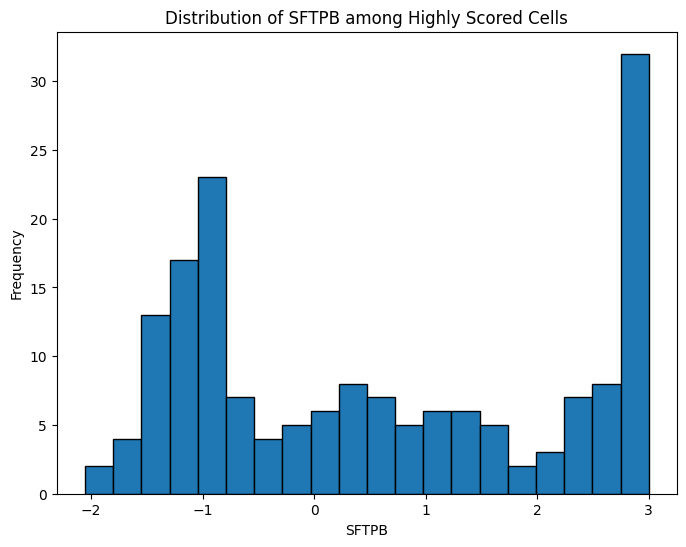

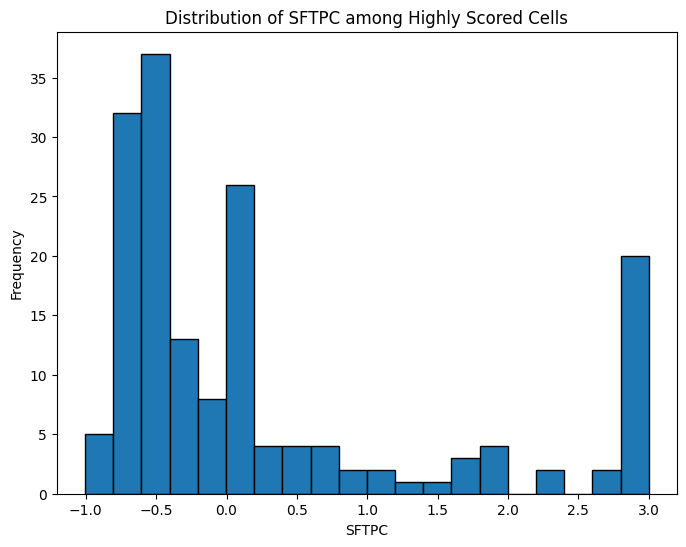

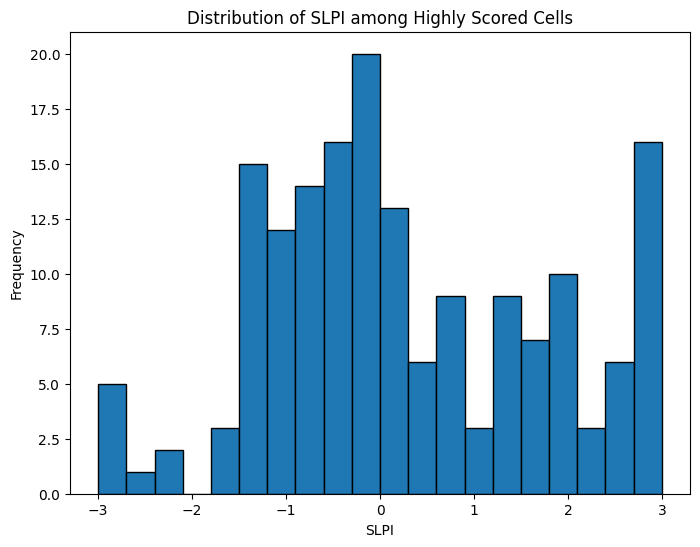

             AQP1        aSMA      BTUBB4        CC16       CCL19       CD163  \
count  170.000000  170.000000  170.000000  170.000000  170.000000  170.000000   
mean    -0.293206   -0.270104    0.481307    0.868769    0.456153    0.438004   
std      1.142408    1.281139    1.841593    1.667903    2.041258    1.447730   
min     -2.237669   -3.000000   -2.862015   -2.159904   -3.000000   -1.247296   
25%     -1.135165   -1.327833   -1.296089   -0.695290   -1.683045   -0.667740   
50%     -0.558552   -0.060617    0.878377    0.842185    1.136067   -0.327587   
75%      0.224014    0.664558    2.227266    2.779640    2.340279    1.547443   
max      3.000000    2.421372    3.000000    3.000000    3.000000    3.000000   

             CD31         CD4        CD68        CD8A  ...         KIT  \
count  170.000000  170.000000  170.000000  170.000000  ...  170.000000   
mean     0.146008    0.731812    0.350194    0.409062  ...    0.292872   
std      1.426412    1.705255    1.514793    1.2

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load your CSV table into a DataFrame
df = pd.read_csv("/content/drive/MyDrive/GIS/Healthy_Lung_Diss/combined_output_diss.csv")

# Select the high-score column and set a threshold
score_column = "score"  # Replace with the actual column name
score_threshold = 0.5  # Adjust the threshold as needed

# Filter highly scored cells
high_scored_cells = df[df[score_column] > score_threshold]

# Calculate descriptive statistics for specific columns of interest
columns_of_interest =  df.columns[1:29] # Replace with actual column names
statistics = high_scored_cells[columns_of_interest].describe()

# Visualize the distributions of specific columns
for column in columns_of_interest:
    plt.figure(figsize=(8, 6))
    plt.hist(high_scored_cells[column], bins=20, edgecolor='k')
    plt.title(f"Distribution of {column} among Highly Scored Cells")
    plt.xlabel(column)
    plt.ylabel("Frequency")
    plt.show()

# Perform hypothesis tests if needed
# For example, you can use scipy.stats functions for hypothesis testing
# (e.g., t-tests, ANOVA) to compare specific columns between groups.

# Print descriptive statistics
print(statistics)


In [ ]:
import pandas as pd
from scipy import stats

# Load your data into a DataFrame
df = pd.read_csv("/content/drive/MyDrive/GIS/Healthy_Lung_Diss/combined_output_diss.csv")

# Define the condition to split your data into two groups
score_threshold = 0.5  # Adjust as needed
group1 = df[df['score'] >= score_threshold]
group2 = df[df['score'] < score_threshold]
# Perform the independent t-test
t_statistic, p_value = stats.ttest_ind(group1['column_of_interest'], group2['column_of_interest'])



import pandas as pd
from scipy import stats

# Load your data into a DataFrame
df = pd.read_csv("your_data.csv")

# Define the condition to split your data into two groups
score_threshold = 0.5  # Adjust as needed
group1 = df[df['score'] >= score_threshold]
group2 = df[df['score'] < score_threshold]

# Perform the independent t-test on a specific column
t_statistic, p_value = stats.ttest_ind(group1['column_of_interest'], group2['column_of_interest'])

# Choose a significance level (alpha)
alpha = 0.05

# Interpret the results
if p_value <= alpha:
    print(f"Reject the null hypothesis. There is a statistically significant difference.")
else:
    print(f"Fail to reject the null hypothesis. There is no statistically significant difference.")





KeyError: ignored

In [ ]:
import pandas as pd

# Read the CSV file into a DataFrame
csv_data = pd.read_csv('/content/drive/MyDrive/GIS/Breast Cancer Diss_new/final_threshold_diss_selected.csv')

# Create a list of lists in the desired format
fov_data = csv_data[['roi', 'percentile_value_75']].values.tolist()

for i in fov_data:
    print(f"'{i[0]}', {i[1]};")

print(len(fov_data))

'Point2203', 39.54395580291748;
'Point2204', 34.121395111083984;
'Point2206', 11.37967014312744;
'Point2302', 46.16133785247803;
'Point2303', 28.22241973876953;
'Point2304', 18.105947971343998;
'Point2305', 20.576375007629395;
'Point2306', 21.775394439697266;
'Point2307', 26.584300994873047;
'Point2309', 26.11988401412964;
'Point2310', 18.62300109863281;
'Point2311', 32.457502365112305;
'Point2312', 39.99063873291016;
'Point2313', 18.73137283325196;
'Point2314', 24.9635910987854;
'Point2318', 30.00485134124756;
'Point2319', 39.214131355285645;
'Point2320', 38.27438926696777;
'Point2321', 40.82366943359375;
'Point2322', 28.18340301513672;
'Point2324', 34.65310287475586;
'Point2325', 19.619633674621586;
'Point2326', 42.54450607299805;
'Point2327', 17.171542167663574;
'Point2328', 36.07174301147461;
'Point2331', 22.781991958618164;
'Point3102', 8.367494583129883;
'Point3104', 37.34214401245117;
'Point3105', 35.50214672088623;
'Point3107', 27.569840908050537;
'Point3108', 22.78342247009277